In [2]:
!pip install geopandas
!pip install folium --upgrade
!pip install geopy
!pip install pycountry
import geopy
import pycountry
import folium
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
import seaborn as sns
import textwrap
import math

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 45.8 MB/s eta 0:00:00


# Data Preprocessing

In [3]:
!gdown 1oO3vVtghN4vr2w9-UD9Re9HF7mHXPMj-
# https://drive.google.com/file/d/1oO3vVtghN4vr2w9-UD9Re9HF7mHXPMj-/view?usp=sharing

Downloading...
From: https://drive.google.com/uc?id=1oO3vVtghN4vr2w9-UD9Re9HF7mHXPMj-
To: /content/COVIDiSTRESS_May_30_cleaned_final.csv
100% 90.3M/90.3M [00:00<00:00, 171MB/s]


In [4]:
df = pd.read_csv('/content/COVIDiSTRESS_May_30_cleaned_final.csv', encoding='latin-1') # Try reading the file with 'latin-1' encoding. If this doesn't work, try other encodings like 'ISO-8859-1'.

<ipython-input-4-7f8b7d6c3847>:1: DtypeWarning: Columns (55,56,57,58,59,60,61) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/content/COVIDiSTRESS_May_30_cleaned_final.csv', encoding='latin-1') # Try reading the file with 'latin-1' encoding. If this doesn't work, try other encodings like 'ISO-8859-1'.


In [5]:
unique_values = df['Country'].unique()
print(f"Unique values in {'Country'}:", unique_values)

Unique values in Country: ['Argentina' 'Pakistan' 'Bulgaria' 'Italy' 'Panama' 'Mexico' 'France'
 'Romania' 'United States' 'Finland' 'Russia' nan 'United Kingdom'
 'Bosnia and Herzegovina' 'Denmark' 'China' 'South Africa'
 'United Arab Emirates' 'Germany' 'Sweden' 'Philippines' 'Australia'
 'Korea, South' 'Turkey' 'Estonia' 'Lithuania' 'Norway' 'Brazil' 'Hungary'
 'Spain' 'Ecuador' 'Morocco' 'Malaysia' 'Micronesia, Federated States of'
 'Netherlands' 'Ireland' 'Austria' 'Bahrain' 'Guatemala' 'India'
 'Slovakia' 'Portugal' 'Belgium' 'Croatia' 'Serbia' 'Colombia'
 'Switzerland' 'Chile' 'Ukraine' 'Poland' 'Cuba' 'Czech Republic' 'Israel'
 'Indonesia' 'Kosovo' 'Tunisia' 'Vietnam' 'Peru' 'Greece' 'Qatar' 'Egypt'
 'Turkmenistan' 'Lebanon' 'Slovenia' 'Kazakhstan' 'Canada' 'Angola'
 'Azerbaijan' 'other' 'Taiwan' 'Mauritania' 'The Bahamas' 'Japan'
 'Venezuela' 'El Salvador' 'Afghanistan' 'Andorra' 'Costa Rica'
 'Bangladesh' 'Honduras' 'Algeria' 'Mauritius' 'Senegal' 'Cameroon'
 'New Zealand' 'L

In [6]:
southeastAsia = ['Philippines','Malaysia', 'Indonesia', 'Vietnam', 'Singapore', 'Thailand', 'Myanmar (Burma)', 'Brunei', 'Cambodia', 'Laos']

southeastAsia_df = df[df['Country'].isin(southeastAsia)]

In [7]:
southeastAsia_df['Country'].replace('Brunei', 'Brunei Darussalam', inplace=True)
southeastAsia_df['Country'].replace('Myanmar (Burma)', 'Myanmar', inplace=True)
southeastAsia_df['Country'].replace('Vietnam', 'Viet Nam', inplace=True)
southeastAsia_df['Country'].replace('Laos', "Lao People's Democratic Republic", inplace=True)

<ipython-input-7-0f1955916d2a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  southeastAsia_df['Country'].replace('Brunei', 'Brunei Darussalam', inplace=True)
<ipython-input-7-0f1955916d2a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  southeastAsia_df['Country'].replace('Myanmar (Burma)', 'Myanmar', inplace=True)
<ipython-input-7-0f1955916d2a>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  southeastAsia_df['Country'].replace('V

In [8]:
# Make new df only for general demographic data
Dem_col = ['Dem_age', 'Dem_gender', 'Dem_edu', 'Dem_edu_mom', 'Dem_employment', 'Country', 'Dem_Expat', 'Dem_state', 'Dem_isolation_kids', 'Dem_isolation_adults', 'Dem_isolation', 'Dem_riskgroup', 'Dem_dependents', 'Dem_maritalstatus']
Dem_df = southeastAsia_df[Dem_col]

# Remove demographic data and unnecessary data
stress_df = southeastAsia_df.drop(Dem_col, axis=1)
stress_df.drop(['ID', 'UserLanguage', 'AD_gain', 'AD_loss', 'AD_check','answered_all','RecordedDate','Duration..in.seconds.', 'con', 'agr', 'ope', 'ext', 'neu', 'experience_war_TXT', 'experience_war', 'born_92', 'time_spent_in_war', 'time_spent_in_war_TXT', 'loss_during_war', 'war_injury'], axis=1, inplace=True)

#  Make new df only for open ended questions
open_col = ['Final_open', 'Expl_coping_txt', 'Expl_Distress_txt']
openQues_df = stress_df[open_col]

# Drop the open txt data
stress_df.drop(open_col, axis=1, inplace=True)
# Remove questions that did not appear in respondents in Southeast Asian countries
stress_df.drop(['Scale_UCLA_TRI_1', 'Scale_UCLA_TRI_2', 'Scale_UCLA_TRI_3', 'Scale_UCLA_TRI_4', 'PS_PTSD_1', 'PS_PTSD_2', 'PS_PTSD_3','PS_PTSD_4', 'PS_PTSD_5'], axis = 1, inplace= True)

# Make new df only for mean score
avg_score = ['PSS10_avg', 'SLON3_avg', 'SPS_avg']
avg_df = stress_df[avg_score]

# Drop mean score
stress_df.drop(avg_score, axis=1, inplace=True)
# Drop mean score that didn't appear
stress_df.drop(['Scale_UCLA_TRI_avg'], axis = 1, inplace = True)

In [9]:
# Show percentage missing value
missing_values = Dem_df.isnull().sum()
missing_percentage = (Dem_df.isnull().sum() / len(Dem_df)) * 100

missing_info = pd.DataFrame({
    'Missing Values': missing_values,
    'Percentage': missing_percentage
})

pd.set_option('display.max_rows', None)
print(missing_info)

                      Missing Values  Percentage
Dem_age                            0    0.000000
Dem_gender                        11    0.373008
Dem_edu                            9    0.305188
Dem_edu_mom                      124    4.204815
Dem_employment                    31    1.051204
Country                            0    0.000000
Dem_Expat                         17    0.576467
Dem_state                        263    8.918277
Dem_isolation_kids               690   23.397762
Dem_isolation_adults             657   22.278739
Dem_isolation                     19    0.644286
Dem_riskgroup                     15    0.508647
Dem_dependents                   124    4.204815
Dem_maritalstatus                 28    0.949474


In [10]:
# Show percentage missing value
missing_values = stress_df.isnull().sum()
missing_percentage = (stress_df.isnull().sum() / len(stress_df)) * 100

missing_info = pd.DataFrame({
    'Missing Values': missing_values,
    'Percentage': missing_percentage
})

pd.set_option('display.max_rows', None)
print(missing_info)

                      Missing Values  Percentage
Scale_PSS10_UCLA_1               310   10.512038
Scale_PSS10_UCLA_2               316   10.715497
Scale_PSS10_UCLA_3               315   10.681587
Scale_PSS10_UCLA_4               312   10.579858
Scale_PSS10_UCLA_5               315   10.681587
Scale_PSS10_UCLA_6               311   10.545948
Scale_PSS10_UCLA_7               314   10.647677
Scale_PSS10_UCLA_8               319   10.817226
Scale_PSS10_UCLA_9               309   10.478128
Scale_PSS10_UCLA_10              310   10.512038
Scale_SLON_1                     311   10.545948
Scale_SLON_2                     309   10.478128
Scale_SLON_3                     316   10.715497
OECD_people_1                    451   15.293320
OECD_people_2                    442   14.988132
OECD_insititutions_1             494   16.751441
OECD_insititutions_2             479   16.242794
OECD_insititutions_3             476   16.141065
OECD_insititutions_4             473   16.039335
OECD_insititutions_5

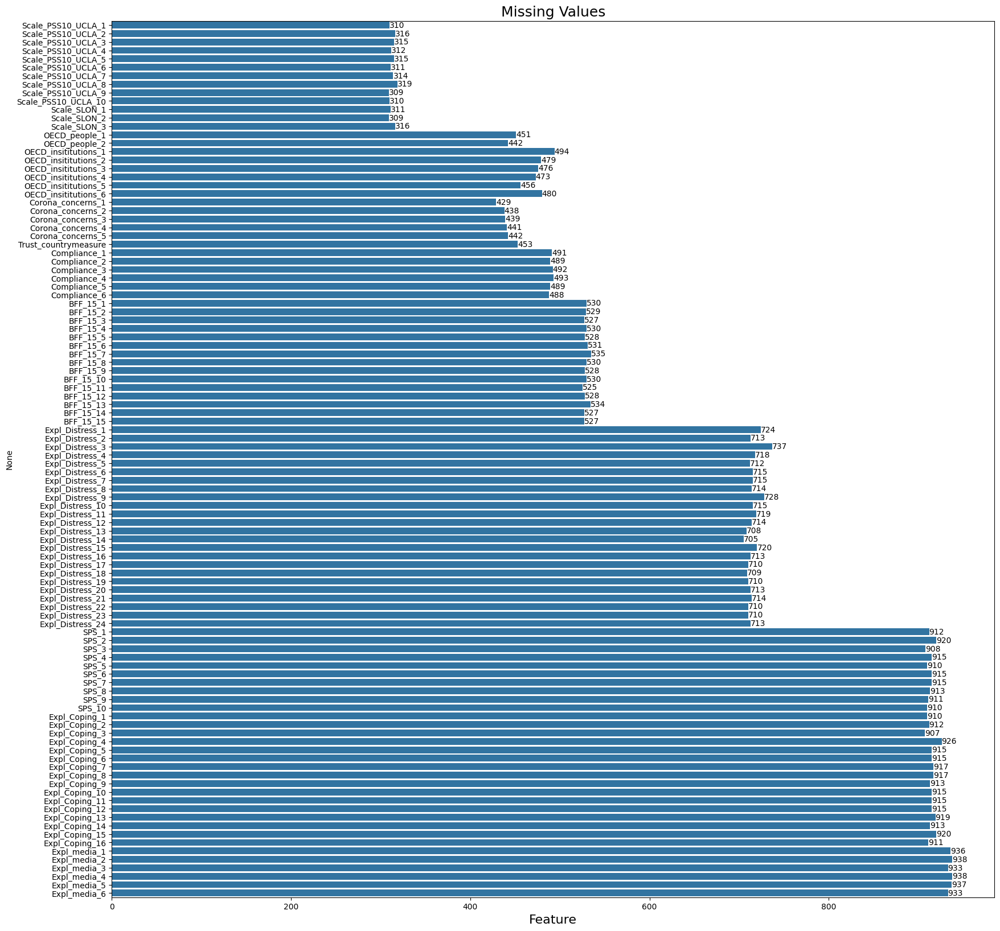

In [11]:
# Visualize the Missing value
missing_value = pd.DataFrame(stress_df.isnull().sum())
missing_value = missing_value.rename(columns = {0 : 'Missing Values Sum'})

fig, ax = plt.subplots(figsize=(20,20), dpi=100)
sns.barplot(missing_value, y=missing_value.index, x='Missing Values Sum')

plt.title('Missing Values', fontsize=18)
plt.xlabel('Feature', fontsize=16)
ax.bar_label(ax.containers[0])
plt.show()

In [12]:
# Fill NaN with the mode of each column
stress_df = stress_df.fillna(stress_df.mode().iloc[0])

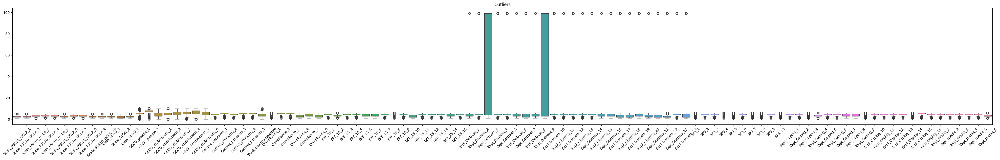

In [13]:
# Outliers
num_col = stress_df.select_dtypes(include=['number'])
plt.figure(figsize=(50, 6))
sns.boxplot(data = num_col)
plt.title('Outliers')
plt.xticks(rotation = 45)
plt.show()

In [14]:
column = ['Scale_PSS10_UCLA_1','Scale_SLON_1', 'OECD_people_1', 'OECD_insititutions_1', 'Corona_concerns_1', 'Trust_countrymeasure', 'Compliance_1', 'BFF_15_1', 'Expl_Distress_2','Expl_Distress_8', 'SPS_1', 'Expl_Coping_1', 'Expl_media_1']
unique_values = {}
for col in column:
    unique_values[col] = stress_df[col].unique()

for col, values in unique_values.items():
    print(f"Unique values in {col}: {values}")

Unique values in Scale_PSS10_UCLA_1: [2. 3. 4. 1. 5.]
Unique values in Scale_SLON_1: [2. 3. 4. 1. 5.]
Unique values in OECD_people_1: [ 7.  5.  2.  3.  8.  6.  4.  9.  0. 10.  1.]
Unique values in OECD_insititutions_1: [ 6.  5.  1.  9.  7.  8.  0.  3. 10.  2.  4.]
Unique values in Corona_concerns_1: [6. 5. 3. 4. 2. 1.]
Unique values in Trust_countrymeasure: [ 4.  5.  8.  2.  1.  7.  6.  0.  3. 10.  9.]
Unique values in Compliance_1: [5. 6. 3. 4. 2. 1.]
Unique values in BFF_15_1: [5. 4. 3. 2. 6. 1.]
Unique values in Expl_Distress_2: [ 5.  3. 99.  1.  2.  4.  6.]
Unique values in Expl_Distress_8: [ 5.  2.  4.  1.  3.  6. 99.]
Unique values in SPS_1: [5. 4. 3. 6. 1. 2.]
Unique values in Expl_Coping_1: [5. 6. 4. 2. 3. 1.]
Unique values in Expl_media_1: [5. 2. 6. 4. 3. 1.]


In [15]:
stress_df[['Expl_Distress_1','Expl_Distress_2','Expl_Distress_3','Expl_Distress_4','Expl_Distress_5','Expl_Distress_6','Expl_Distress_7','Expl_Distress_8', 'Expl_Distress_9', 'Expl_Distress_10', 'Expl_Distress_11', 'Expl_Distress_12', 'Expl_Distress_13', 'Expl_Distress_14', 'Expl_Distress_15', 'Expl_Distress_16', 'Expl_Distress_17', 'Expl_Distress_18', 'Expl_Distress_19', 'Expl_Distress_20', 'Expl_Distress_21', 'Expl_Distress_22', 'Expl_Distress_23', 'Expl_Distress_24']] = stress_df[['Expl_Distress_1','Expl_Distress_2','Expl_Distress_3','Expl_Distress_4','Expl_Distress_5','Expl_Distress_6','Expl_Distress_7','Expl_Distress_8', 'Expl_Distress_9', 'Expl_Distress_10', 'Expl_Distress_11', 'Expl_Distress_12', 'Expl_Distress_13', 'Expl_Distress_14', 'Expl_Distress_15', 'Expl_Distress_16', 'Expl_Distress_17', 'Expl_Distress_18', 'Expl_Distress_19', 'Expl_Distress_20', 'Expl_Distress_21', 'Expl_Distress_22', 'Expl_Distress_23', 'Expl_Distress_24']].replace(99, 7)

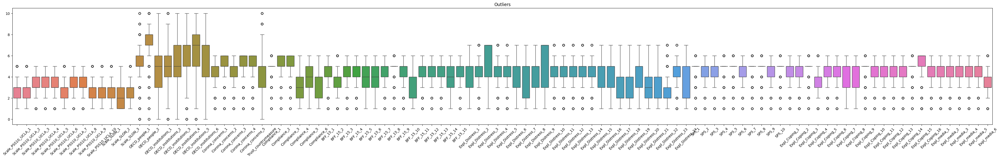

In [16]:
# Outliers
num_col = stress_df.select_dtypes(include=['number'])
plt.figure(figsize=(50, 6))
sns.boxplot(data = num_col)
plt.title('Outliers')
plt.xticks(rotation = 45)
plt.show()

# General Demographic Data

In [17]:
Dem_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2949 entries, 147 to 118882
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Dem_age               2949 non-null   int64  
 1   Dem_gender            2938 non-null   object 
 2   Dem_edu               2940 non-null   object 
 3   Dem_edu_mom           2825 non-null   object 
 4   Dem_employment        2918 non-null   object 
 5   Country               2949 non-null   object 
 6   Dem_Expat             2932 non-null   object 
 7   Dem_state             2686 non-null   object 
 8   Dem_isolation_kids    2259 non-null   float64
 9   Dem_isolation_adults  2292 non-null   float64
 10  Dem_isolation         2930 non-null   object 
 11  Dem_riskgroup         2934 non-null   object 
 12  Dem_dependents        2825 non-null   float64
 13  Dem_maritalstatus     2921 non-null   object 
dtypes: float64(3), int64(1), object(10)
memory usage: 345.6+ KB


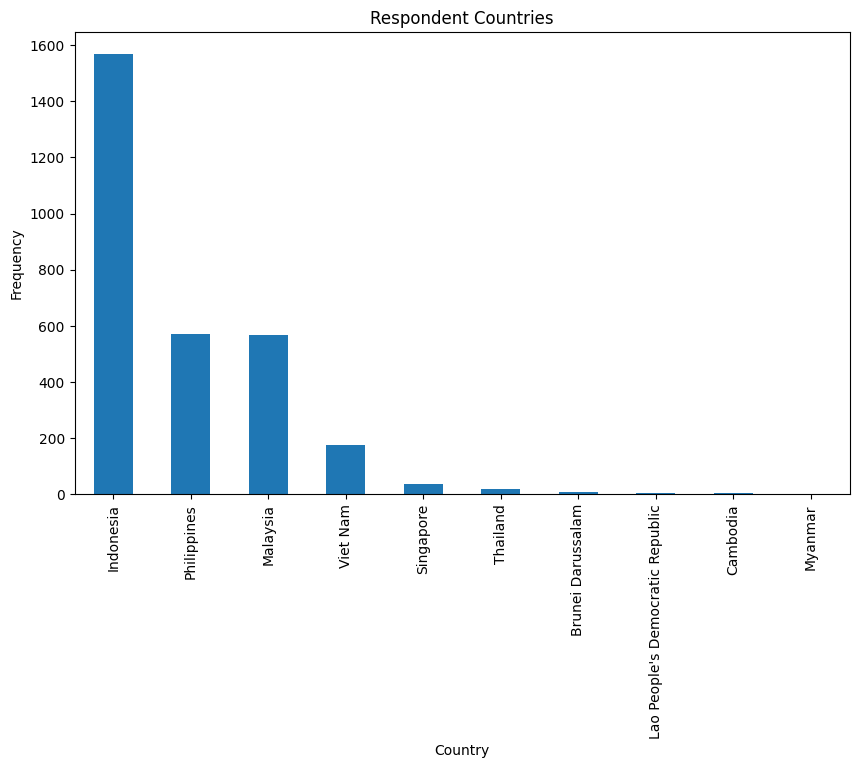

,count
Country,
Indonesia,1569
Philippines,570
Malaysia,567
Viet Nam,173
Singapore,34
Thailand,19
Brunei Darussalam,8
Lao People's Democratic Republic,5
Cambodia,3


In [18]:
country = Dem_df['Country'].value_counts()

plt.figure(figsize=(10, 6))
country.plot(kind = 'bar')

plt.xlabel('Country')
plt.ylabel('Frequency')
plt.title('Respondent Countries')
plt.show()

country_count = country.to_frame()
country_count.style.background_gradient(cmap='Blues')

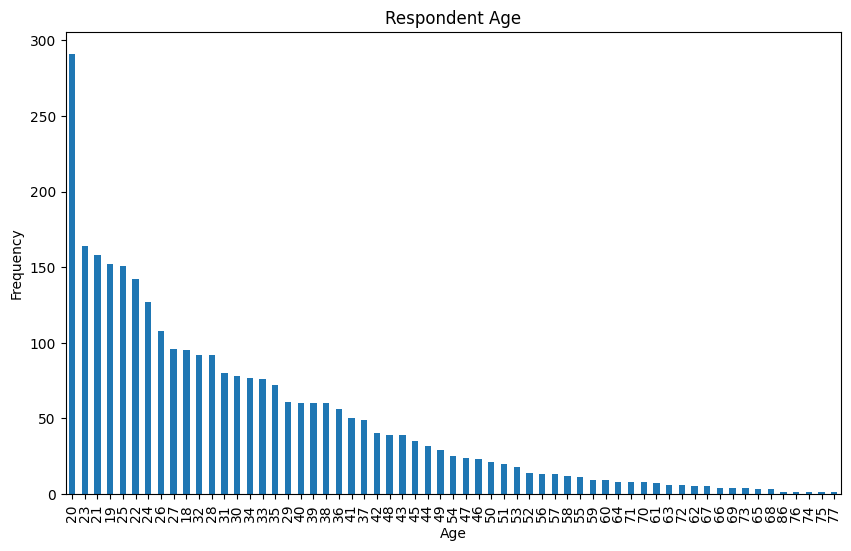

,count
Dem_age,
20,291
23,164
21,158
19,152
25,151
22,142
24,127
26,108
27,96


In [19]:
Age = Dem_df['Dem_age'].value_counts()

plt.figure(figsize=(10, 6))
Age.plot(kind = 'bar')

plt.xlabel('Age')
plt.ylabel('Frequency')
plt.title('Respondent Age')
plt.show()

age_count = Age.nlargest(10).to_frame()
age_count.style.background_gradient(cmap='Blues')

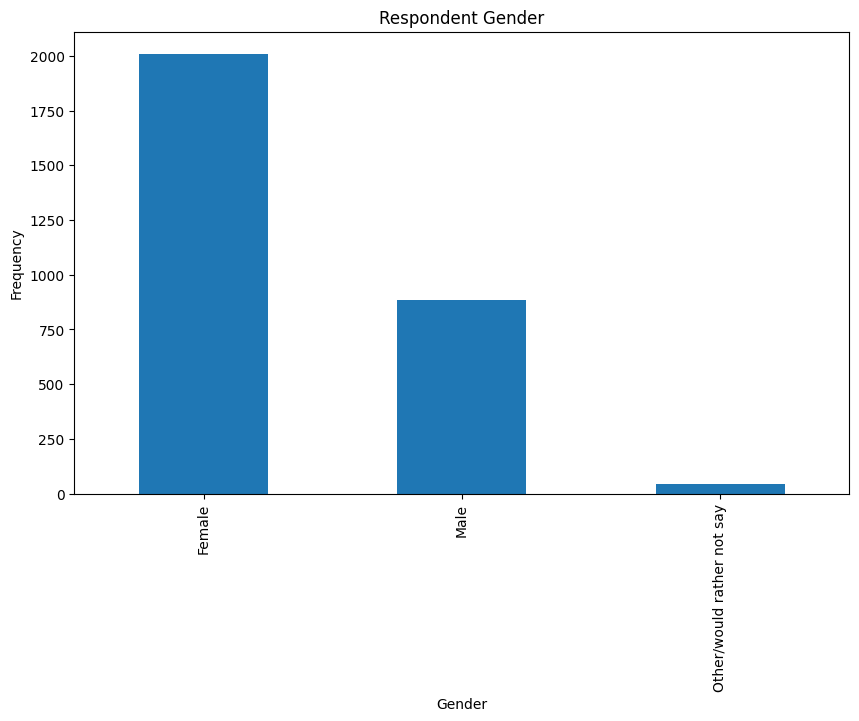

In [20]:
Gender = Dem_df['Dem_gender'].value_counts()

plt.figure(figsize=(10, 6))
Gender.plot(kind = 'bar')

plt.xlabel('Gender')
plt.ylabel('Frequency')
plt.title('Respondent Gender')
plt.show()

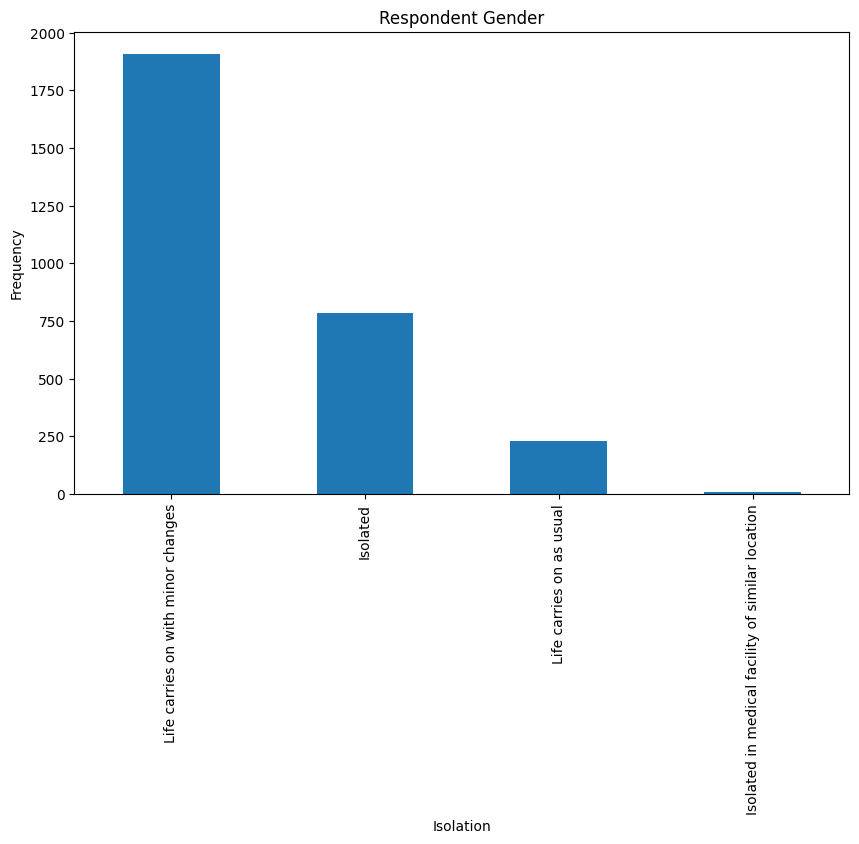

In [21]:
isolation = Dem_df['Dem_isolation'].value_counts()

plt.figure(figsize=(10, 6))
isolation.plot(kind = 'bar')

plt.xlabel('Isolation')
plt.ylabel('Frequency')
plt.title('Respondent Gender')
plt.show()

# PSS10 UCLA

In [22]:
PSS10 = stress_df[['Scale_PSS10_UCLA_1', 'Scale_PSS10_UCLA_2', 'Scale_PSS10_UCLA_3', 'Scale_PSS10_UCLA_4', 'Scale_PSS10_UCLA_5', 'Scale_PSS10_UCLA_6', 'Scale_PSS10_UCLA_7', 'Scale_PSS10_UCLA_8', 'Scale_PSS10_UCLA_9', 'Scale_PSS10_UCLA_10']]

In [23]:
PSS10[['Scale_PSS10_UCLA_4', 'Scale_PSS10_UCLA_5', 'Scale_PSS10_UCLA_7', 'Scale_PSS10_UCLA_8']].replace(1,5)
PSS10[['Scale_PSS10_UCLA_4', 'Scale_PSS10_UCLA_5', 'Scale_PSS10_UCLA_7', 'Scale_PSS10_UCLA_8']].replace(2,4)

,Scale_PSS10_UCLA_4,Scale_PSS10_UCLA_5,Scale_PSS10_UCLA_7,Scale_PSS10_UCLA_8
147,4.0,4.0,3.0,3.0
522,4.0,3.0,3.0,3.0
1475,3.0,4.0,3.0,5.0
1544,4.0,4.0,3.0,3.0
1630,4.0,3.0,3.0,4.0
1820,4.0,4.0,4.0,4.0
1823,4.0,4.0,4.0,3.0
1875,3.0,3.0,3.0,4.0
1899,5.0,5.0,5.0,5.0
2020,4.0,3.0,4.0,3.0


In [24]:
PSS10.describe()

,Scale_PSS10_UCLA_1,Scale_PSS10_UCLA_2,Scale_PSS10_UCLA_3,Scale_PSS10_UCLA_4,Scale_PSS10_UCLA_5,Scale_PSS10_UCLA_6,Scale_PSS10_UCLA_7,Scale_PSS10_UCLA_8,Scale_PSS10_UCLA_9,Scale_PSS10_UCLA_10
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,2.949813,2.834181,3.115293,3.661580,3.066463,2.913869,3.424890,3.188538,2.854866,2.721261
std,0.951428,0.981842,0.981304,0.858404,0.835722,0.973203,0.828719,0.885809,0.982528,0.978548
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,3.000000,3.000000,2.000000,2.000000
50%,3.000000,3.000000,3.000000,4.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
75%,3.000000,3.000000,4.000000,4.000000,4.000000,3.000000,4.000000,4.000000,3.000000,3.000000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


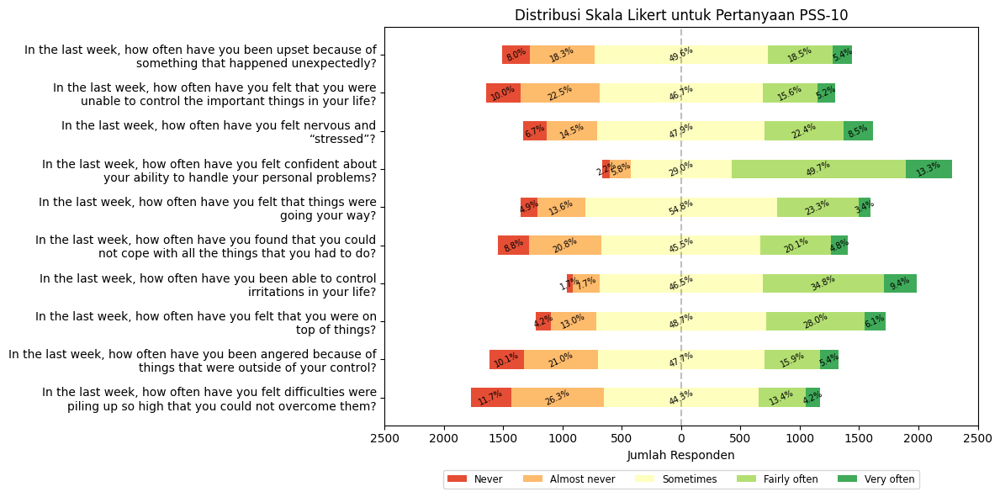

In [25]:
likert_counts = PSS10.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]


def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = data.shape[1] // 2
    offsets = data[:, :middle_index].sum(axis=1) + data[:, middle_index] / 2


    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=25)
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-2500, 2500)
    ax.set_xticks(np.arange(-2500, 2501, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = ['Never', 'Almost never', 'Sometimes', 'Fairly often', 'Very often']

# Label pertanyaan
labels = [
    "In the last week, how often have you been upset because of something that happened unexpectedly?",
    "In the last week, how often have you felt that you were unable to control the important things in your life?",
    "In the last week, how often have you felt nervous and “stressed”?",
    "In the last week, how often have you felt confident about your ability to handle your personal problems?",
    "In the last week, how often have you felt that things were going your way?",
    "In the last week, how often have you found that you could not cope with all the things that you had to do?",
    "In the last week, how often have you been able to control irritations in your life?",
    "In the last week, how often have you felt that you were on top of things?",
    "In the last week, how often have you been angered because of things that were outside of your control?",
    "In the last week, how often have you felt difficulties were piling up so high that you could not overcome them?"
]

wrapped_labels = wrap_labels(labels, width=60)
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan PSS-10')

In [26]:
southeastAsia_geo = gpd.read_file(r"https://raw.githubusercontent.com/codeforgermany/click_that_hood/refs/heads/main/public/data/southeast-asia.geojson", driver='GeoJSON')

/usr/local/lib/python3.10/dist-packages/pyogrio/raw.py:196: RuntimeWarning: driver GeoJSON does not support open option DRIVER
  return ogr_read(


In [27]:
pss_col = ['Scale_PSS10_UCLA_1', 'Scale_PSS10_UCLA_2', 'Scale_PSS10_UCLA_3', 'Scale_PSS10_UCLA_4', 'Scale_PSS10_UCLA_5', 'Scale_PSS10_UCLA_6', 'Scale_PSS10_UCLA_7', 'Scale_PSS10_UCLA_8', 'Scale_PSS10_UCLA_9', 'Scale_PSS10_UCLA_10']
pss_df = pd.concat([stress_df[pss_col], Dem_df['Country']], axis=1)
pss_df = pss_df.groupby("Country")[pss_col].mean().reset_index()
pss_df['avg_PSS10'] = pss_df[pss_col].mean(axis=1)
pss_df.drop(pss_col, axis=1, inplace=True)

In [28]:
import geopandas
from geopy.geocoders import Nominatim
def get_coordinates(country):
    try:
        country_obj = pycountry.countries.get(name=country)
        # Use a more descriptive user agent
        geolocator = Nominatim(user_agent="geocoding_app_for_data_analysis")
        location = geolocator.geocode(country_obj.name)
        return location.latitude, location.longitude
    except AttributeError:
        return None, None

pss_df[['latitude', 'longitude']] = pss_df['Country'].apply(get_coordinates).apply(pd.Series)

In [29]:
geodf = geopandas.GeoDataFrame(data = pss_df, geometry = geopandas.points_from_xy(pss_df.longitude,pss_df.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,avg_PSS10,latitude,longitude,geometry
0,Brunei Darussalam,3.000000,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,2.800000,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,3.078203,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),2.740000,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,3.012346,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,3.100000,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,3.184912,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,3.055882,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,2.815789,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,2.906358,15.926666,107.965086,POINT (107.96509 15.92667)


In [30]:
for col in southeastAsia_geo.columns:
  if pd.api.types.is_datetime64_any_dtype(southeastAsia_geo[col]):
    southeastAsia_geo[col] = southeastAsia_geo[col].astype(str)

In [31]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = geodf,
    columns = ['Country','avg_PSS10'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of PSS Score',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# SLON

In [32]:
SLON = stress_df[['Scale_SLON_1', 'Scale_SLON_2', 'Scale_SLON_3']]
SLON.describe()

,Scale_SLON_1,Scale_SLON_2,Scale_SLON_3
count,2949.000000,2949.000000,2949.000000
mean,2.568667,2.178366,2.606646
std,1.087636,1.129682,1.120263
min,1.000000,1.000000,1.000000
25%,2.000000,1.000000,2.000000
50%,3.000000,2.000000,3.000000
75%,3.000000,3.000000,3.000000
max,5.000000,5.000000,5.000000


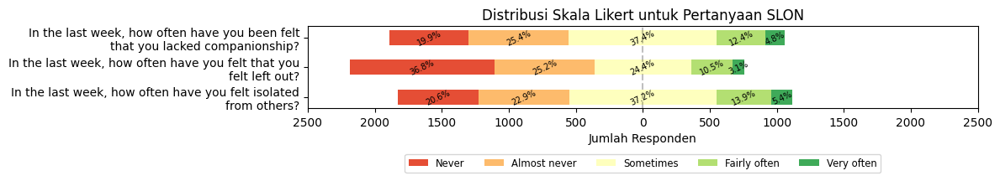

In [33]:
likert_counts = SLON.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = data.shape[1] // 2
    offsets = data[:, :middle_index].sum(axis=1) + data[:, middle_index] / 2


    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=25)
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-2500, 2500)
    ax.set_xticks(np.arange(-2500, 2501, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names),
              bbox_to_anchor=(0.5, -0.5), # Adjust this value if needed
              loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.25)  # Adjust this value if needed
    plt.show()

# Nama kategori (skala Likert)
category_names = ['Never', 'Almost never', 'Sometimes', 'Fairly often', 'Very often']

# Label pertanyaan
labels = [
    "In the last week, how often have you been felt that you lacked companionship?",
    "In the last week, how often have you felt that you felt left out?",
    "In the last week, how often have you felt isolated from others?"
]

wrapped_labels = wrap_labels(labels, width=50)
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan SLON')

In [34]:
lon_col = ['Scale_SLON_1', 'Scale_SLON_2', 'Scale_SLON_3']
lon_df = pd.concat([stress_df[lon_col], Dem_df['Country']], axis=1)
lon_df = lon_df.groupby("Country")[lon_col].mean().reset_index()
lon_df['avg_lon'] = lon_df[lon_col].mean(axis=1)
lon_df.drop(lon_col, axis=1, inplace=True)

In [35]:
lon_df[['latitude', 'longitude']] = lon_df['Country'].apply(get_coordinates).apply(pd.Series)
geodf = geopandas.GeoDataFrame(data = lon_df, geometry = geopandas.points_from_xy(lon_df.longitude,lon_df.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,avg_lon,latitude,longitude,geometry
0,Brunei Darussalam,3.000000,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,2.666667,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,2.352879,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),2.466667,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,2.451499,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,4.666667,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,2.747368,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,2.401961,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,2.491228,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,2.329480,15.926666,107.965086,POINT (107.96509 15.92667)


In [36]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo,
    name="choropleth",
    data = geodf,
    columns = ['Country','avg_lon'],
    key_on = 'feature.properties.name',
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of Lonely Score',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# OECD & Trust

In [37]:
OECD = stress_df[['Trust_countrymeasure', 'OECD_people_1', 'OECD_people_2', 'OECD_insititutions_1', 'OECD_insititutions_2', 'OECD_insititutions_3', 'OECD_insititutions_4', 'OECD_insititutions_5', 'OECD_insititutions_6']]
OECD.describe()

,Trust_countrymeasure,OECD_people_1,OECD_people_2,OECD_insititutions_1,OECD_insititutions_2,OECD_insititutions_3,OECD_insititutions_4,OECD_insititutions_5,OECD_insititutions_6
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.517124,5.267548,7.318074,4.599525,4.970838,5.247881,6.052560,6.565276,5.839607
std,2.184221,1.708577,1.702186,2.401099,2.285246,2.082084,2.314257,2.120415,2.699888
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,5.000000,7.000000,3.000000,4.000000,4.000000,5.000000,5.000000,4.000000
50%,5.000000,5.000000,8.000000,5.000000,5.000000,5.000000,7.000000,7.000000,7.000000
75%,5.000000,6.000000,8.000000,6.000000,6.000000,7.000000,7.000000,8.000000,7.000000
max,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000


In [38]:
oecd_col = ['OECD_people_1', 'OECD_people_2', 'OECD_insititutions_1', 'OECD_insititutions_2', 'OECD_insititutions_3', 'OECD_insititutions_4', 'OECD_insititutions_5', 'OECD_insititutions_6']
oecd_df = pd.concat([stress_df[oecd_col], Dem_df['Country']], axis=1)
oecd_df = oecd_df.groupby("Country")[oecd_col].mean().reset_index()
oecd_df['avg_oecd'] = oecd_df[oecd_col].mean(axis=1)
oecd_df.drop(oecd_col, axis=1, inplace=True)

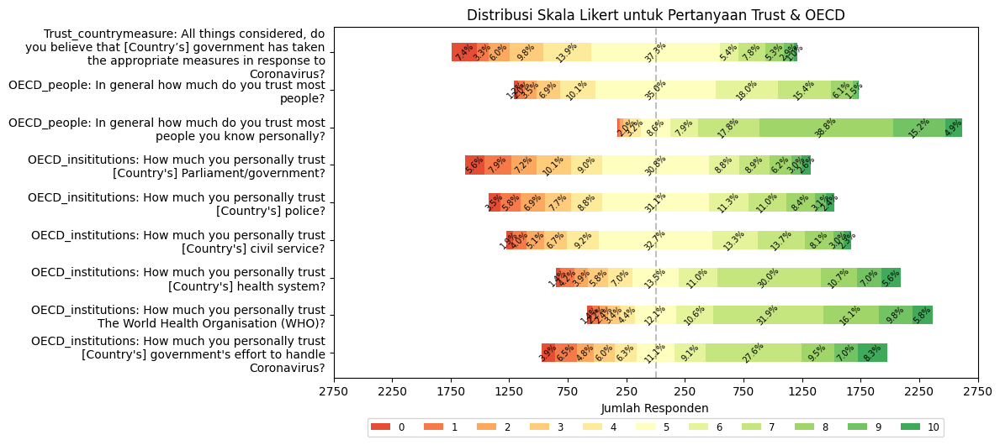

In [39]:
likert_counts = OECD.apply(lambda x: x.value_counts().reindex([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = data.shape[1] // 2
    offsets = data[:, :middle_index].sum(axis=1) + data[:, middle_index] / 2


    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            if percentage > 1:
              ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=45) # Adjust this value if needed
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-2750, 2750)
    ax.set_xticks(np.arange(-2750, 2751, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names),
              bbox_to_anchor=(0.5, -0.1), # Adjust this value if needed
              loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = ['0', '1', '2', '3', '4','5', '6', '7', '8', '9', '10']

# Label pertanyaan
labels = [
    "Trust_countrymeasure: All things considered, do you believe that [Country’s] government has taken the appropriate measures in response to Coronavirus?",
    "OECD_people: In general how much do you trust most people?",
    "OECD_people: In general how much do you trust most people you know personally?",
    "OECD_insititutions: How much you personally trust [Country's] Parliament/government?",
    "OECD_insititutions: How much you personally trust [Country's] police?",
    "OECD_institutions: How much you personally trust [Country's] civil service?",
    "OECD_institutions: How much you personally trust [Country's] health system?",
    "OECD_institutions: How much you personally trust The World Health Organisation (WHO)?",
    "OECD_institutions: How much you personally trust [Country's] government's effort to handle Coronavirus?"
]

wrapped_labels = wrap_labels(labels, width=50)
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan Trust & OECD')

In [40]:
twho = pd.concat([OECD['OECD_insititutions_5'], Dem_df['Country']], axis=1)
twho = twho.groupby("Country")["OECD_insititutions_5"].mean().reset_index()

In [41]:
#converting df to geodf
twho[['latitude', 'longitude']] = twho['Country'].apply(get_coordinates).apply(pd.Series)
geodf = geopandas.GeoDataFrame(data = twho, geometry = geopandas.points_from_xy(twho.longitude,twho.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,OECD_insititutions_5,latitude,longitude,geometry
0,Brunei Darussalam,6.500000,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,8.666667,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,6.513703,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),5.600000,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,6.911817,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,8.000000,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,6.435088,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,5.970588,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,6.000000,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,6.491329,15.926666,107.965086,POINT (107.96509 15.92667)


In [42]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = geodf,
    columns = ['Country','OECD_insititutions_5'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of Trust for WHO',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

In [43]:
tcm_df = pd.concat([stress_df['Trust_countrymeasure'], Dem_df['Country']], axis=1)
tcm_df = tcm_df.groupby("Country")["Trust_countrymeasure"].mean().reset_index()

In [44]:
#converting df to geodf
tcm_df[['latitude', 'longitude']] = tcm_df['Country'].apply(get_coordinates).apply(pd.Series)
geodf = geopandas.GeoDataFrame(data = tcm_df, geometry = geopandas.points_from_xy(tcm_df.longitude,tcm_df.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,Trust_countrymeasure,latitude,longitude,geometry
0,Brunei Darussalam,5.625000,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,4.333333,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,4.184831,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),3.600000,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,6.118166,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,4.000000,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,3.512281,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,5.588235,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,4.368421,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,5.381503,15.926666,107.965086,POINT (107.96509 15.92667)


In [45]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = geodf,
    columns = ['Country','Trust_countrymeasure'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of Trust_countrymeasure',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# Corona Concerns

In [46]:
concern = stress_df[['Corona_concerns_1', 'Corona_concerns_2', 'Corona_concerns_3', 'Corona_concerns_4', 'Corona_concerns_5']]
concern.describe()

,Corona_concerns_1,Corona_concerns_2,Corona_concerns_3,Corona_concerns_4,Corona_concerns_5
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.574093,5.165480,4.721940,5.253645,4.892506
std,1.176295,1.078224,1.063134,1.030451,1.042666
min,1.000000,1.000000,1.000000,1.000000,1.000000
25%,4.000000,5.000000,4.000000,5.000000,5.000000
50%,5.000000,5.000000,5.000000,6.000000,5.000000
75%,5.000000,6.000000,5.000000,6.000000,6.000000
max,6.000000,6.000000,6.000000,6.000000,6.000000


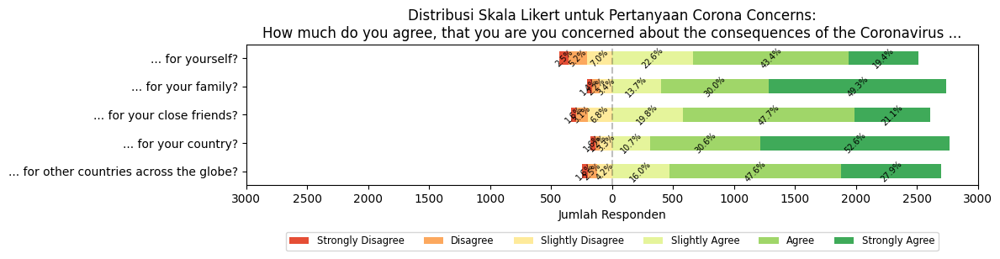

In [47]:
likert_counts = concern.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5, 6]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = 3
    offsets = data[:, :middle_index].sum(axis=1)

    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=45)
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-3000, 3000)
    ax.set_xticks(np.arange(-3000, 3001, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.3), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.25)  # Adjust this value if needed
    plt.show()

# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [ "... for yourself?",
          "... for your family?",
           "... for your close friends?",
           "... for your country?",
           "... for other countries across the globe?" ]

wrapped_labels = wrap_labels(labels, width=60)  # You can adjust the width value as needed
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan Corona Concerns:\nHow much do you agree, that you are you concerned about the consequences of the Coronavirus ...')

In [48]:
concern_col = ['Corona_concerns_1', 'Corona_concerns_2', 'Corona_concerns_3', 'Corona_concerns_4', 'Corona_concerns_5']
concern_df = pd.concat([concern, Dem_df['Country']], axis=1)
concern_df = concern_df.groupby("Country")[concern_col].mean().reset_index()
concern_df['avg_concern'] = concern_df[concern_col].mean(axis=1)
concern_df.drop(concern_col, axis=1, inplace=True)

In [49]:
concern_df[['latitude', 'longitude']] = concern_df['Country'].apply(get_coordinates).apply(pd.Series)

In [50]:
geodf = geopandas.GeoDataFrame(data = concern_df, geometry = geopandas.points_from_xy(concern_df.longitude,concern_df.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,avg_concern,latitude,longitude,geometry
0,Brunei Darussalam,4.875000,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,4.800000,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,4.867431,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),4.920000,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,5.225397,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,5.800000,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,4.813684,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,4.876471,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,4.526316,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,4.823121,15.926666,107.965086,POINT (107.96509 15.92667)


In [51]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = geodf,
    columns = ['Country','avg_concern'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of Corona Concern Score',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# Compliance

In [52]:
compliance = stress_df[['Compliance_1', 'Compliance_2', 'Compliance_3', 'Compliance_4', 'Compliance_5', 'Compliance_6']]
compliance.describe()

,Compliance_1,Compliance_2,Compliance_3,Compliance_4,Compliance_5,Compliance_6
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.993896,5.137335,5.089861,3.103764,4.116989,3.368939
std,0.805319,0.770773,0.782957,1.489020,1.208102,1.222332
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,5.000000,5.000000,5.000000,2.000000,3.000000,2.000000
50%,5.000000,5.000000,5.000000,3.000000,4.000000,4.000000
75%,5.000000,6.000000,6.000000,4.000000,5.000000,4.000000
max,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000


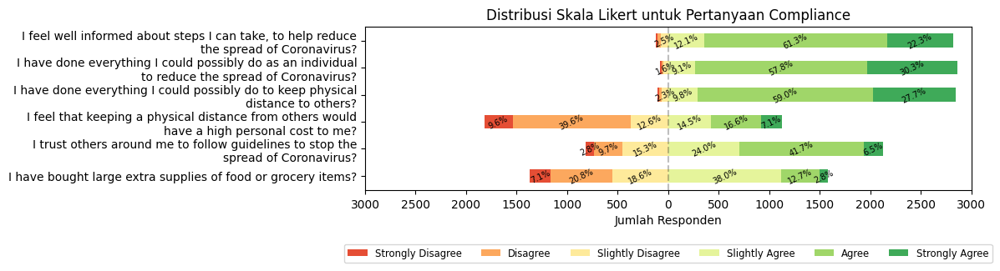

In [53]:
likert_counts = compliance.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5, 6]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = 3
    offsets = data[:, :middle_index].sum(axis=1)

    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            if percentage > 1:
              ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=25) # Adjust this value if needed
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-3000, 3000)
    ax.set_xticks(np.arange(-3000, 3001, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.3), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "I feel well informed about steps I can take, to help reduce the spread of Coronavirus?",
    "I have done everything I could possibly do as an individual to reduce the spread of Coronavirus?",
    "I have done everything I could possibly do to keep physical distance to others?",
    "I feel that keeping a physical distance from others would have a high personal cost to me?",
    "I trust others around me to follow guidelines to stop the spread of Coronavirus?",
    "I have bought large extra supplies of food or grocery items?"
]

wrapped_labels = wrap_labels(labels, width=60)
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan Compliance')

In [54]:
comp_col = ['Compliance_1', 'Compliance_2', 'Compliance_3', 'Compliance_4', 'Compliance_5', 'Compliance_6']
comp_df = pd.concat([stress_df[comp_col], Dem_df['Country']], axis=1)
comp_df = comp_df.groupby("Country")[comp_col].mean().reset_index()
comp_df['avg_comp'] = comp_df[comp_col].mean(axis=1)
comp_df.drop(comp_col, axis=1, inplace=True)

In [61]:
comp_df['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
comp_df['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)

In [62]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = comp_df,
    columns = ['Country','avg_comp'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of Compliance Score',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# BFF

In [63]:
BFF = stress_df[['BFF_15_1', 'BFF_15_2', 'BFF_15_3', 'BFF_15_4', 'BFF_15_5', 'BFF_15_6', 'BFF_15_7', 'BFF_15_8', 'BFF_15_9', 'BFF_15_10', 'BFF_15_11', 'BFF_15_12', 'BFF_15_13', 'BFF_15_14', 'BFF_15_15']]
BFF.describe()

,BFF_15_1,BFF_15_2,BFF_15_3,BFF_15_4,BFF_15_5,BFF_15_6,BFF_15_7,BFF_15_8,BFF_15_9,BFF_15_10,BFF_15_11,BFF_15_12,BFF_15_13,BFF_15_14,BFF_15_15
count,2949.000000,2949.000000,2949.00000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.541879,3.719566,4.32689,4.437436,3.979993,3.931841,4.462530,4.884368,4.426585,2.776195,4.510003,4.688369,4.454391,3.804680,4.618515
std,1.040248,1.204509,1.03088,1.109003,1.329630,1.147426,0.962159,0.864176,1.072880,1.233066,1.006922,0.865557,0.946162,1.220513,0.865012
min,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,4.000000,3.000000,4.00000,4.000000,3.000000,3.000000,4.000000,5.000000,4.000000,2.000000,4.000000,4.000000,4.000000,3.000000,4.000000
50%,5.000000,4.000000,5.00000,5.000000,4.000000,4.000000,5.000000,5.000000,5.000000,2.000000,5.000000,5.000000,5.000000,4.000000,5.000000
75%,5.000000,4.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,4.000000,5.000000,5.000000,5.000000,5.000000,5.000000
max,6.000000,6.000000,6.00000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000


In [64]:
bff_col = ['BFF_15_1', 'BFF_15_2', 'BFF_15_3', 'BFF_15_4', 'BFF_15_5', 'BFF_15_6', 'BFF_15_7', 'BFF_15_8', 'BFF_15_9', 'BFF_15_10', 'BFF_15_11', 'BFF_15_12', 'BFF_15_13', 'BFF_15_14', 'BFF_15_15']
bff_df = pd.concat([stress_df[bff_col], Dem_df['Country']], axis=1)
bff_df = bff_df.groupby("Country")[bff_col].mean().reset_index()
bff_df['avg_bff'] = bff_df[bff_col].mean(axis=1)
bff_df.drop(bff_col, axis=1, inplace=True)

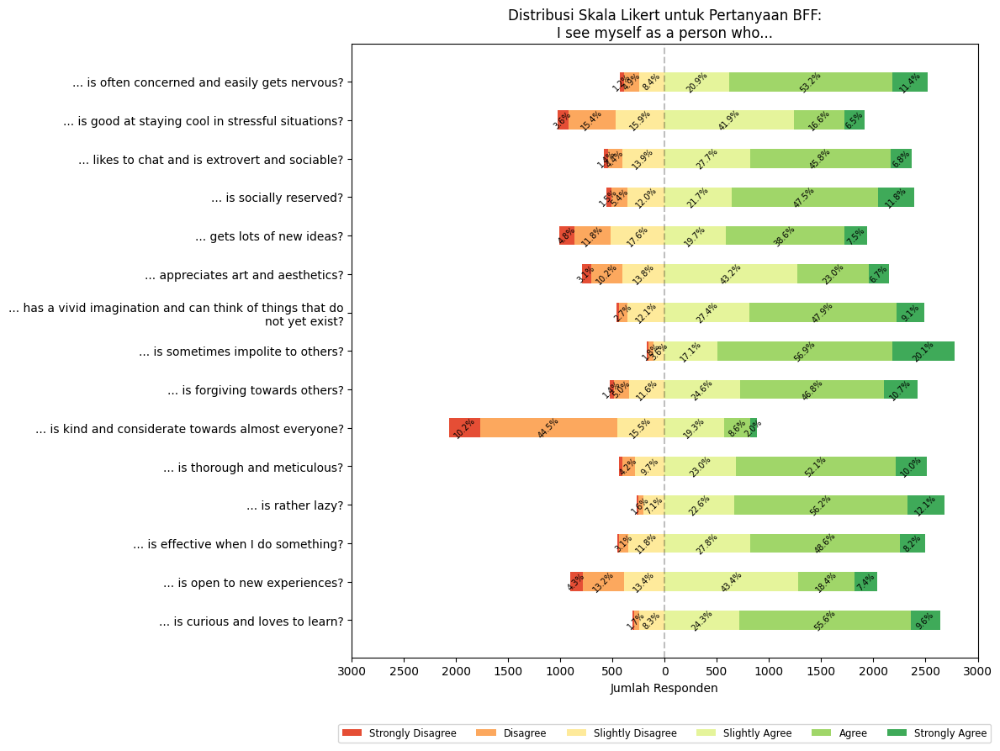

In [65]:
likert_counts = BFF.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5, 6]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = 3
    offsets = data[:, :middle_index].sum(axis=1)

    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            if percentage > 1:
              ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=45) # Adjust this value if needed
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-3000, 3000)
    ax.set_xticks(np.arange(-3000, 3001, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "... is often concerned and easily gets nervous?",
    "... is good at staying cool in stressful situations?",
    "... likes to chat and is extrovert and sociable?",
    "... is socially reserved?",
    "... gets lots of new ideas?",
    "... appreciates art and aesthetics?",
    "... has a vivid imagination and can think of things that do not yet exist?",
    "... is sometimes impolite to others?",
    "... is forgiving towards others?",
    "... is kind and considerate towards almost everyone?",
    "... is thorough and meticulous?",
    "... is rather lazy?",
    "... is effective when I do something?",
    "... is open to new experiences?",
    "... is curious and loves to learn?"
]

wrapped_labels = wrap_labels(labels, width=60)
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan BFF:\nI see myself as a person who...')

# Distress

In [66]:
distress = stress_df[['Expl_Distress_1','Expl_Distress_2','Expl_Distress_3','Expl_Distress_4','Expl_Distress_5','Expl_Distress_6','Expl_Distress_7','Expl_Distress_8', 'Expl_Distress_9', 'Expl_Distress_10', 'Expl_Distress_11', 'Expl_Distress_12', 'Expl_Distress_13', 'Expl_Distress_14', 'Expl_Distress_15', 'Expl_Distress_16', 'Expl_Distress_17', 'Expl_Distress_18', 'Expl_Distress_19', 'Expl_Distress_20', 'Expl_Distress_21', 'Expl_Distress_22', 'Expl_Distress_23', 'Expl_Distress_24']]
distress.describe()

,Expl_Distress_1,Expl_Distress_2,Expl_Distress_3,Expl_Distress_4,Expl_Distress_5,Expl_Distress_6,Expl_Distress_7,Expl_Distress_8,Expl_Distress_9,Expl_Distress_10,...,Expl_Distress_15,Expl_Distress_16,Expl_Distress_17,Expl_Distress_18,Expl_Distress_19,Expl_Distress_20,Expl_Distress_21,Expl_Distress_22,Expl_Distress_23,Expl_Distress_24
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,...,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.453374,4.401831,5.515090,4.559173,4.266870,4.098338,4.037301,4.171923,5.120380,4.840963,...,4.269922,4.057308,2.870465,3.126823,4.169210,3.254323,2.853510,2.722618,4.685317,3.269583
std,1.650299,1.350515,2.003608,1.442113,1.311282,1.467592,1.655743,1.586689,2.194593,1.066069,...,1.544143,1.465954,1.511884,1.588477,1.471872,1.566402,1.433595,1.367026,1.203226,1.805566
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,3.000000,4.000000,4.000000,4.000000,4.000000,3.000000,2.000000,3.000000,3.000000,4.000000,...,3.000000,3.000000,2.000000,2.000000,3.000000,2.000000,2.000000,2.000000,4.000000,2.000000
50%,5.000000,5.000000,7.000000,5.000000,5.000000,5.000000,5.000000,5.000000,7.000000,5.000000,...,5.000000,5.000000,2.000000,2.000000,5.000000,3.000000,2.000000,2.000000,5.000000,2.000000
75%,5.000000,5.000000,7.000000,5.000000,5.000000,5.000000,5.000000,5.000000,7.000000,5.000000,...,5.000000,5.000000,4.000000,4.000000,5.000000,4.000000,4.000000,3.000000,5.000000,5.000000
max,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,...,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000


In [67]:
distress_col = ['Expl_Distress_1','Expl_Distress_2','Expl_Distress_3','Expl_Distress_4','Expl_Distress_5','Expl_Distress_6','Expl_Distress_7','Expl_Distress_8', 'Expl_Distress_9', 'Expl_Distress_10', 'Expl_Distress_11', 'Expl_Distress_12', 'Expl_Distress_13', 'Expl_Distress_14', 'Expl_Distress_15', 'Expl_Distress_16', 'Expl_Distress_17', 'Expl_Distress_18', 'Expl_Distress_19', 'Expl_Distress_20', 'Expl_Distress_21', 'Expl_Distress_22', 'Expl_Distress_23', 'Expl_Distress_24']
distress_df = pd.concat([stress_df[distress_col], Dem_df['Country']], axis=1)
distress_df = distress_df.groupby("Country")[distress_col].mean().reset_index()
distress_df['avg_distress'] = distress_df[distress_col].mean(axis=1)
distress_df.drop(distress_col, axis=1, inplace=True)

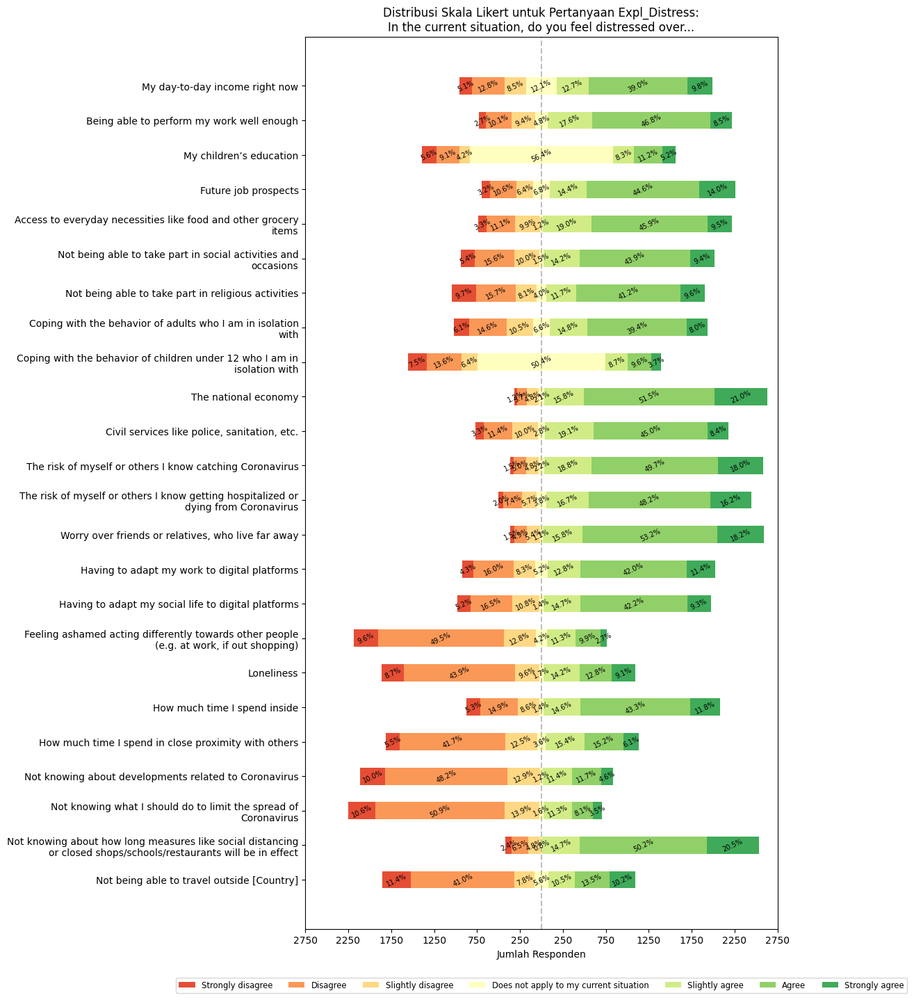

In [68]:
likert_counts = distress.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5, 6, 7]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]


def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = data.shape[1] // 2
    offsets = data[:, :middle_index].sum(axis=1) + data[:, middle_index] / 2


    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=25)
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-2750, 2750)
    ax.set_xticks(np.arange(-2750, 2751, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.05), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = ["Strongly disagree",
    "Disagree",
    "Slightly disagree",
    "Does not apply to my current situation",
    "Slightly agree",
    "Agree",
    "Strongly agree"]

# Reorder the columns of likert_counts
likert_counts_reordered = likert_counts.reindex([1, 2, 3, 7, 4, 5, 6])

# Label pertanyaan
labels = [
    "My day-to-day income right now",
    "Being able to perform my work well enough",
    "My children’s education",
    "Future job prospects",
    "Access to everyday necessities like food and other grocery items",
    "Not being able to take part in social activities and occasions",
    "Not being able to take part in religious activities",
    "Coping with the behavior of adults who I am in isolation with",
    "Coping with the behavior of children under 12 who I am in isolation with",
    "The national economy",
    "Civil services like police, sanitation, etc.",
    "The risk of myself or others I know catching Coronavirus",
    "The risk of myself or others I know getting hospitalized or dying from Coronavirus",
    "Worry over friends or relatives, who live far away",
    "Having to adapt my work to digital platforms",
    "Having to adapt my social life to digital platforms",
    "Feeling ashamed acting differently towards other people (e.g. at work, if out shopping)",
    "Loneliness",
    "How much time I spend inside",
    "How much time I spend in close proximity with others",
    "Not knowing about developments related to Coronavirus",
    "Not knowing what I should do to limit the spread of Coronavirus",
    "Not knowing about how long measures like social distancing or closed shops/schools/restaurants will be in effect",
    "Not being able to travel outside [Country]"
]

wrapped_labels = wrap_labels(labels, width=60)  # You can adjust the width value as needed
diverging_stacked_bar(likert_counts_reordered, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan Expl_Distress:\nIn the current situation, do you feel distressed over...')

# SPS

In [69]:
SPS = stress_df[['SPS_1', 'SPS_2', 'SPS_3', 'SPS_4', 'SPS_5', 'SPS_6', 'SPS_7', 'SPS_8', 'SPS_9', 'SPS_10']]
SPS.describe()

,SPS_1,SPS_2,SPS_3,SPS_4,SPS_5,SPS_6,SPS_7,SPS_8,SPS_9,SPS_10
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.826043,4.711089,4.650051,4.796202,4.857918,4.673449,4.840285,4.846389,4.576467,4.814513
std,0.882469,0.891663,0.930570,0.907252,0.883565,0.876446,0.901863,0.921147,0.950970,0.900313
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,5.000000,4.000000,4.000000,5.000000,5.000000,4.000000,5.000000,5.000000,4.000000,5.000000
50%,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
75%,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
max,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000


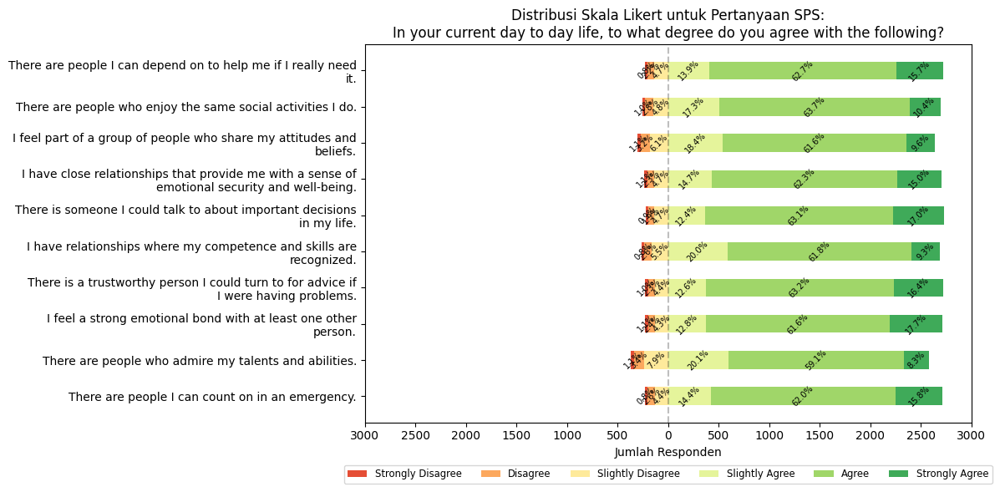

In [70]:
likert_counts = SPS.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5, 6]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = 3
    offsets = data[:, :middle_index].sum(axis=1)

    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=45) # Adjust this value if needed
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-3000, 3000)
    ax.set_xticks(np.arange(-3000, 3001, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "There are people I can depend on to help me if I really need it.",
    "There are people who enjoy the same social activities I do.",
    "I feel part of a group of people who share my attitudes and beliefs.",
    "I have close relationships that provide me with a sense of emotional security and well-being.",
    "There is someone I could talk to about important decisions in my life.",
    "I have relationships where my competence and skills are recognized.",
    "There is a trustworthy person I could turn to for advice if I were having problems.",
    "I feel a strong emotional bond with at least one other person.",
    "There are people who admire my talents and abilities.",
    "There are people I can count on in an emergency."
]

wrapped_labels = wrap_labels(labels, width=60)
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan SPS:\nIn your current day to day life, to what degree do you agree with the following?')

In [71]:
sps_col = ['SPS_1', 'SPS_2', 'SPS_3', 'SPS_4', 'SPS_5', 'SPS_6', 'SPS_7', 'SPS_8', 'SPS_9', 'SPS_10']
sps_df = pd.concat([stress_df[sps_col], Dem_df['Country']], axis=1)
sps_df = sps_df.groupby("Country")[sps_col].mean().reset_index()
sps_df['avg_sps'] = sps_df[sps_col].mean(axis=1)
sps_df.drop(sps_col, axis=1, inplace=True)

In [72]:
sps_df[['latitude', 'longitude']] = sps_df['Country'].apply(get_coordinates).apply(pd.Series)

In [73]:
geodf = geopandas.GeoDataFrame(data = sps_df, geometry = geopandas.points_from_xy(sps_df.longitude,sps_df.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,avg_sps,latitude,longitude,geometry
0,Brunei Darussalam,4.737500,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,4.200000,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,4.743658,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),5.240000,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,4.801940,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,5.000000,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,4.746667,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,4.914706,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,4.700000,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,4.773410,15.926666,107.965086,POINT (107.96509 15.92667)


In [74]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = geodf,
    columns = ['Country','avg_sps'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of SPS Score',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# Coping

In [75]:
coping = stress_df[['Expl_Coping_1', 'Expl_Coping_2', 'Expl_Coping_3', 'Expl_Coping_4', 'Expl_Coping_5', 'Expl_Coping_6', 'Expl_Coping_7', 'Expl_Coping_8', 'Expl_Coping_9', 'Expl_Coping_10', 'Expl_Coping_11', 'Expl_Coping_12', 'Expl_Coping_13', 'Expl_Coping_14', 'Expl_Coping_15', 'Expl_Coping_16']]
coping.describe()

,Expl_Coping_1,Expl_Coping_2,Expl_Coping_3,Expl_Coping_4,Expl_Coping_5,Expl_Coping_6,Expl_Coping_7,Expl_Coping_8,Expl_Coping_9,Expl_Coping_10,Expl_Coping_11,Expl_Coping_12,Expl_Coping_13,Expl_Coping_14,Expl_Coping_15,Expl_Coping_16
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.00000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.500170,4.490336,4.820617,3.683622,4.565615,4.597152,4.068498,3.980332,4.79688,4.650390,4.570363,4.704307,4.586979,4.836894,5.008138,4.582231
std,1.047263,1.113165,0.876364,1.156044,1.035095,1.019720,1.484676,1.509902,0.90703,0.873737,0.908771,0.867034,0.953630,0.806719,1.447616,0.977930
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,4.000000,4.000000,5.000000,3.000000,4.000000,4.000000,3.000000,3.000000,5.00000,4.000000,4.000000,4.000000,4.000000,5.000000,5.000000,4.000000
50%,5.000000,5.000000,5.000000,4.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,6.000000,5.000000
75%,5.000000,5.000000,5.000000,4.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,6.000000,5.000000
max,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.00000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000


In [76]:
coping.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2949 entries, 147 to 118882
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Expl_Coping_1   2949 non-null   float64
 1   Expl_Coping_2   2949 non-null   float64
 2   Expl_Coping_3   2949 non-null   float64
 3   Expl_Coping_4   2949 non-null   float64
 4   Expl_Coping_5   2949 non-null   float64
 5   Expl_Coping_6   2949 non-null   float64
 6   Expl_Coping_7   2949 non-null   float64
 7   Expl_Coping_8   2949 non-null   float64
 8   Expl_Coping_9   2949 non-null   float64
 9   Expl_Coping_10  2949 non-null   float64
 10  Expl_Coping_11  2949 non-null   float64
 11  Expl_Coping_12  2949 non-null   float64
 12  Expl_Coping_13  2949 non-null   float64
 13  Expl_Coping_14  2949 non-null   float64
 14  Expl_Coping_15  2949 non-null   float64
 15  Expl_Coping_16  2949 non-null   float64
dtypes: float64(16)
memory usage: 391.7 KB


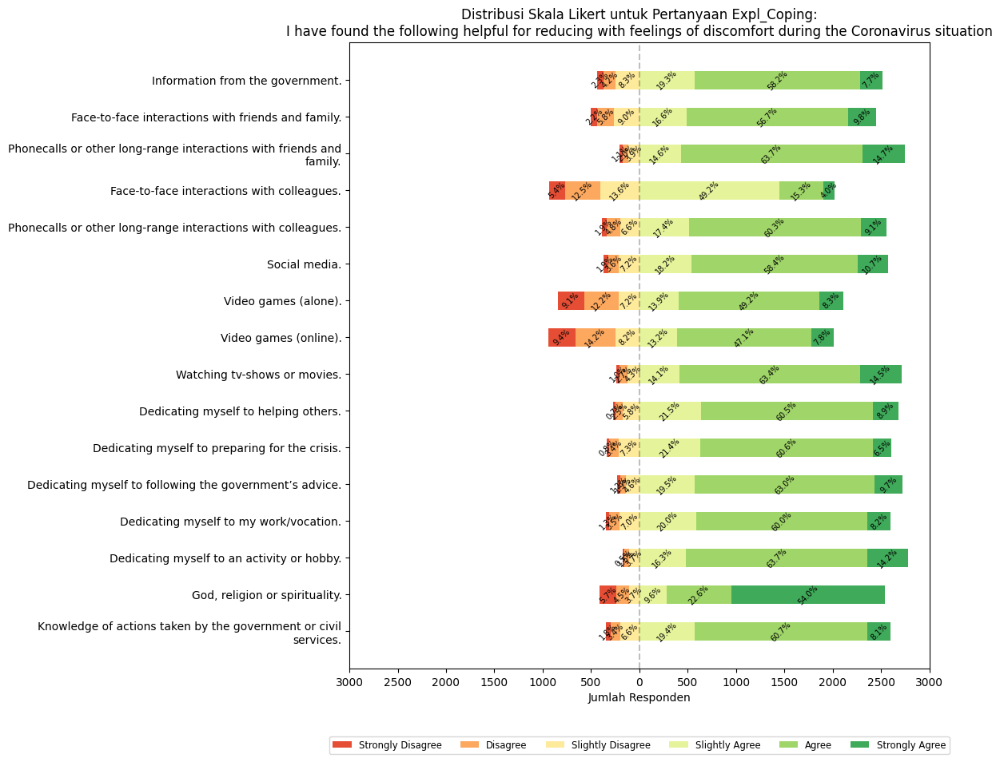

In [77]:
likert_counts = coping.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5, 6]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = 3
    offsets = data[:, :middle_index].sum(axis=1)

    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=45) # Adjust this value if needed
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-3000, 3000)
    ax.set_xticks(np.arange(-3000, 3001, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "Information from the government.",
    "Face-to-face interactions with friends and family.",
    "Phonecalls or other long-range interactions with friends and family.",
    "Face-to-face interactions with colleagues.",
    "Phonecalls or other long-range interactions with colleagues.",
    "Social media.",
    "Video games (alone).",
    "Video games (online).",
    "Watching tv-shows or movies.",
    "Dedicating myself to helping others.",
    "Dedicating myself to preparing for the crisis.",
    "Dedicating myself to following the government’s advice.",
    "Dedicating myself to my work/vocation.",
    "Dedicating myself to an activity or hobby.",
    "God, religion or spirituality.",
    "Knowledge of actions taken by the government or civil services."
]

wrapped_labels = wrap_labels(labels, width=60)  # You can adjust the width value as needed
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan Expl_Coping:\nI have found the following helpful for reducing with feelings of discomfort during the Coronavirus situation')

In [78]:
coping_col = ['Expl_Coping_1', 'Expl_Coping_2', 'Expl_Coping_3', 'Expl_Coping_4', 'Expl_Coping_5', 'Expl_Coping_6', 'Expl_Coping_7', 'Expl_Coping_8', 'Expl_Coping_9', 'Expl_Coping_10', 'Expl_Coping_11', 'Expl_Coping_12', 'Expl_Coping_13', 'Expl_Coping_14', 'Expl_Coping_15', 'Expl_Coping_16']
coping_df = pd.concat([stress_df[coping_col], Dem_df['Country']], axis=1)
coping_df = coping_df.groupby("Country")[coping_col].mean().reset_index()
coping_df['avg_coping'] = coping_df[coping_col].mean(axis=1)
coping_df.drop(coping_col, axis=1, inplace=True)

In [79]:
coping_df[['latitude', 'longitude']] = coping_df['Country'].apply(get_coordinates).apply(pd.Series)

In [80]:
geodf = geopandas.GeoDataFrame(data = coping_df, geometry = geopandas.points_from_xy(coping_df.longitude,coping_df.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,avg_coping,latitude,longitude,geometry
0,Brunei Darussalam,3.609375,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,3.583333,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,4.603171,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),4.337500,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,4.519621,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,5.000000,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,4.449452,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,4.189338,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,3.924342,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,4.321171,15.926666,107.965086,POINT (107.96509 15.92667)


In [81]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = geodf,
    columns = ['Country','avg_coping'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of Coping Score',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# Media

In [82]:
media = stress_df[['Expl_media_1', 'Expl_media_2', 'Expl_media_3', 'Expl_media_4', 'Expl_media_5', 'Expl_media_6']]
media.describe()

,Expl_media_1,Expl_media_2,Expl_media_3,Expl_media_4,Expl_media_5,Expl_media_6
count,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000,2949.000000
mean,4.563581,4.523567,4.436419,4.341133,4.632757,3.330281
std,1.015038,1.014751,1.069709,1.092844,0.994093,1.136884
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000
50%,5.000000,5.000000,5.000000,5.000000,5.000000,3.000000
75%,5.000000,5.000000,5.000000,5.000000,5.000000,4.000000
max,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000


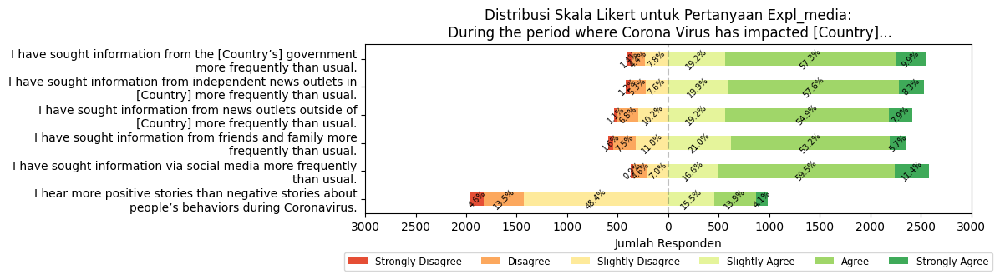

In [83]:
likert_counts = media.apply(lambda x: x.value_counts().reindex([1, 2, 3, 4, 5, 6]).fillna(0), axis=0)

def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

def diverging_stacked_bar(data, category_names, labels, title):
    data = np.array(data.T)
    data_cum = data.cumsum(axis=1)
    middle_index = 3
    offsets = data[:, :middle_index].sum(axis=1)

    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(12, len(labels) * 0.6))

    # Plot setiap kategori
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths - offsets  # Atur offset untuk membuat efek diverging
        for j, label in enumerate(labels):
            percentage = (widths[j] / likert_counts.iloc[:, j].sum()) * 100
            ax.text(starts[j] + widths[j] / 2, j, f"{percentage:.1f}%", ha='center', va='center', color='black', fontsize=7, rotation=45) # Adjust this value if needed
        ax.barh(labels, widths, left=starts, height=0.5, label=colname, color=color)

    # Garis vertikal referensi
    ax.axvline(0, linestyle='--', color='black', alpha=.25)

    # X axis
    ax.set_xlabel('Jumlah Responden')
    ax.set_title(title)
    ax.set_xlim(-3000, 3000)
    ax.set_xticks(np.arange(-3000, 3001, 500))
    ax.xaxis.set_major_formatter(lambda x, pos: str(abs(int(x))))

    # Y axis
    ax.invert_yaxis()

    # Legend
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.2), loc='upper center', fontsize='small')

    # Tampilkan plot
    plt.tight_layout()
    plt.show()

# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "I have sought information from the [Country’s] government more frequently than usual.",
    "I have sought information from independent news outlets in [Country] more frequently than usual.",
    "I have sought information from news outlets outside of [Country] more frequently than usual.",
    "I have sought information from friends and family more frequently than usual.",
    "I have sought information via social media more frequently than usual.",
    "I hear more positive stories than negative stories about people’s behaviors during Coronavirus."
]

wrapped_labels = wrap_labels(labels, width=60)  # You can adjust the width value as needed
diverging_stacked_bar(likert_counts, category_names, wrapped_labels, 'Distribusi Skala Likert untuk Pertanyaan Expl_media:\n During the period where Corona Virus has impacted [Country]...')

In [84]:
media_col = ['Expl_media_1', 'Expl_media_2', 'Expl_media_3', 'Expl_media_4', 'Expl_media_5', 'Expl_media_6']
media_df = pd.concat([stress_df[media_col], Dem_df['Country']], axis=1)
media_df = media_df.groupby("Country")[media_col].mean().reset_index()
media_df['avg_media'] = media_df[media_col].mean(axis=1)
media_df.drop(media_col, axis=1, inplace=True)

In [85]:
media_df[['latitude', 'longitude']] = media_df['Country'].apply(get_coordinates).apply(pd.Series)

In [86]:
geodf = geopandas.GeoDataFrame(data = media_df, geometry = geopandas.points_from_xy(media_df.longitude,media_df.latitude), crs='EPSG:4326')
geodf['Country'].replace('Viet Nam', 'Vietnam', inplace=True)
geodf['Country'].replace("Lao People's Democratic Republic", 'Laos (Lao People’s Democratic Republic)', inplace=True)
geodf

,Country,avg_media,latitude,longitude,geometry
0,Brunei Darussalam,4.250000,4.413716,114.565391,POINT (114.56539 4.41372)
1,Cambodia,3.555556,12.543322,104.814491,POINT (104.81449 12.54332)
2,Indonesia,4.296473,-2.483383,117.890285,POINT (117.89029 -2.48338)
3,Laos (Lao People’s Democratic Republic),4.233333,20.017111,103.378253,POINT (103.37825 20.01711)
4,Malaysia,4.385949,4.569375,102.265682,POINT (102.26568 4.56938)
5,Myanmar,4.666667,17.175050,95.999965,POINT (95.99997 17.17505)
6,Philippines,4.278947,12.750349,122.731210,POINT (122.73121 12.75035)
7,Singapore,4.171569,1.357107,103.819499,POINT (103.8195 1.35711)
8,Thailand,4.140351,14.897192,100.832730,POINT (100.83273 14.89719)
9,Vietnam,4.256262,15.926666,107.965086,POINT (107.96509 15.92667)


In [87]:
m = folium.Map(location=[-2,95])
choro_test =folium.Choropleth(
    geo_data = southeastAsia_geo, # Use the 'states' GeoDataFrame which contains the GeoJSON data
    name="choropleth",
    data = geodf,
    columns = ['Country','avg_media'],
    key_on = 'feature.properties.name', # Corrected key_on format to access the 'name' property in the GeoJSON features
    fill_color = 'YlGnBu',
    nan_fill_color = "White",
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Average value of Information on Media Score',
    line_color = 'black',
    nan_fill_opacity = 0.3
).add_to(m)

folium.LayerControl().add_to(m)

m

# Korelasi antara seluruh indikator

In [89]:
all_df = pd.concat([pss_df['avg_PSS10'], lon_df['avg_lon'], tcm_df['Trust_countrymeasure'], oecd_df['avg_oecd'], bff_df['avg_bff'], distress_df['avg_distress'], concern_df['avg_concern'], comp_df['avg_comp'] , sps_df['avg_sps'], coping_df['avg_coping'],media_df['avg_media']], axis=1)

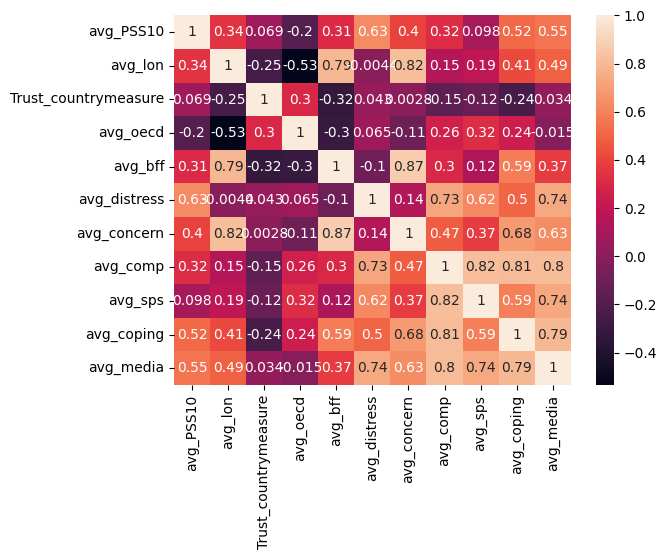

In [90]:
sns.heatmap(all_df.corr(),annot=True)
plt.show()

# Age Group: Visualisasi Age Group dengan Survey

Apakah dengan **kategori usia responden yang berbeda** cenderung menghasilkan **jawaban survey yang berbeda**?

## Informasi Age

In [91]:
Dem_df['Dem_age'].describe()

,Dem_age
count,2949.000000
mean,30.997626
std,11.631191
min,18.000000
25%,22.000000
50%,27.000000
75%,37.000000
max,86.000000


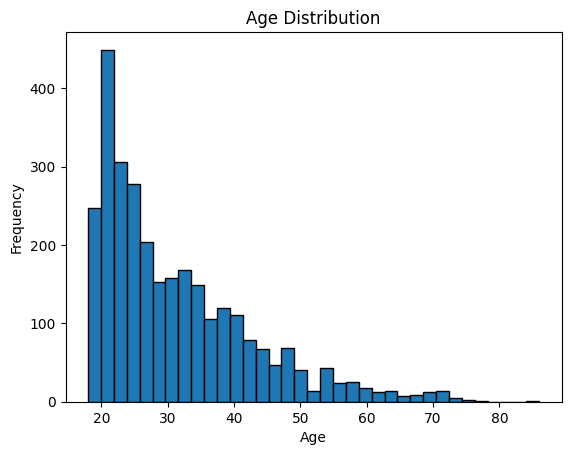

In [92]:
# Histogram

plt.hist(Dem_df['Dem_age'], bins=35, edgecolor='black')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.title('Age Distribution')
plt.show()

<ipython-input-93-2cd6fb74767b>:3: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(Dem_df['Dem_age'], shade=True)


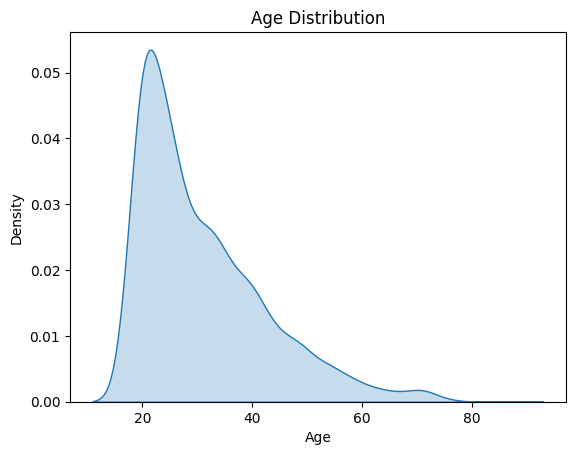

In [93]:
# Density Plot

sns.kdeplot(Dem_df['Dem_age'], shade=True)
plt.xlabel('Age')
plt.ylabel('Density')
plt.title('Age Distribution')
plt.show()

### Klasifikasi Age

Klasifikasi didasarkan paper ini: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9253723/

In [94]:
# Definisikan rentang usia dan label untuk klasifikasi
bins = [17, 30, 40, 50, 60, 70, float('inf')]  # Batas-batas rentang usia
labels = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']  # Label klasifikasi

# Membuat kolom baru 'Age_Group' berdasarkan klasifikasi umur
Dem_df['Age_Group'] = pd.cut(Dem_df['Dem_age'], bins=bins, labels=labels, right=True)

# Menampilkan beberapa baris pertama
Dem_df[['Dem_age', 'Age_Group']].head()

<ipython-input-94-34e8278e8cbe>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Dem_df['Age_Group'] = pd.cut(Dem_df['Dem_age'], bins=bins, labels=labels, right=True)


,Dem_age,Age_Group
147,41,41–50
522,25,18–30
1475,39,31–40
1544,24,18–30
1630,21,18–30


## PSS10

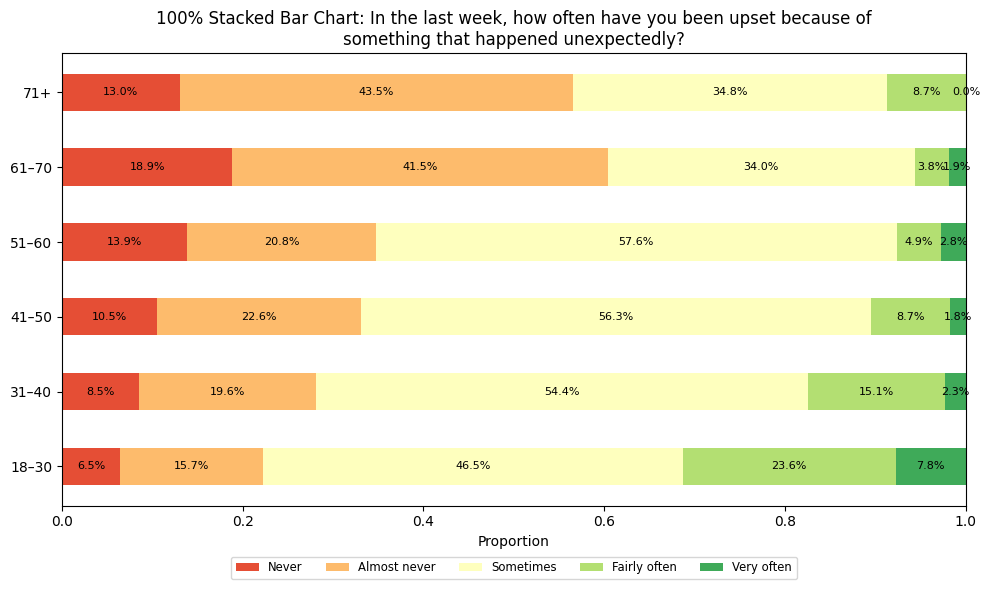

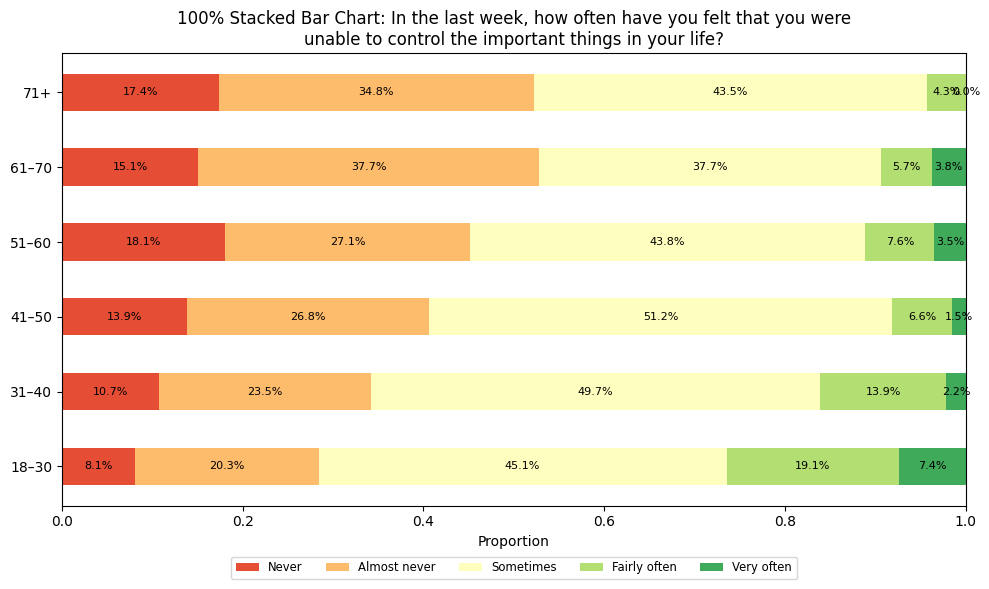

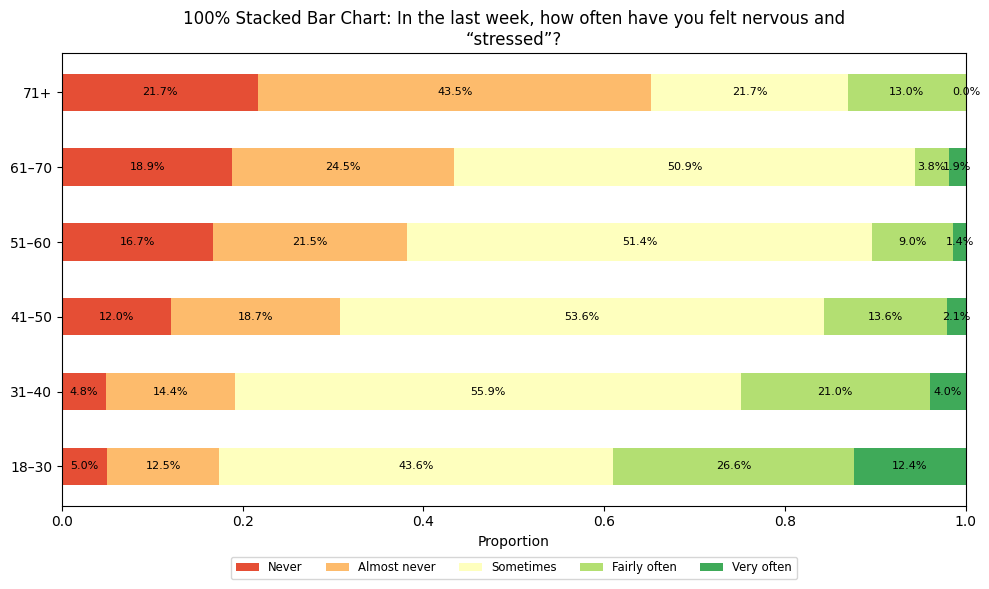

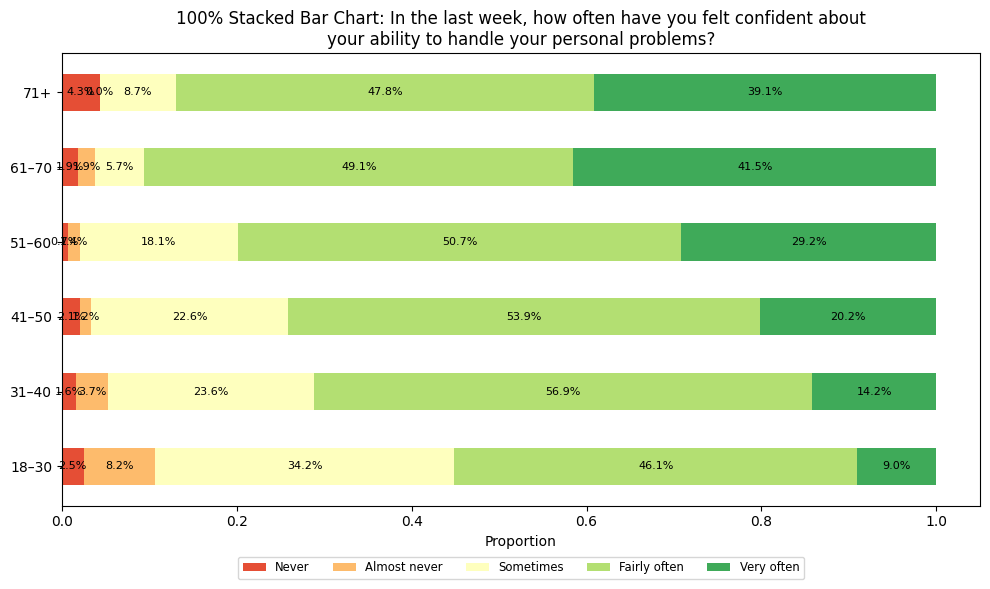

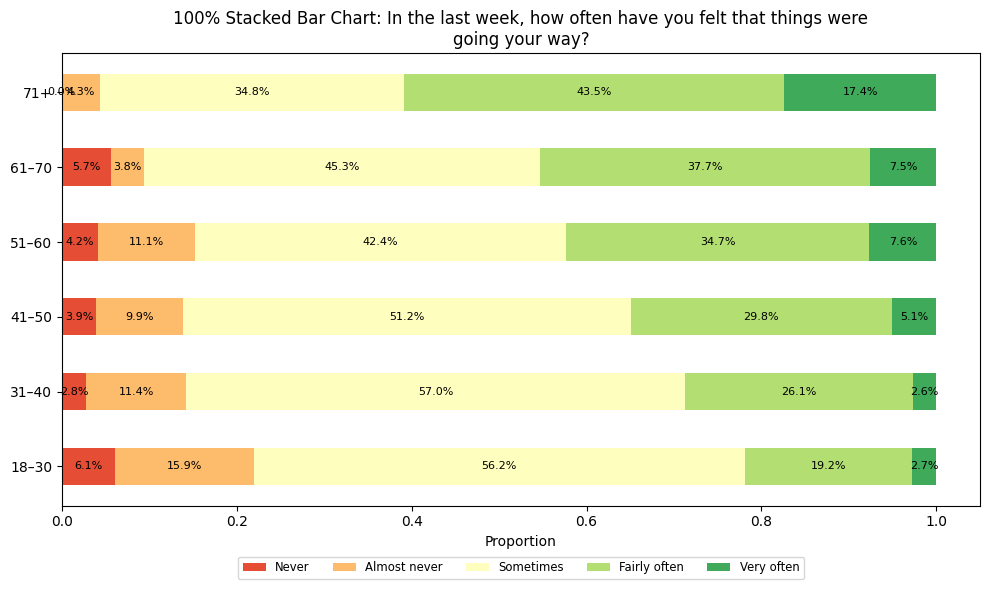

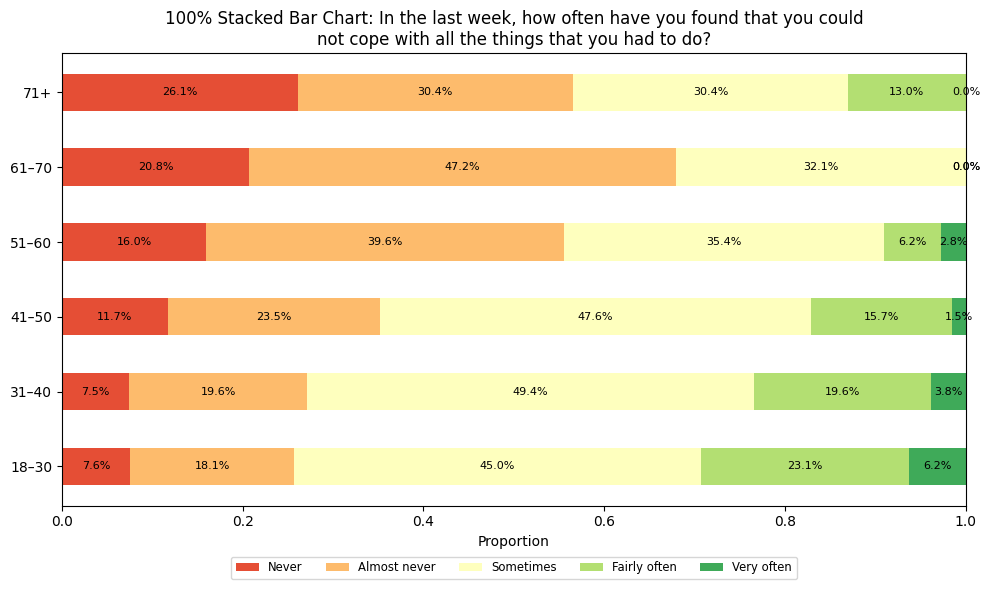

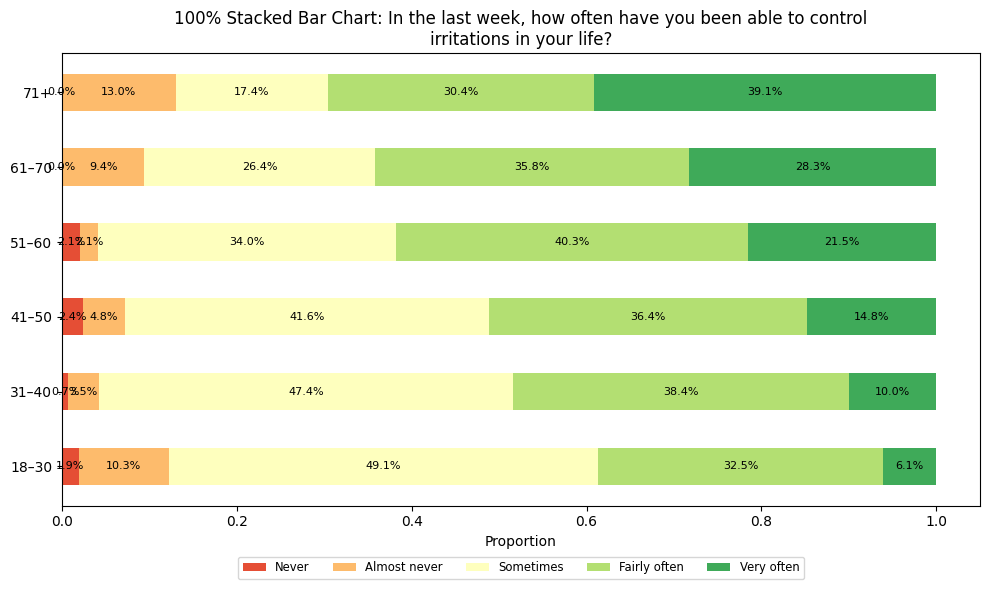

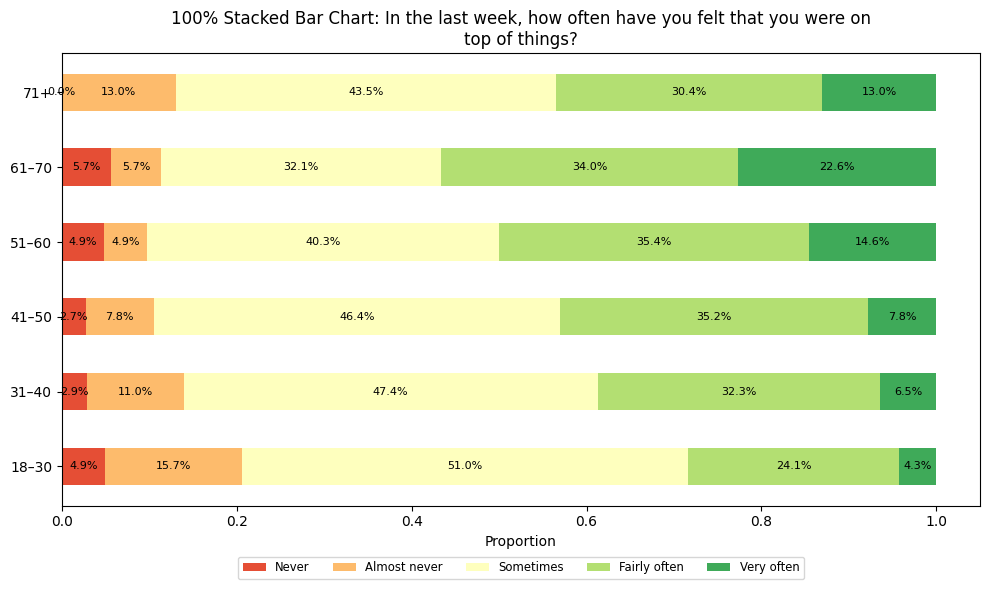

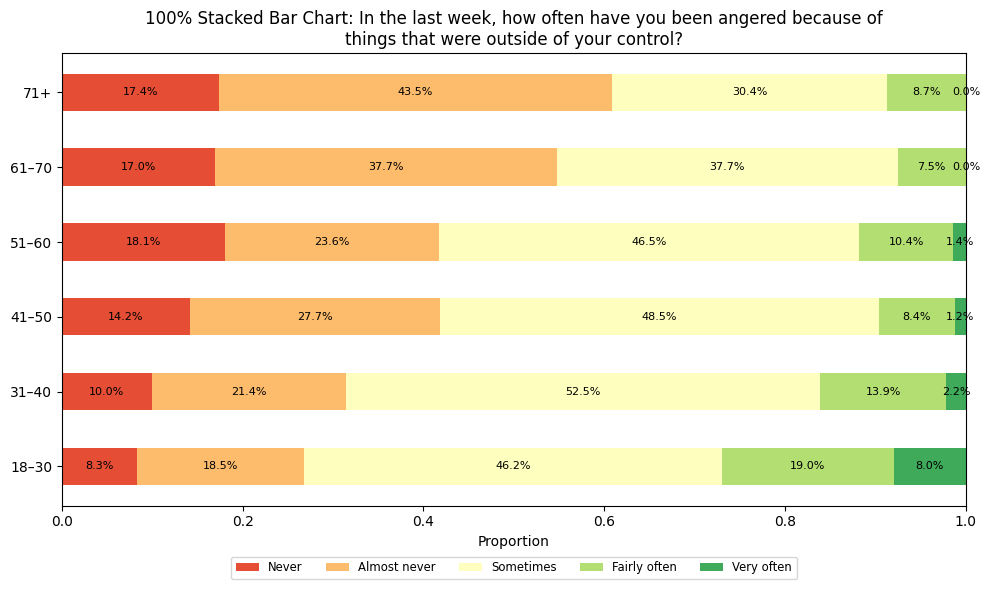

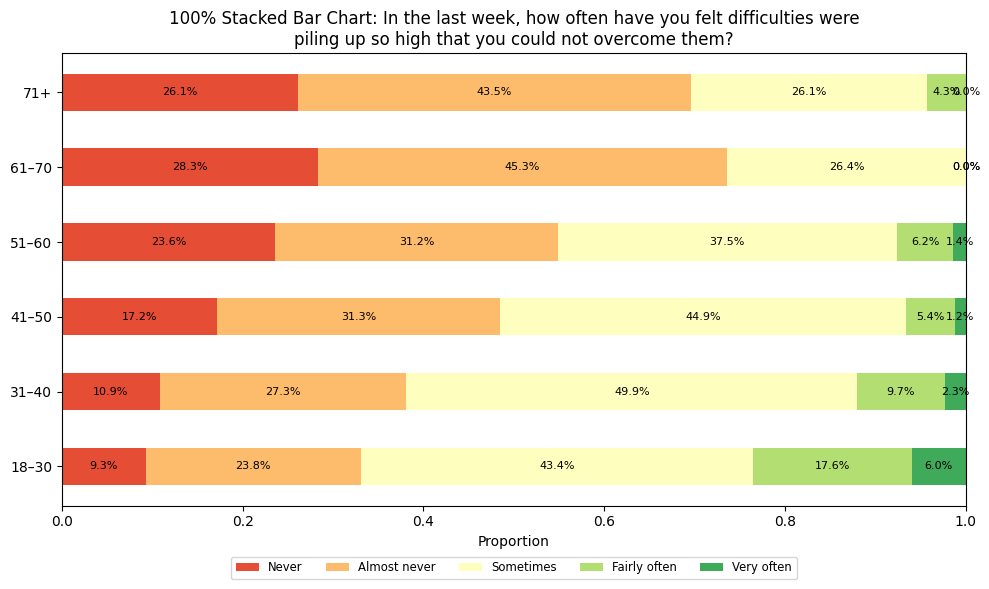

In [95]:
# Keterangan Likert
category_names = ['Never', 'Almost never', 'Sometimes', 'Fairly often', 'Very often']

# Pertanyaan survey
labels = [
    "In the last week, how often have you been upset because of something that happened unexpectedly?",
    "In the last week, how often have you felt that you were unable to control the important things in your life?",
    "In the last week, how often have you felt nervous and “stressed”?",
    "In the last week, how often have you felt confident about your ability to handle your personal problems?",
    "In the last week, how often have you felt that things were going your way?",
    "In the last week, how often have you found that you could not cope with all the things that you had to do?",
    "In the last week, how often have you been able to control irritations in your life?",
    "In the last week, how often have you felt that you were on top of things?",
    "In the last week, how often have you been angered because of things that were outside of your control?",
    "In the last week, how often have you felt difficulties were piling up so high that you could not overcome them?"
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar
        for y, (start, width) in enumerate(zip(starts, widths)):
            ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                    va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(PSS10.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = PSS10.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

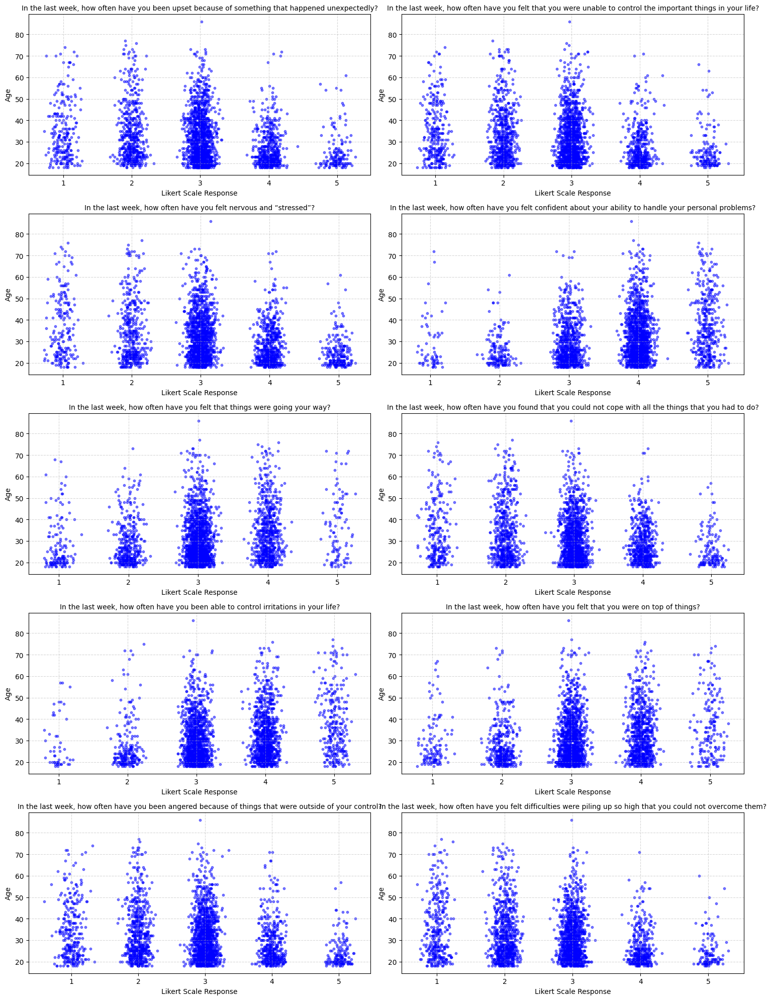

In [96]:
plt.figure(figsize=(15, 20))

for i, column in enumerate(PSS10.columns):
    plt.subplot(5, 2, i + 1)

    x = PSS10[column] + np.random.normal(0, 0.1, size=PSS10.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(labels[i], fontsize=10)
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 6))  # Likert scale ranges from 1 to 5
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## SLON

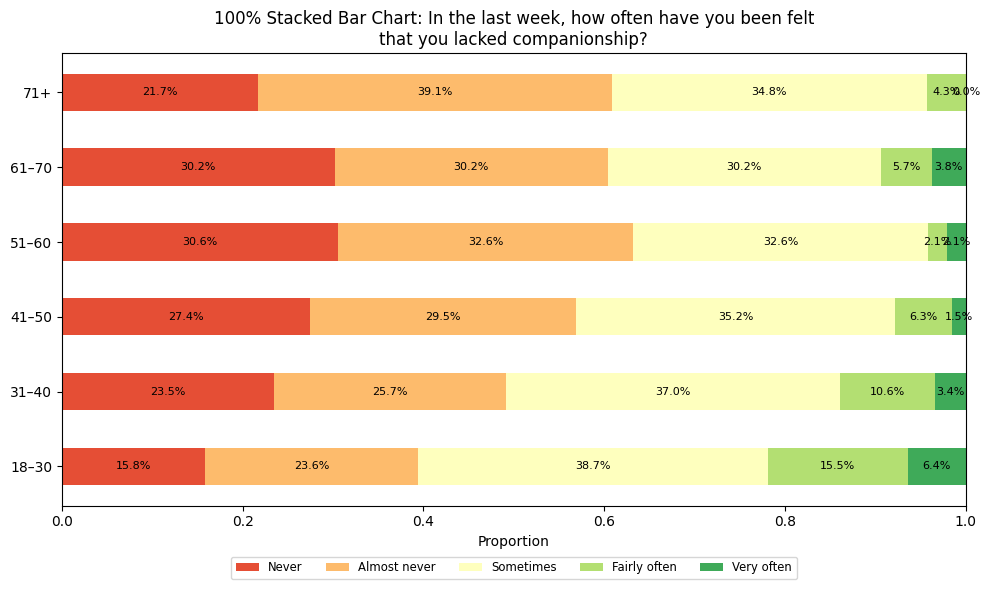

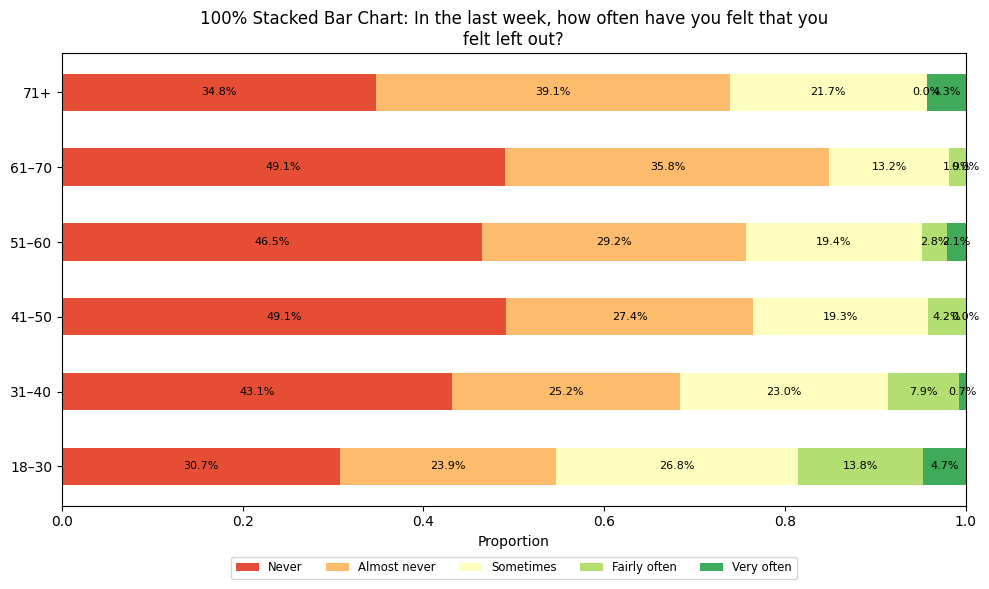

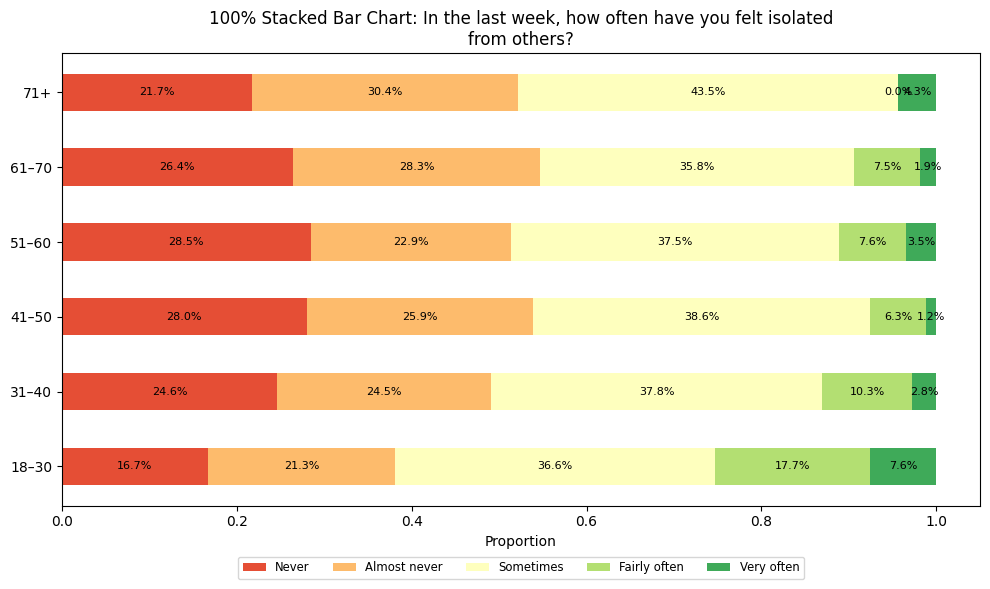

In [97]:
# Keterangan Likert
category_names = ['Never', 'Almost never', 'Sometimes', 'Fairly often', 'Very often']

# Pertanyaan survey
labels = [
    "In the last week, how often have you been felt that you lacked companionship?",
    "In the last week, how often have you felt that you felt left out?",
    "In the last week, how often have you felt isolated from others?"
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar
        for y, (start, width) in enumerate(zip(starts, widths)):
            ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                    va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(SLON.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = SLON.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=50)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

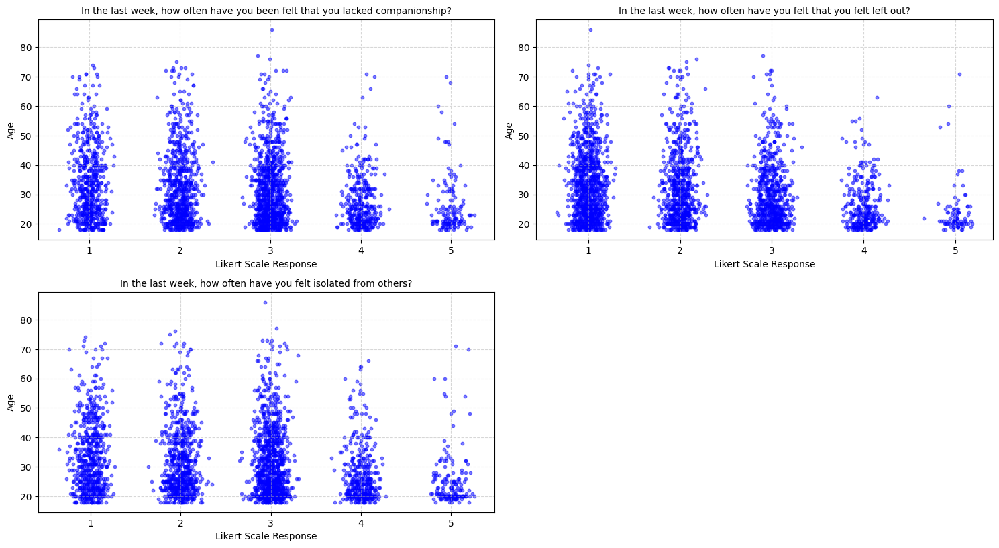

In [98]:
plt.figure(figsize=(15, 20))

for i, column in enumerate(SLON.columns):
    plt.subplot(5, 2, i + 1)

    x = SLON[column] + np.random.normal(0, 0.1, size=SLON.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(labels[i], fontsize=10)
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 6))  # Likert scale ranges from 1 to 5
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## OECD & Trust

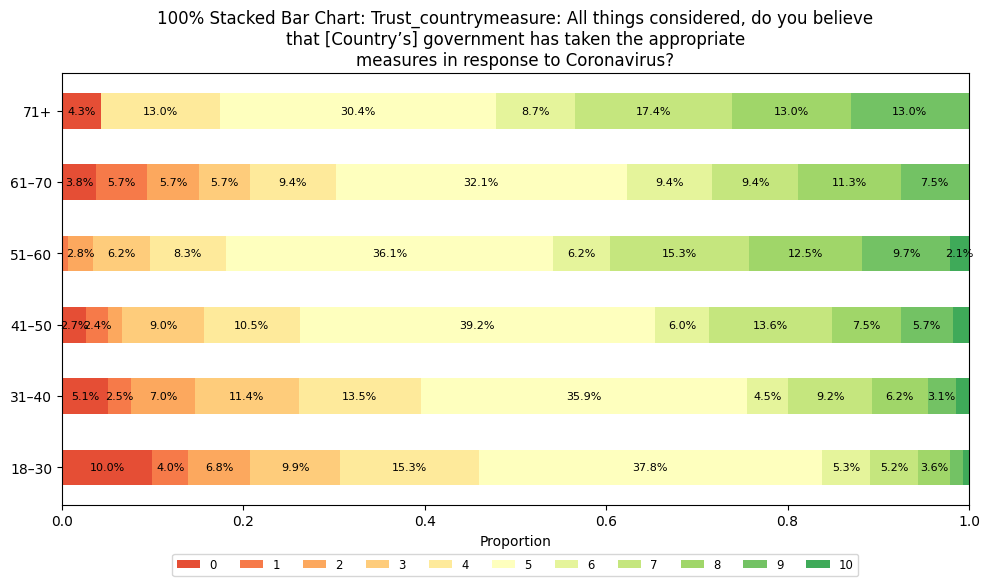

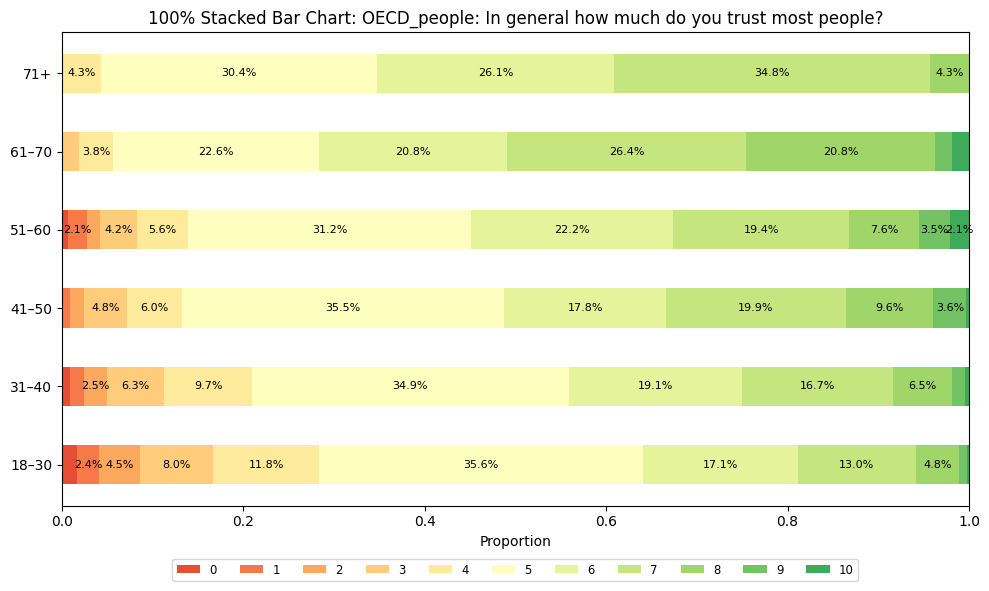

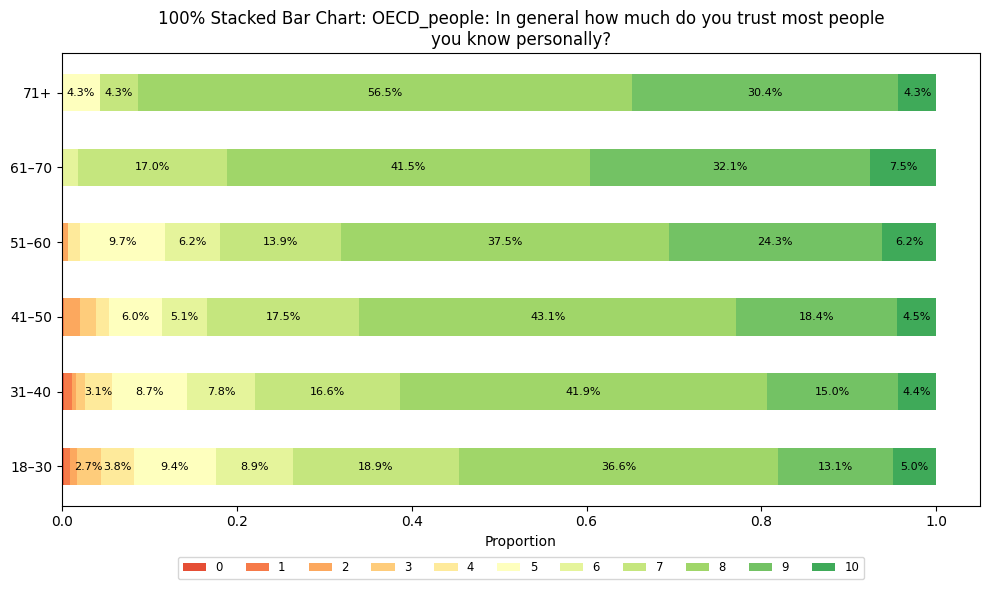

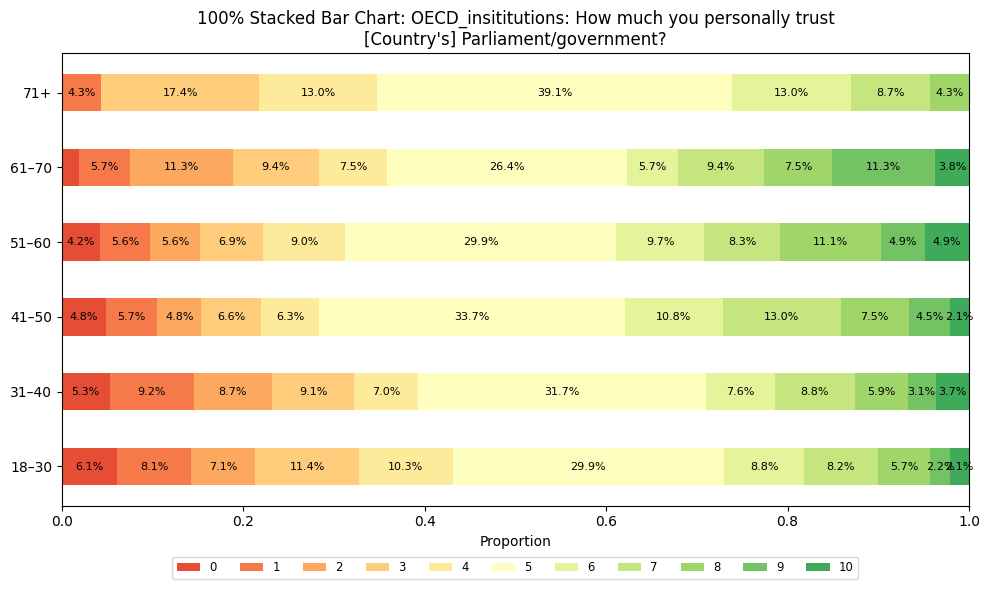

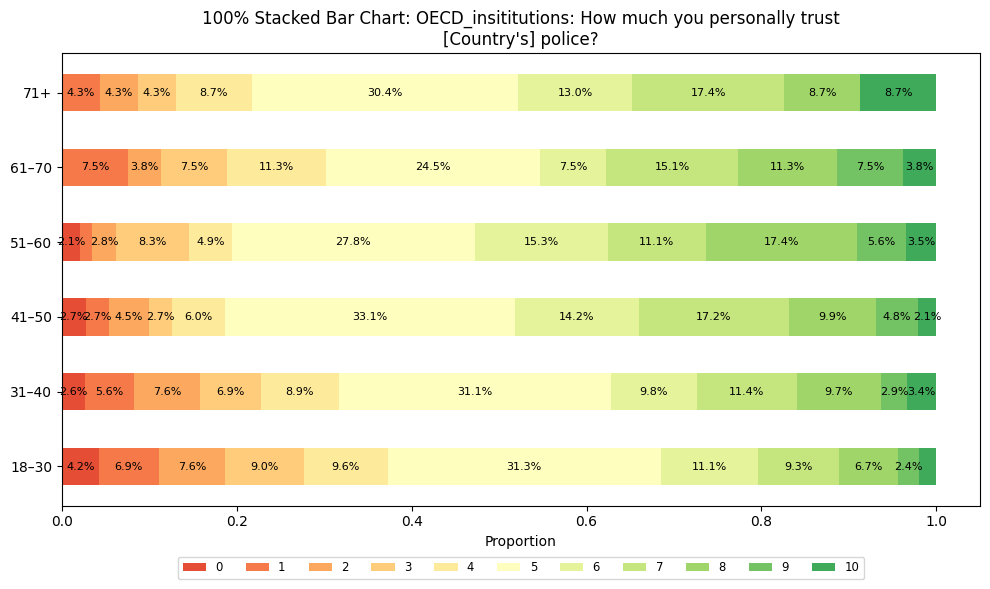

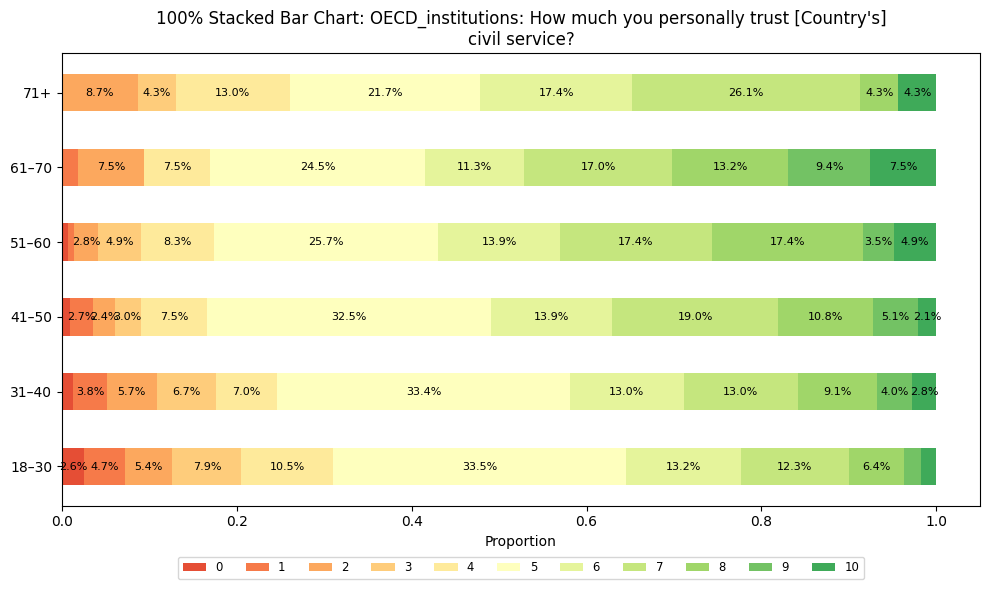

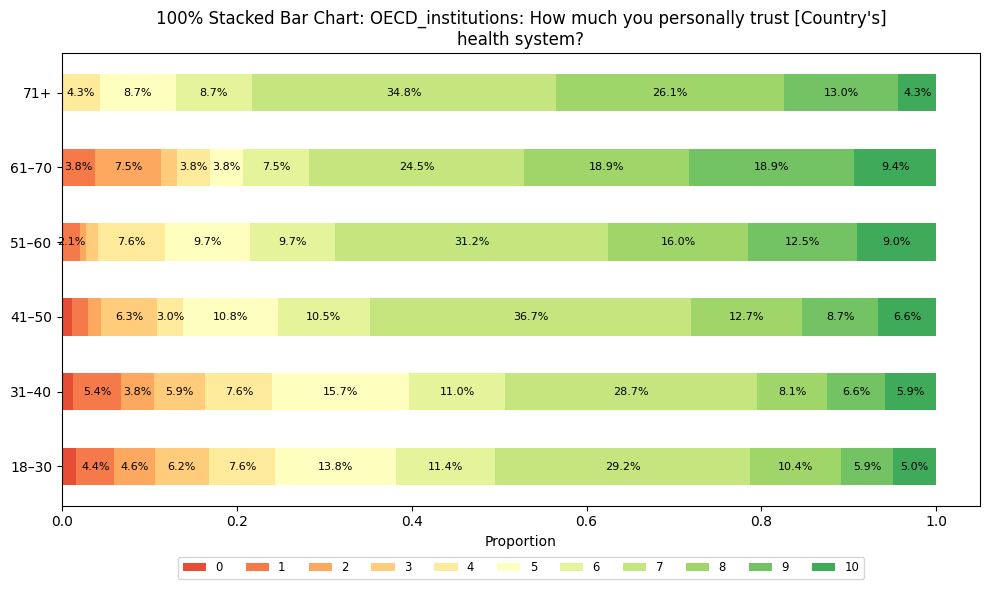

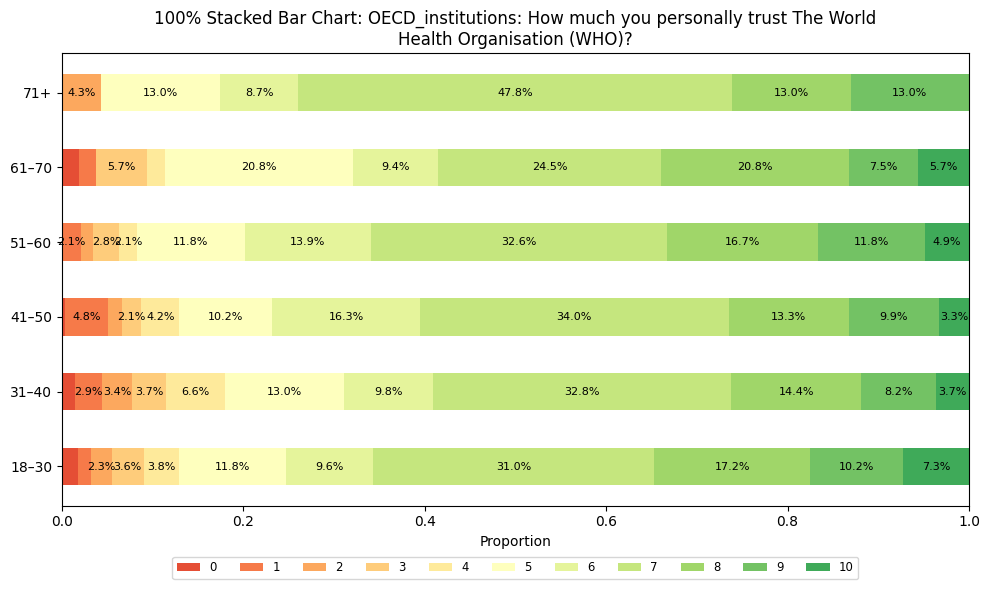

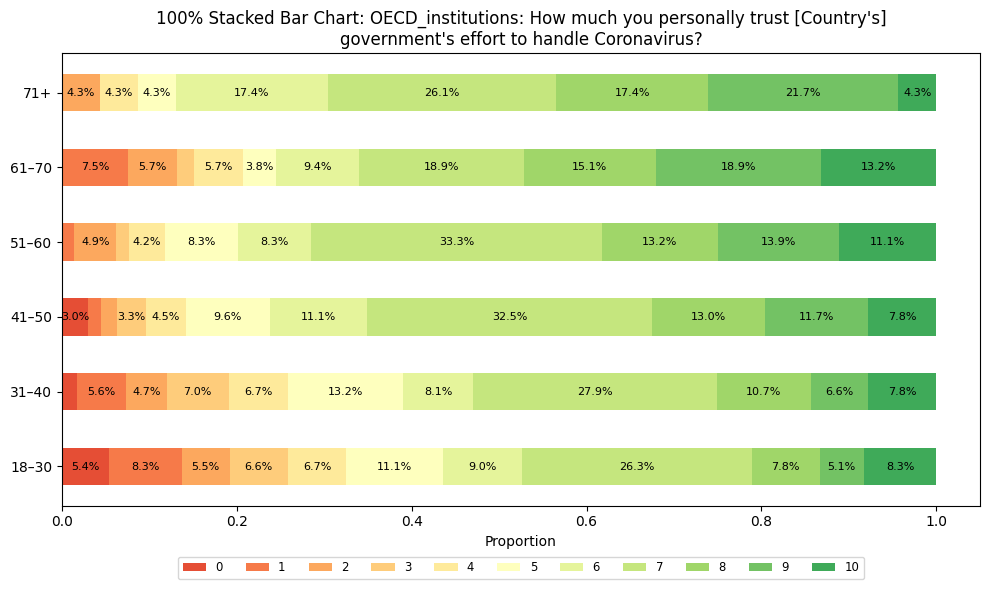

In [99]:
# Keterangan Likert
category_names = ['0', '1', '2', '3', '4','5', '6', '7', '8', '9', '10']

# Pertanyaan survey
labels = [
    "Trust_countrymeasure: All things considered, do you believe that [Country’s] government has taken the appropriate measures in response to Coronavirus?",
    "OECD_people: In general how much do you trust most people?",
    "OECD_people: In general how much do you trust most people you know personally?",
    "OECD_insititutions: How much you personally trust [Country's] Parliament/government?",
    "OECD_insititutions: How much you personally trust [Country's] police?",
    "OECD_institutions: How much you personally trust [Country's] civil service?",
    "OECD_institutions: How much you personally trust [Country's] health system?",
    "OECD_institutions: How much you personally trust The World Health Organisation (WHO)?",
    "OECD_institutions: How much you personally trust [Country's] government's effort to handle Coronavirus?"
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 1%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(OECD.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = OECD.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

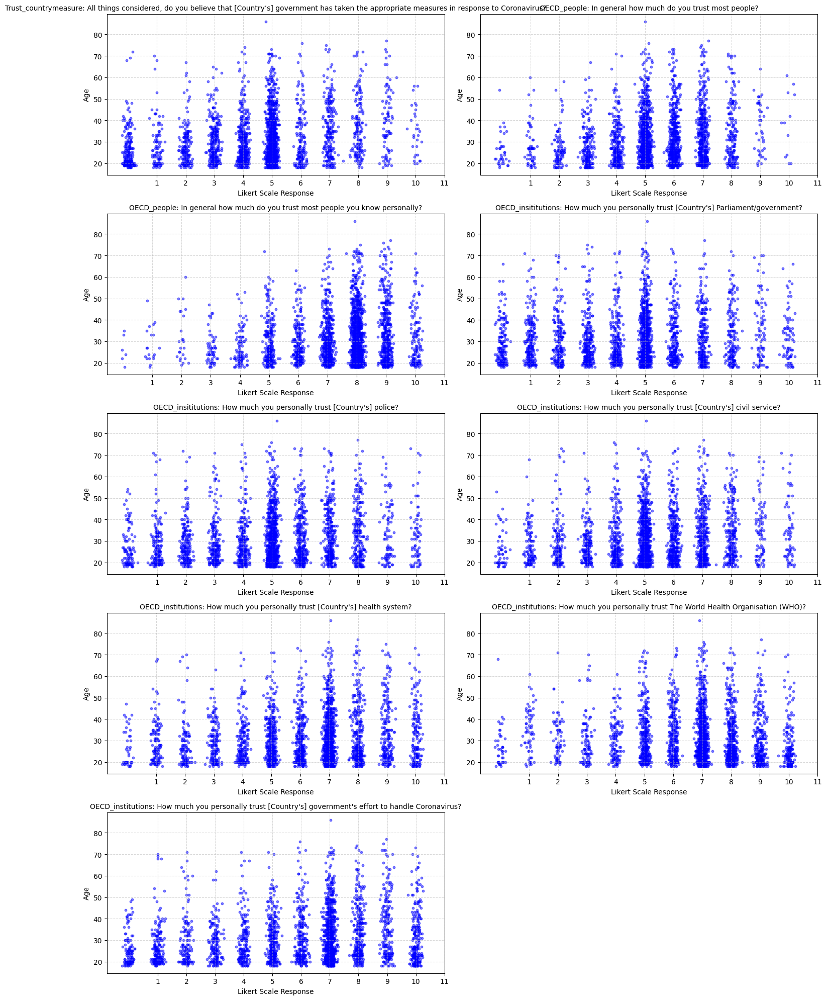

In [100]:
# Define pertanyaan survey
plt.figure(figsize=(15, 20))

for i, column in enumerate(OECD.columns):
    plt.subplot(5, 2, i + 1)

    x = OECD[column] + np.random.normal(0, 0.1, size=OECD.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(labels[i], fontsize=10)
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 12))  # Likert scale ranges from 0 to 10
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## Corona Concerns

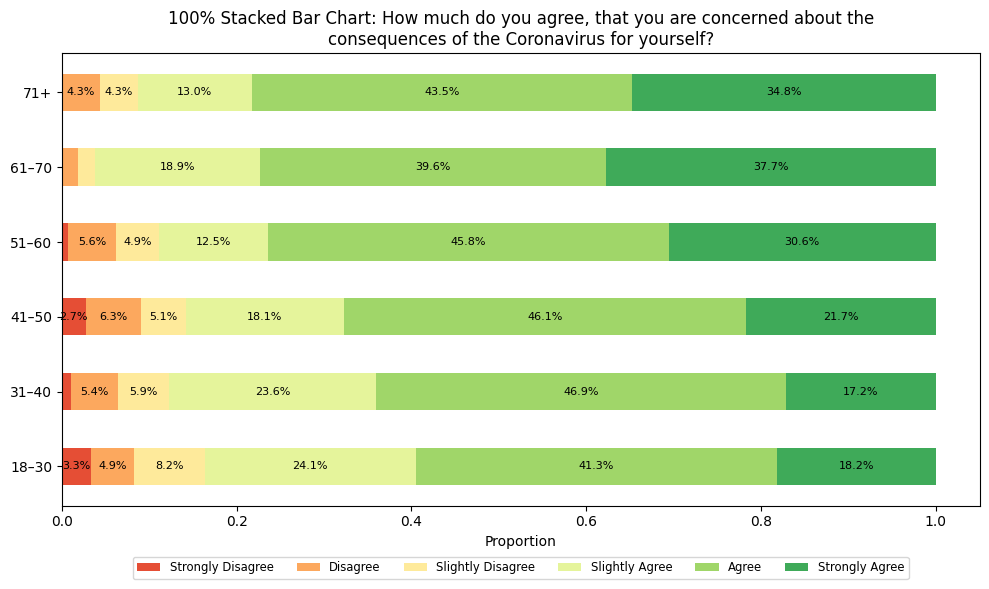

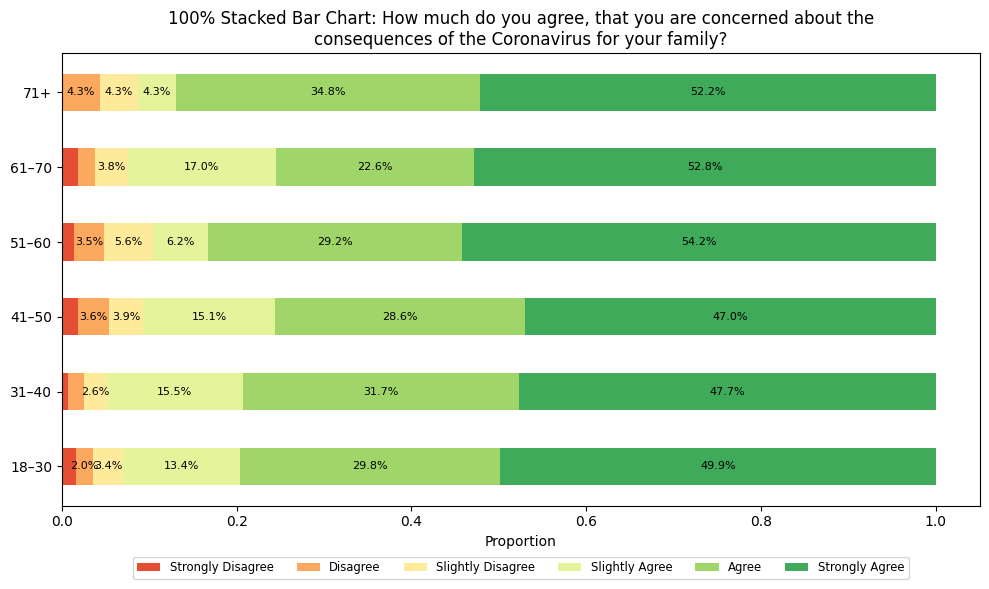

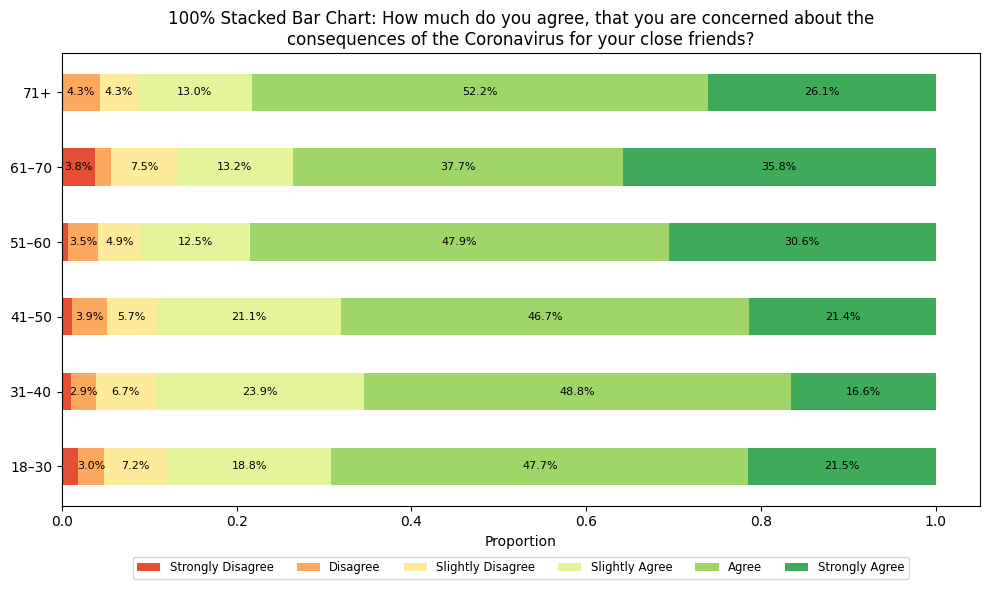

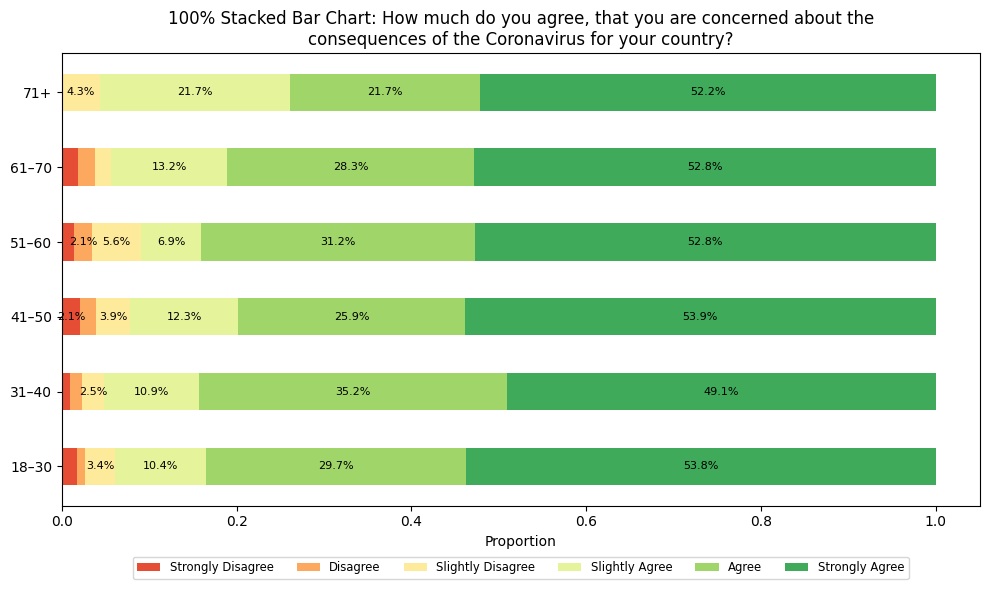

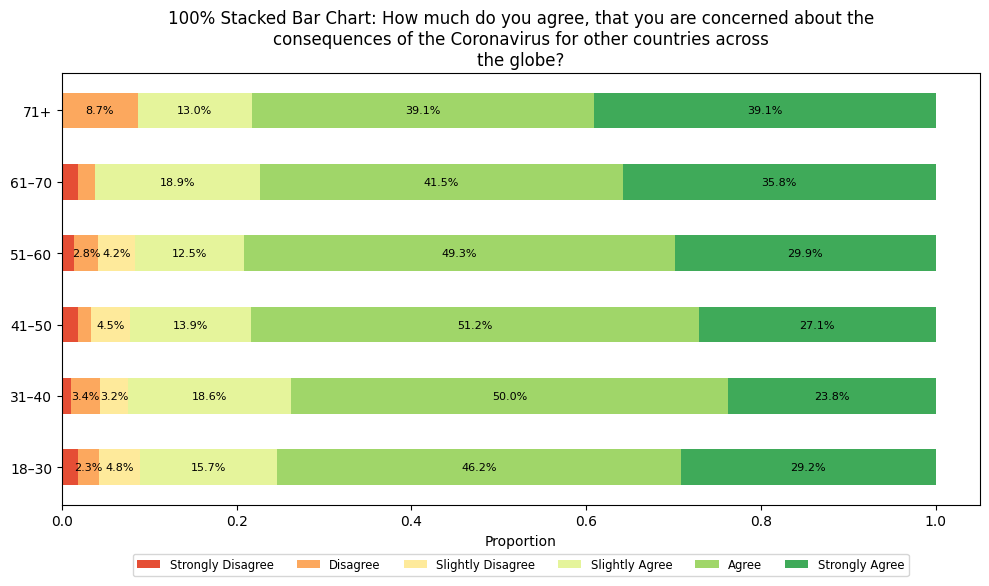

In [101]:
# Keterangan Likert
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Pertanyaan survey
labels = [
    "How much do you agree, that you are concerned about the consequences of the Coronavirus for yourself?",
    "How much do you agree, that you are concerned about the consequences of the Coronavirus for your family?",
    "How much do you agree, that you are concerned about the consequences of the Coronavirus for your close friends?",
    "How much do you agree, that you are concerned about the consequences of the Coronavirus for your country?",
    "How much do you agree, that you are concerned about the consequences of the Coronavirus for other countries across the globe?"
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 1%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(concern.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = concern.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

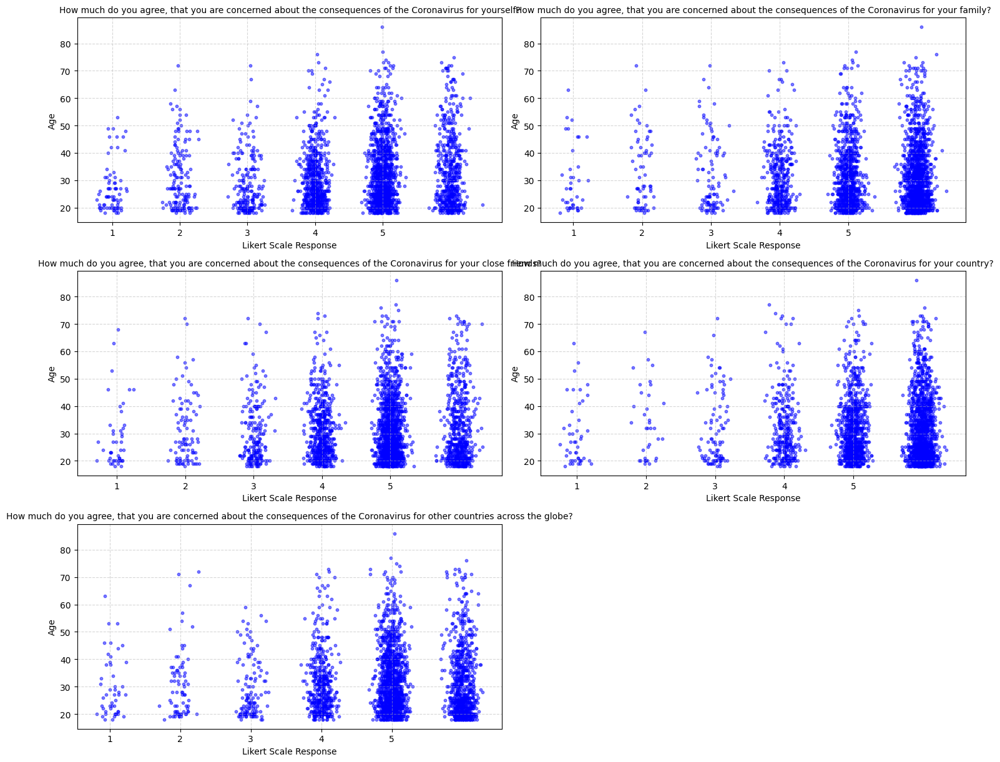

In [102]:
# Define pertanyaan survey
plt.figure(figsize=(15, 20))

for i, column in enumerate(concern.columns):
    plt.subplot(5, 2, i + 1)

    x = concern[column] + np.random.normal(0, 0.1, size=concern.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(labels[i], fontsize=10)
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 6))  # Likert scale ranges from 1 to 5
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

##Compliance

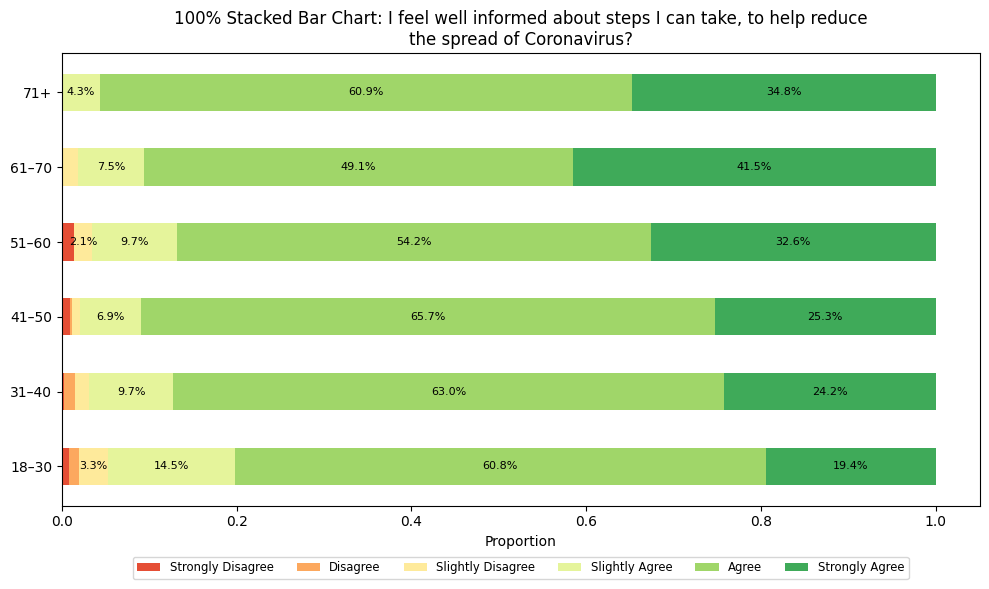

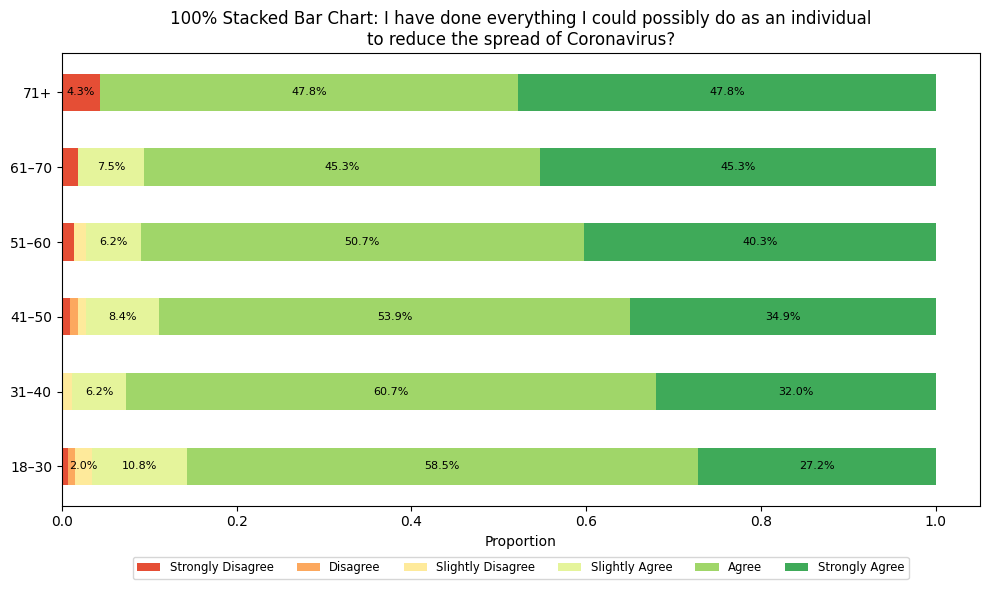

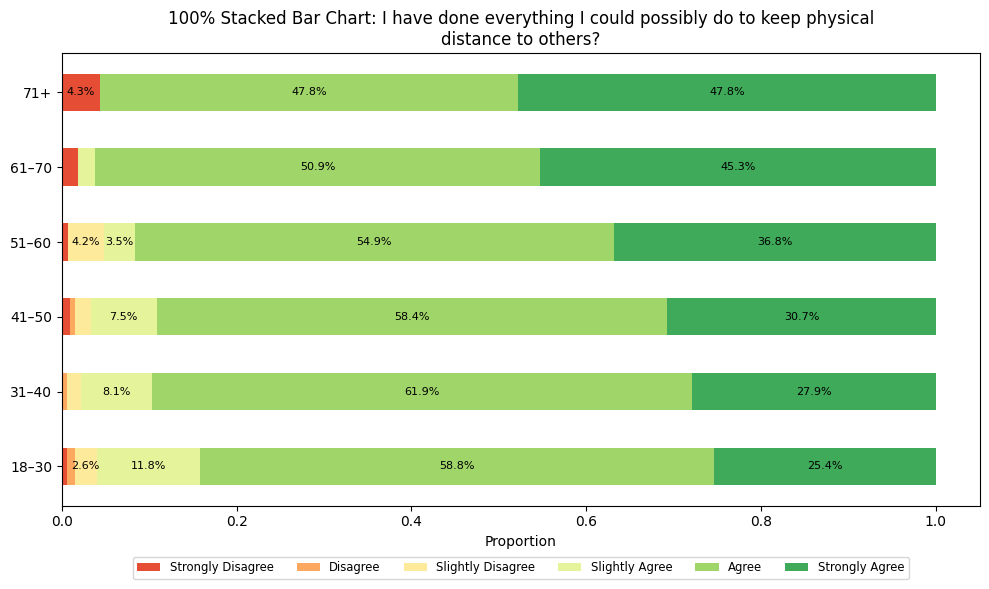

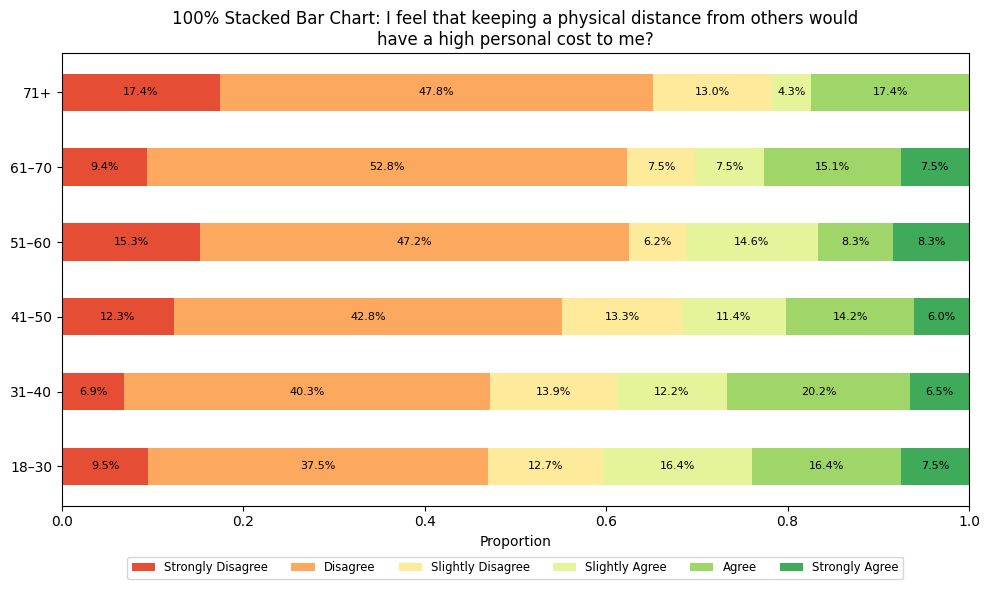

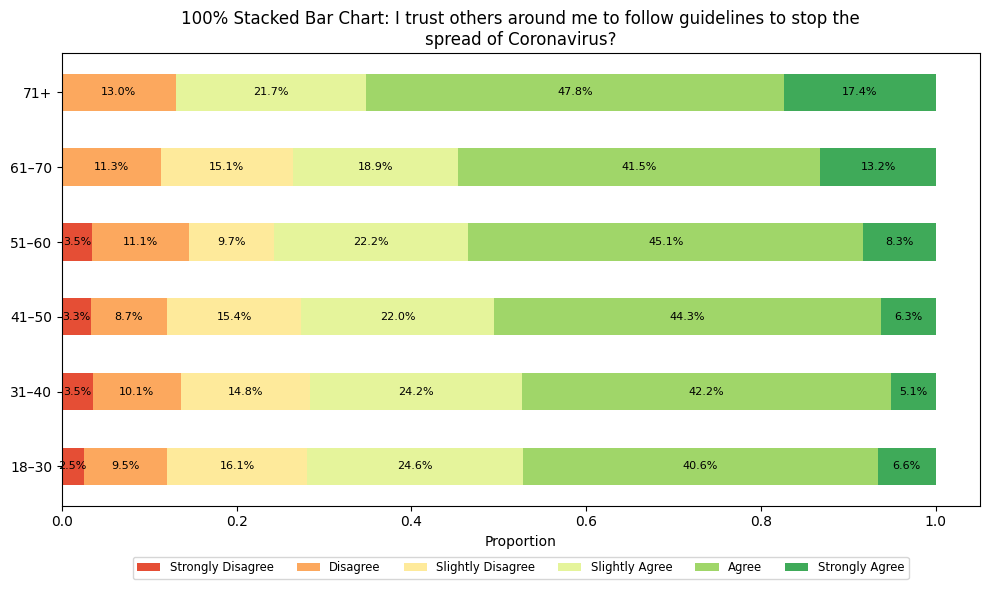

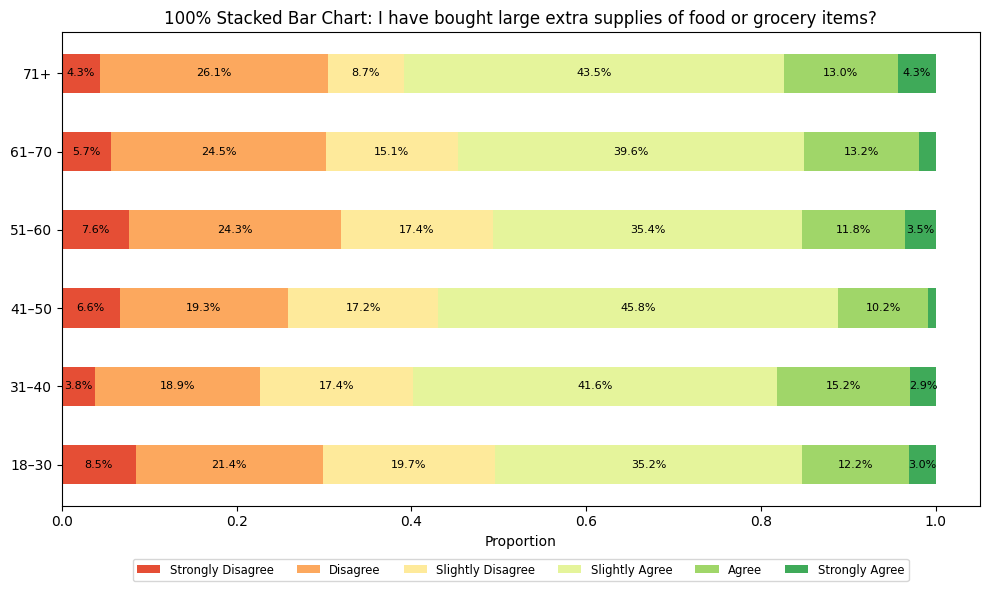

In [103]:
# Keterangan Likert
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Pertanyaan survey
labels = [
    "I feel well informed about steps I can take, to help reduce the spread of Coronavirus?",
    "I have done everything I could possibly do as an individual to reduce the spread of Coronavirus?",
    "I have done everything I could possibly do to keep physical distance to others?",
    "I feel that keeping a physical distance from others would have a high personal cost to me?",
    "I trust others around me to follow guidelines to stop the spread of Coronavirus?",
    "I have bought large extra supplies of food or grocery items?"
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 1%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(compliance.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = compliance.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

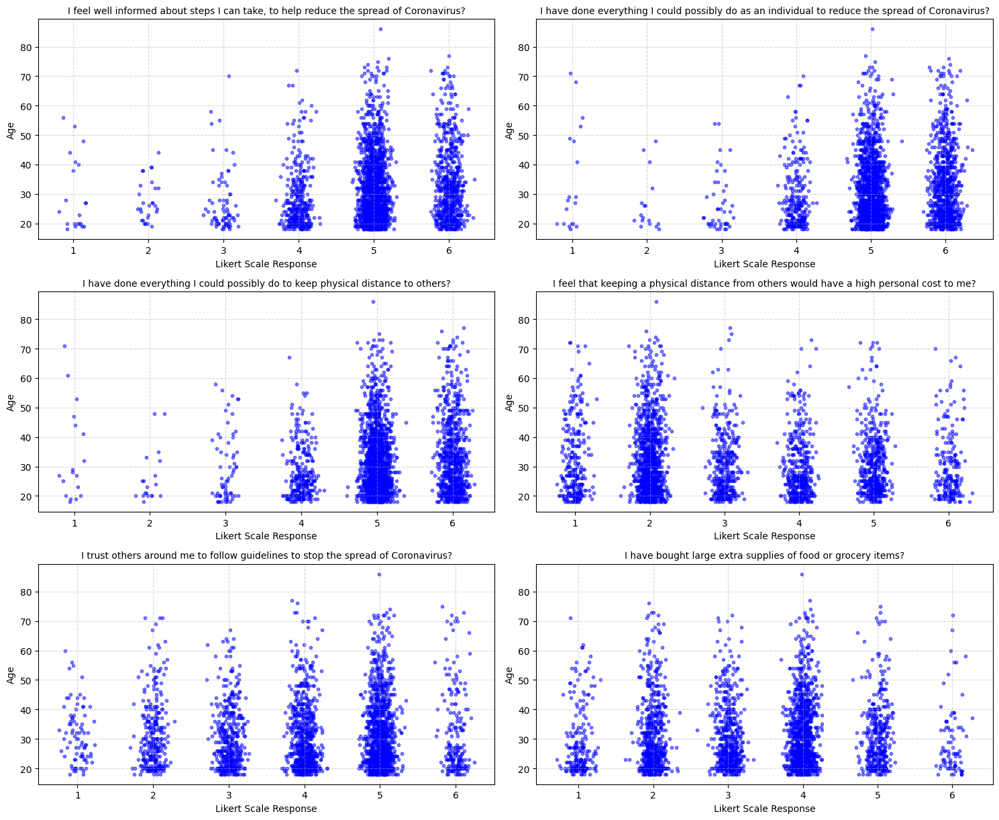

In [104]:
# Membuat Scatter plots with jittering
plt.figure(figsize=(15, 20))

for i, column in enumerate(compliance.columns):
    plt.subplot(5, 2, i + 1)

    x = compliance[column] + np.random.normal(0, 0.1, size=compliance.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(labels[i], fontsize=10)
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 7))  # Likert scale ranges from 1 to 6
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## BFF

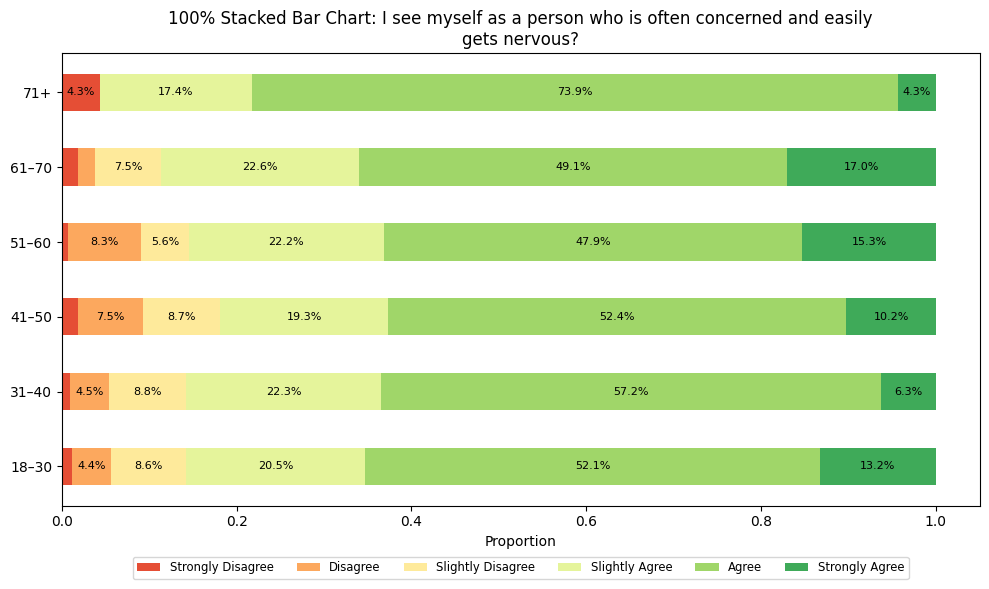

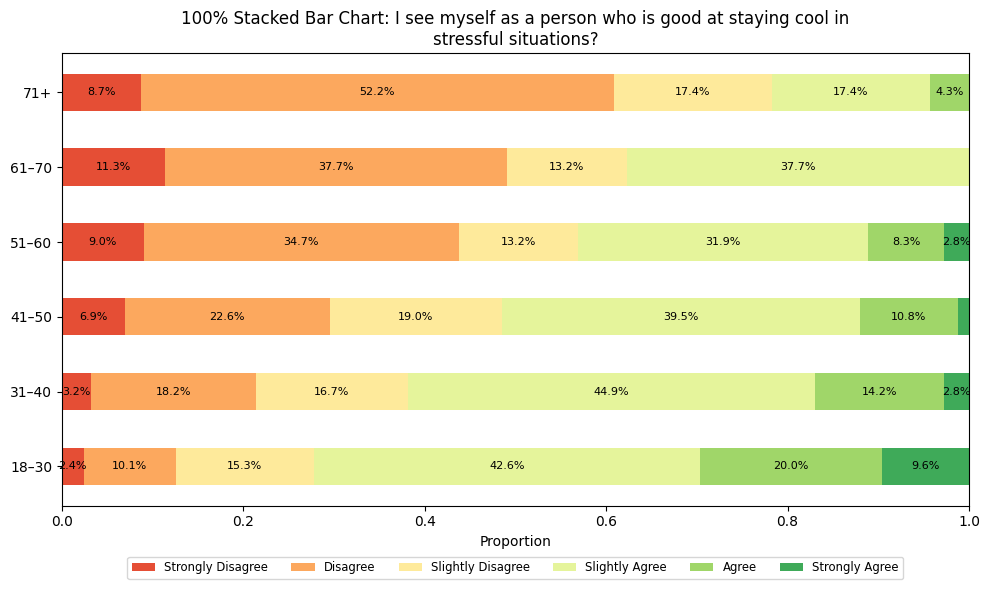

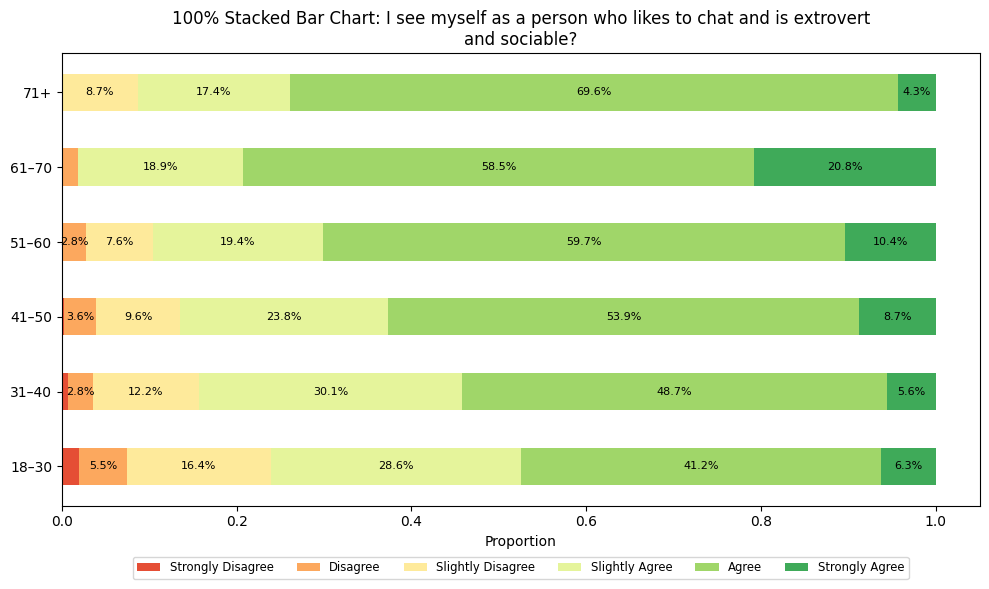

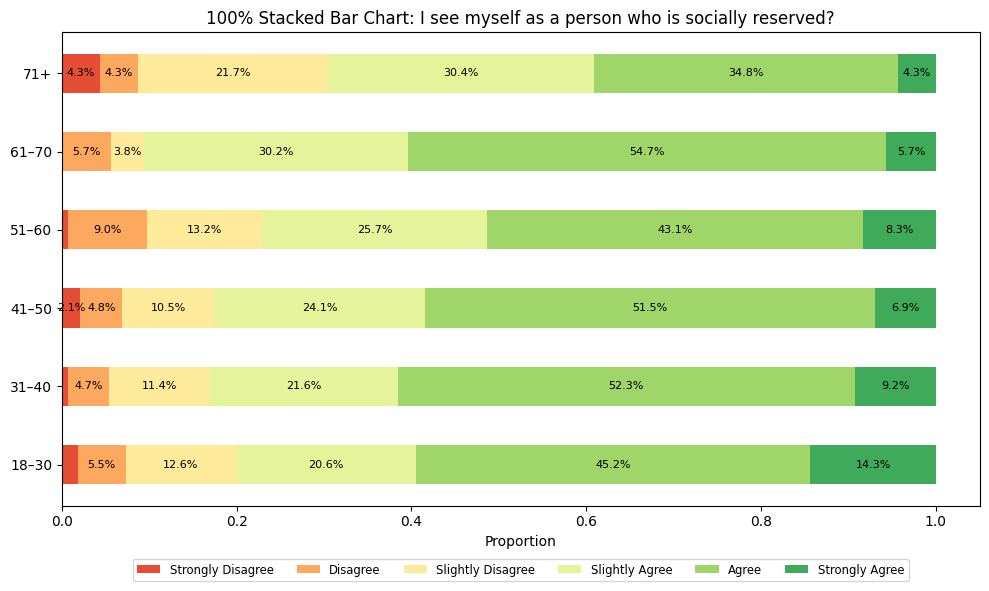

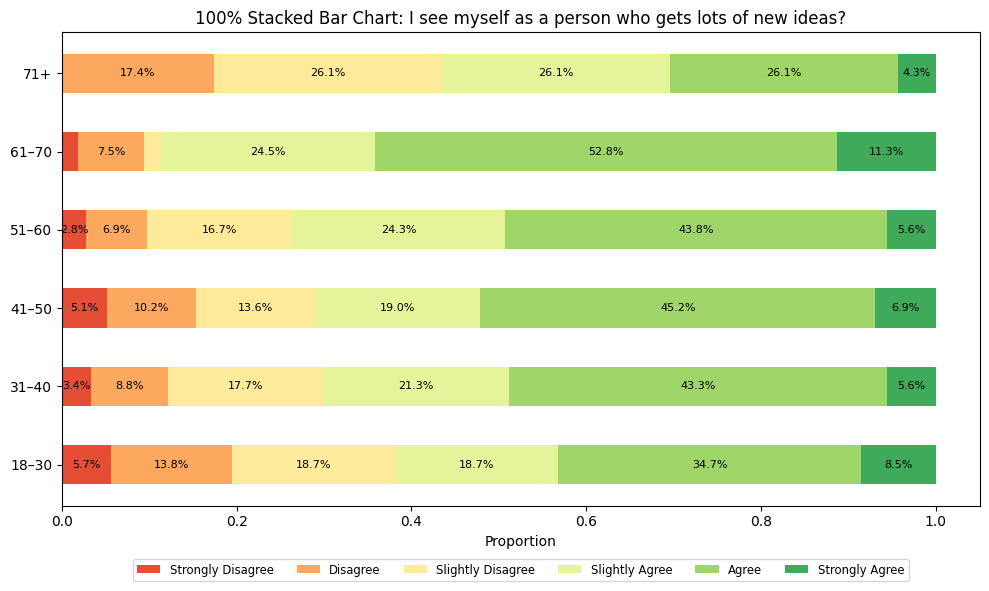

...

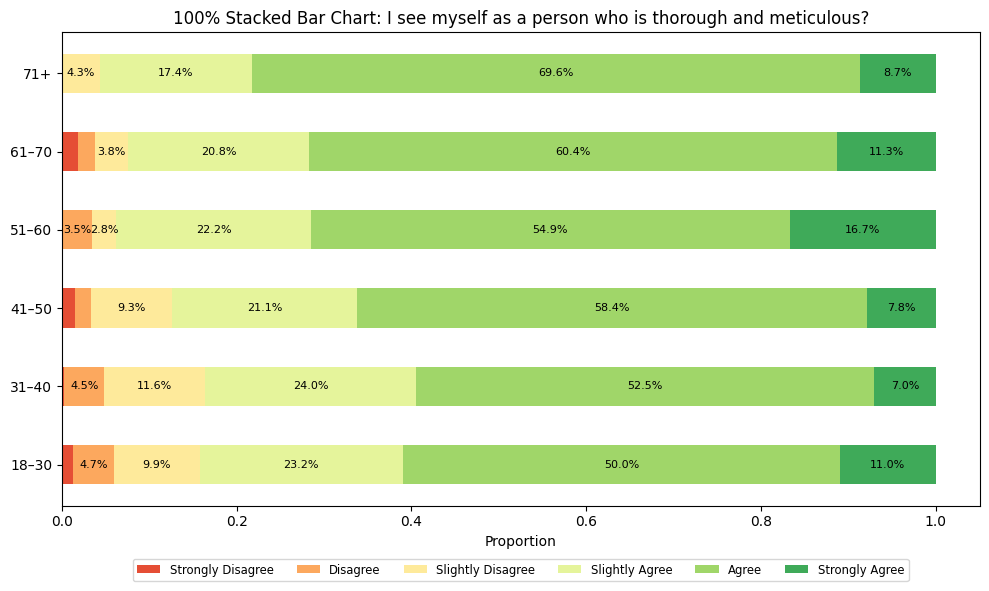

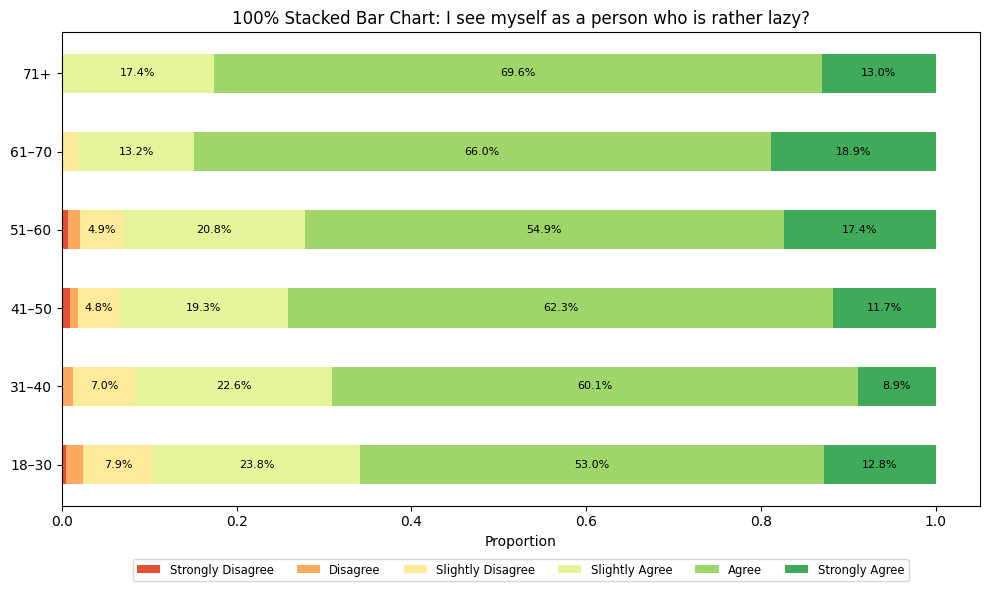

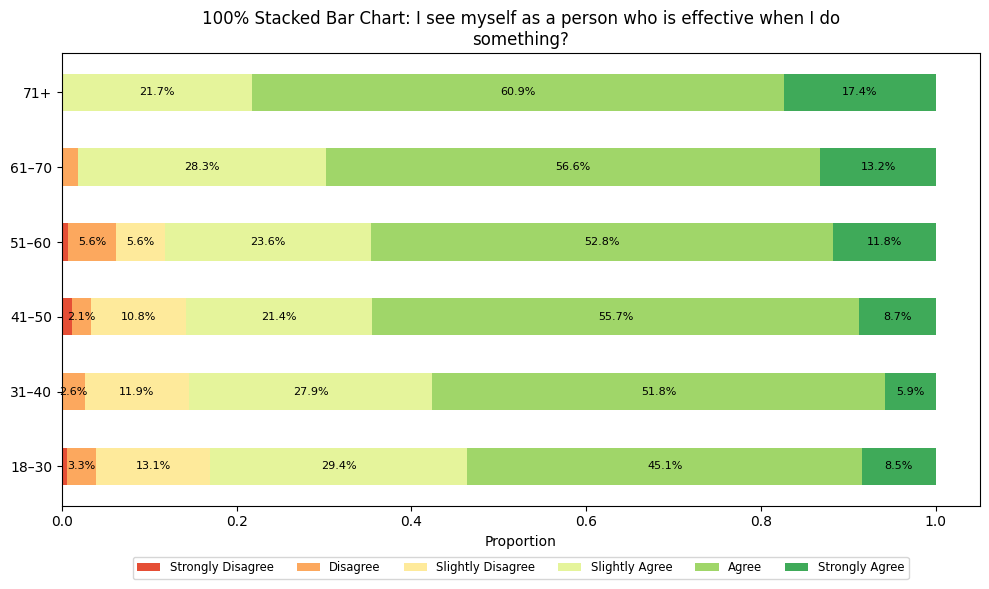

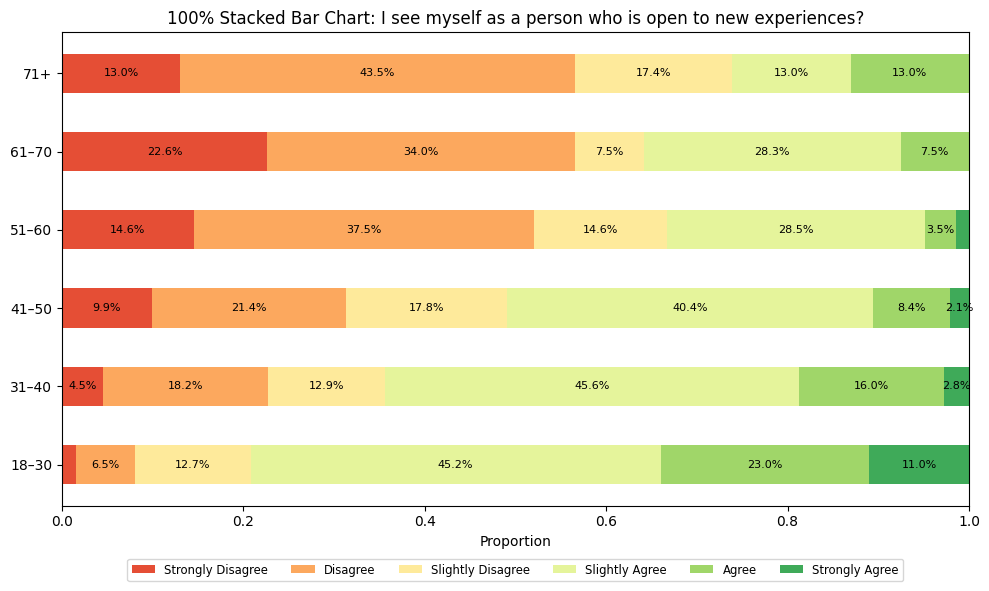

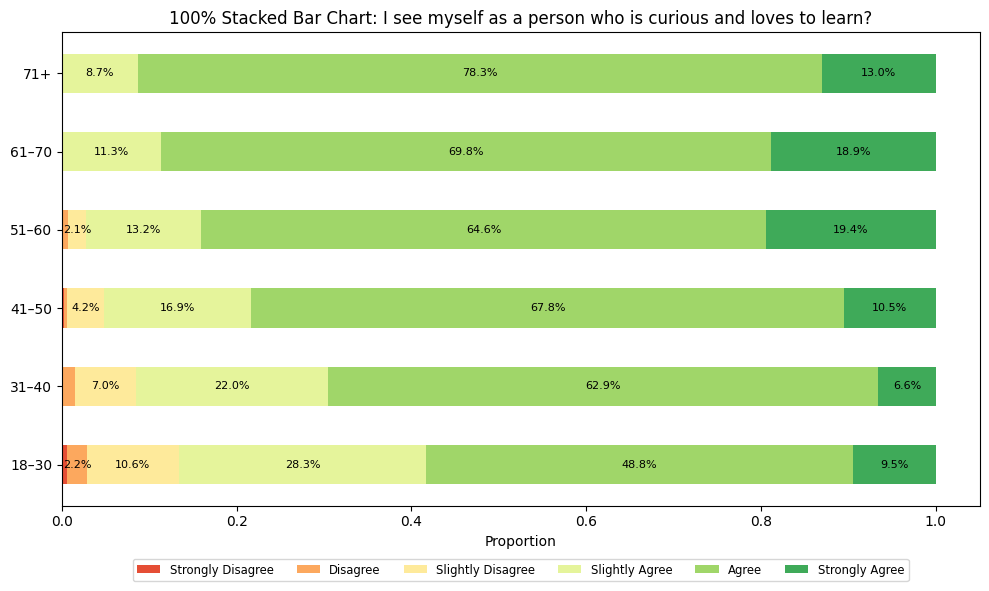

In [105]:
# Keterangan Likert
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Pertanyaan survey
labels = [
    "I see myself as a person who is often concerned and easily gets nervous?",
    "I see myself as a person who is good at staying cool in stressful situations?",
    "I see myself as a person who likes to chat and is extrovert and sociable?",
    "I see myself as a person who is socially reserved?",
    "I see myself as a person who gets lots of new ideas?",
    "I see myself as a person who appreciates art and aesthetics?",
    "I see myself as a person who has a vivid imagination and can think of things that do not yet exist?",
    "I see myself as a person who is sometimes impolite to others?",
    "I see myself as a person who is forgiving towards others?",
    "I see myself as a person who is kind and considerate towards almost everyone?",
    "I see myself as a person who is thorough and meticulous?",
    "I see myself as a person who is rather lazy?",
    "I see myself as a person who is effective when I do something?",
    "I see myself as a person who is open to new experiences?",
    "I see myself as a person who is curious and loves to learn?"
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 1%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(BFF.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = BFF.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

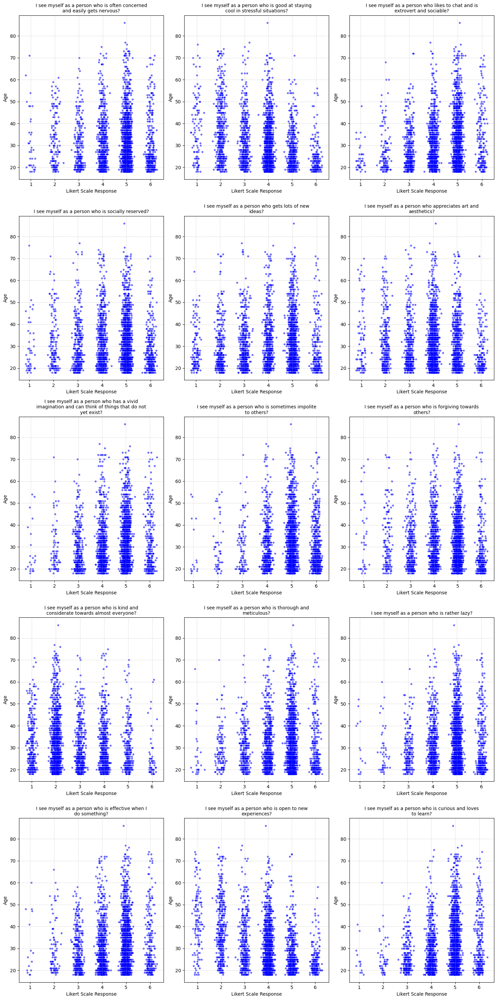

In [106]:
# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Membuat Scatter plots with jittering
plt.figure(figsize=(15, 30))

# Membungkus label pertanyaan agar tidak terlalu panjang
wrapped_labels = wrap_labels(labels, width=50)

for i, column in enumerate(BFF.columns):
    plt.subplot(5, 3, i + 1)

    x = BFF[column] + np.random.normal(0, 0.1, size=BFF.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(wrapped_labels[i], fontsize=10)  # Menggunakan wrapped label
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 7))  # Likert scale ranges from 1 to 6
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## Distress

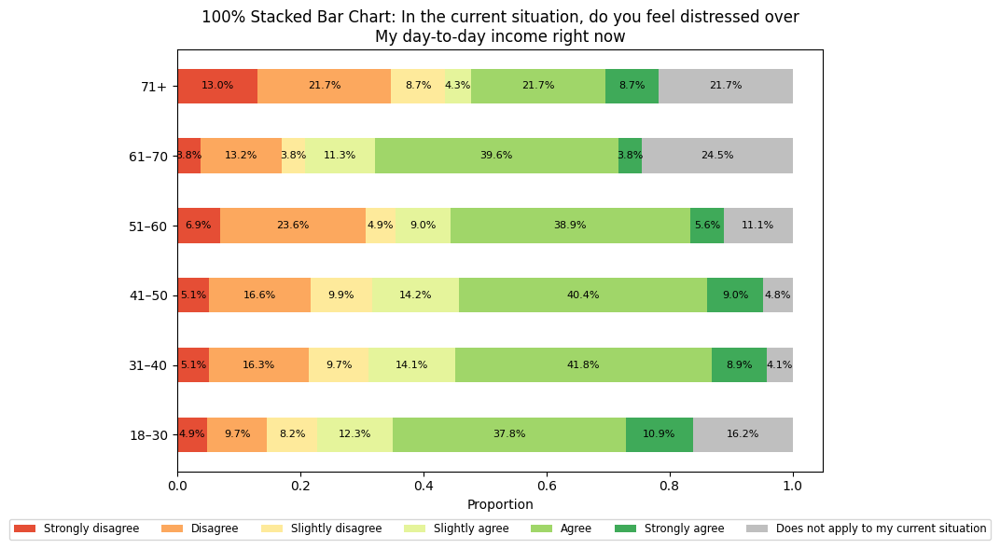

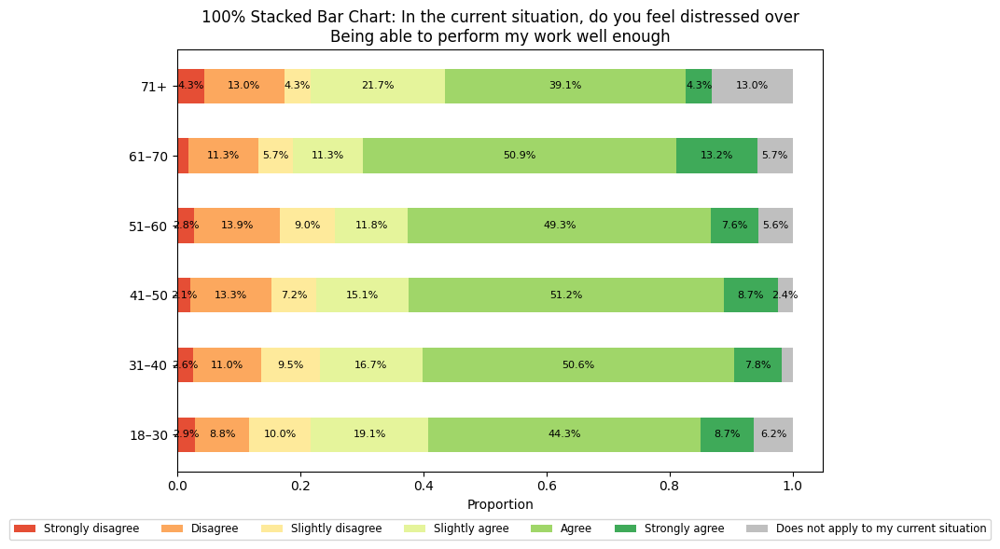

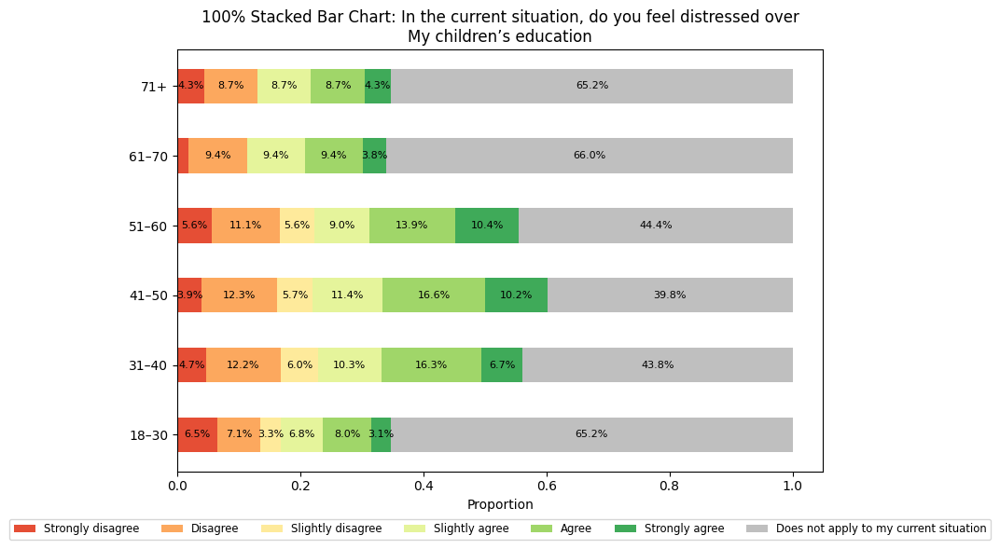

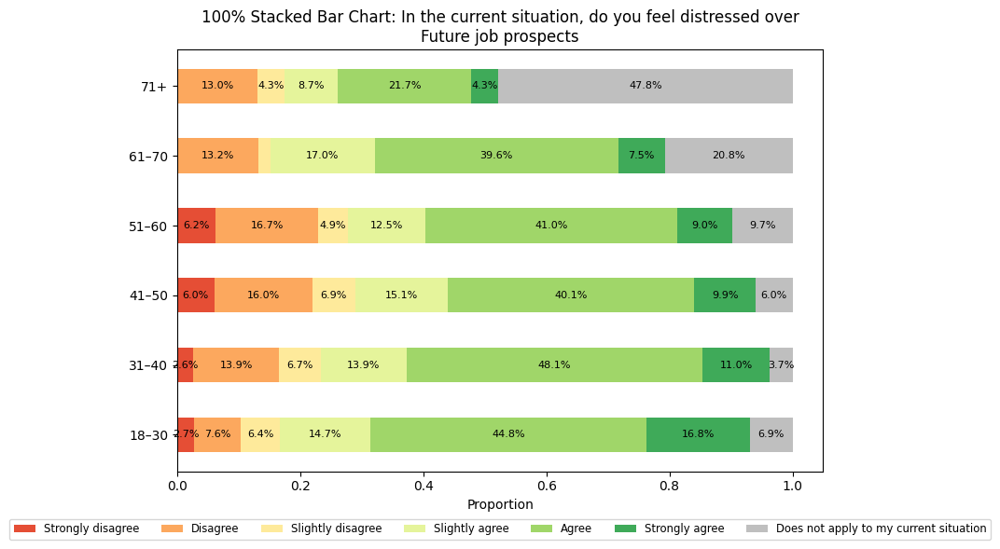

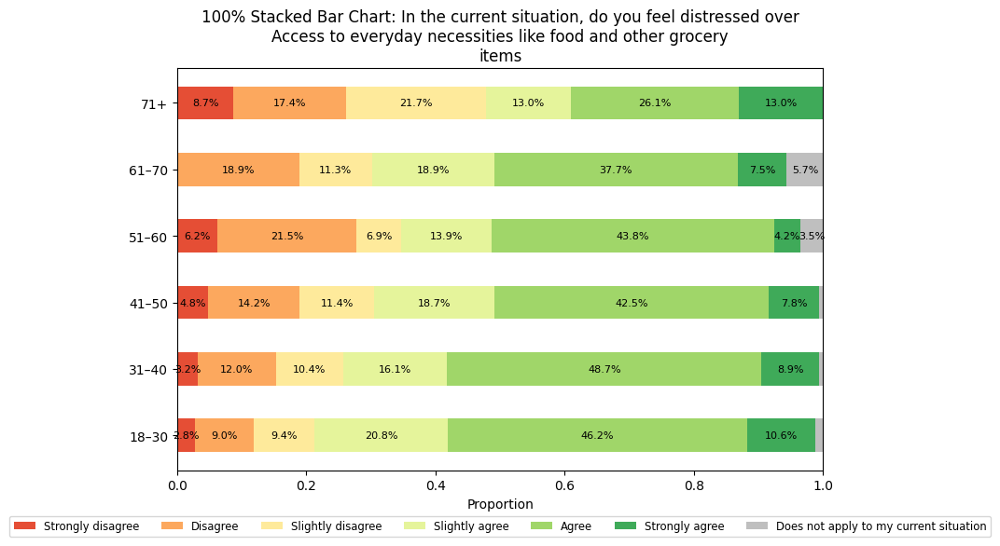

...

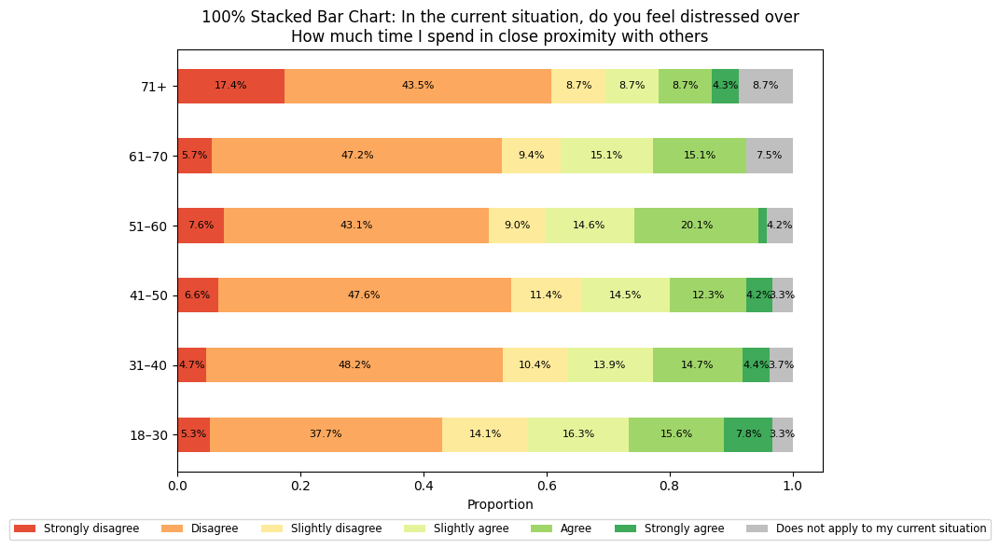

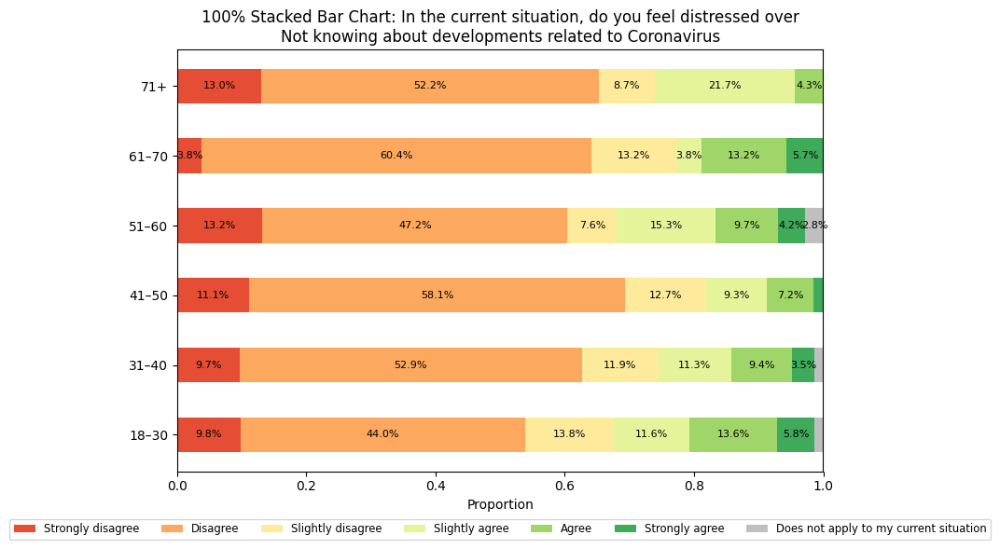

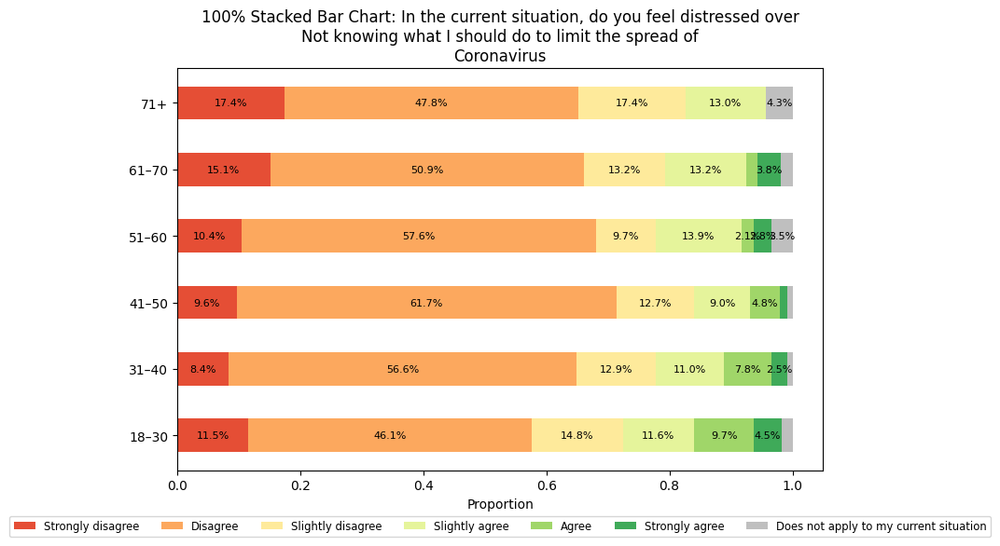

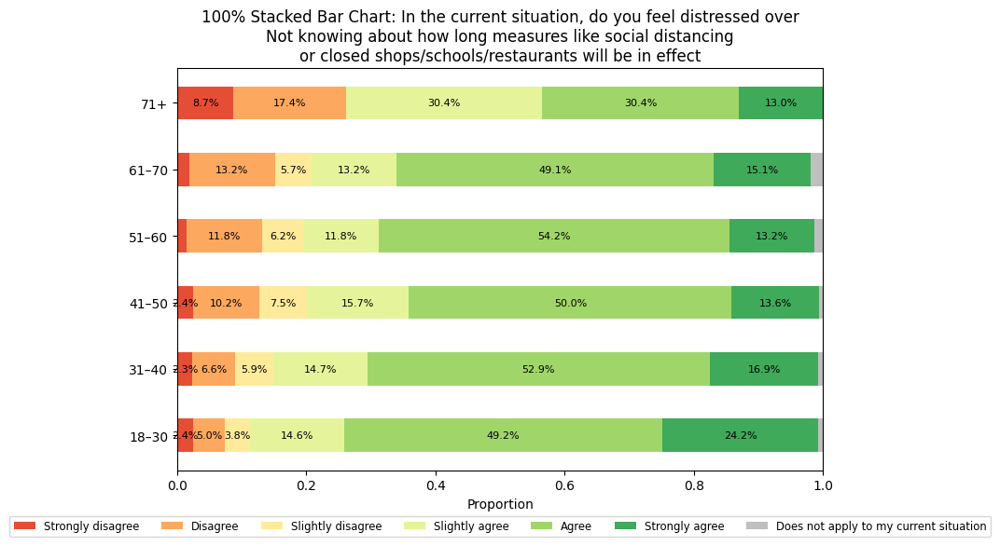

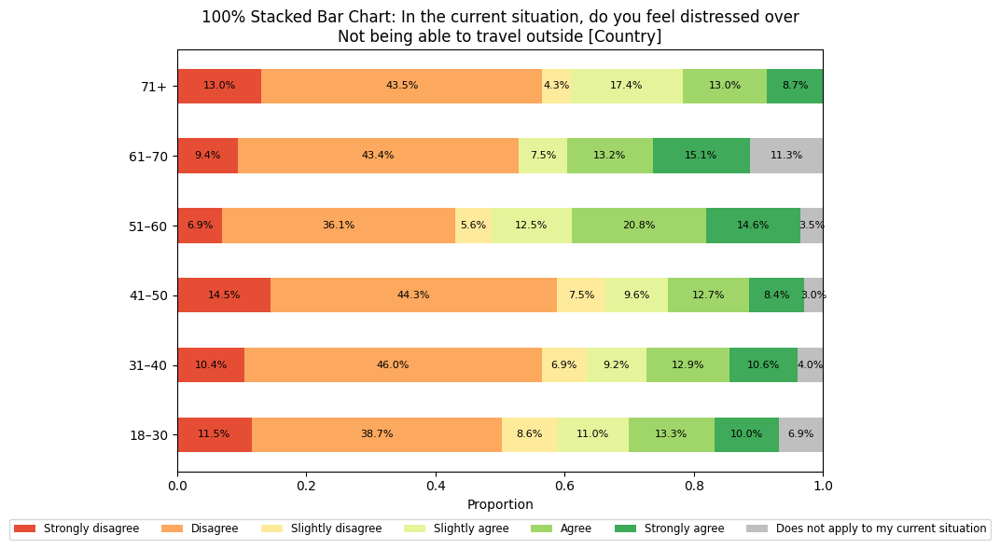

In [107]:
# Keterangan Likert
category_names = ["Strongly disagree",
    "Disagree",
    "Slightly disagree",
    "Slightly agree",
    "Agree",
    "Strongly agree",
    "Does not apply to my current situation"]
# Pertanyaan survey
labels = [
    "My day-to-day income right now",
    "Being able to perform my work well enough",
    "My children’s education",
    "Future job prospects",
    "Access to everyday necessities like food and other grocery items",
    "Not being able to take part in social activities and occasions",
    "Not being able to take part in religious activities",
    "Coping with the behavior of adults who I am in isolation with",
    "Coping with the behavior of children under 12 who I am in isolation with",
    "The national economy",
    "Civil services like police, sanitation, etc.",
    "The risk of myself or others I know catching Coronavirus",
    "The risk of myself or others I know getting hospitalized or dying from Coronavirus",
    "Worry over friends or relatives, who live far away",
    "Having to adapt my work to digital platforms",
    "Having to adapt my social life to digital platforms",
    "Feeling ashamed acting differently towards other people (e.g. at work, if out shopping)",
    "Loneliness",
    "How much time I spend inside",
    "How much time I spend in close proximity with others",
    "Not knowing about developments related to Coronavirus",
    "Not knowing what I should do to limit the spread of Coronavirus",
    "Not knowing about how long measures like social distancing or closed shops/schools/restaurants will be in effect",
    "Not being able to travel outside [Country]"
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)

    # Buat warna untuk kategori lainnya dengan skema warna RdYlGn
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, len(category_names) - 1))

    # Tambahkan warna netral (abu-abu) untuk kategori "Does not apply to my current situation"
    neutral_color = np.array([[0.75, 0.75, 0.75, 1.0]])  # Warna abu-abu (R, G, B, Alpha)
    category_colors = np.vstack([category_colors, neutral_color])

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 2%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: In the current situation, do you feel distressed over\n{question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(distress.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = distress.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6, 7]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

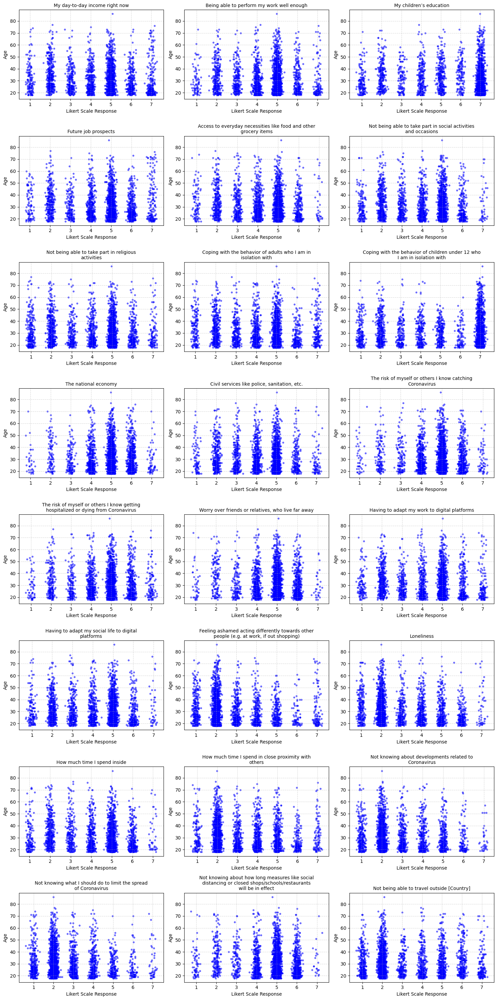

In [108]:
# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Membuat Scatter plots with jittering
plt.figure(figsize=(15, 30))

# Membungkus label pertanyaan agar tidak terlalu panjang
wrapped_labels = wrap_labels(labels, width=50)

# Menghitung jumlah kolom dan baris secara dinamis
num_columns = 3
num_rows = math.ceil(len(distress.columns) / num_columns)

for i, column in enumerate(distress.columns):
    plt.subplot(num_rows, num_columns, i + 1)

    x = distress[column] + np.random.normal(0, 0.1, size=distress.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(wrapped_labels[i], fontsize=10)  # Menggunakan wrapped label
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 8))  # Likert scale ranges from 1 to 7
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## SPS

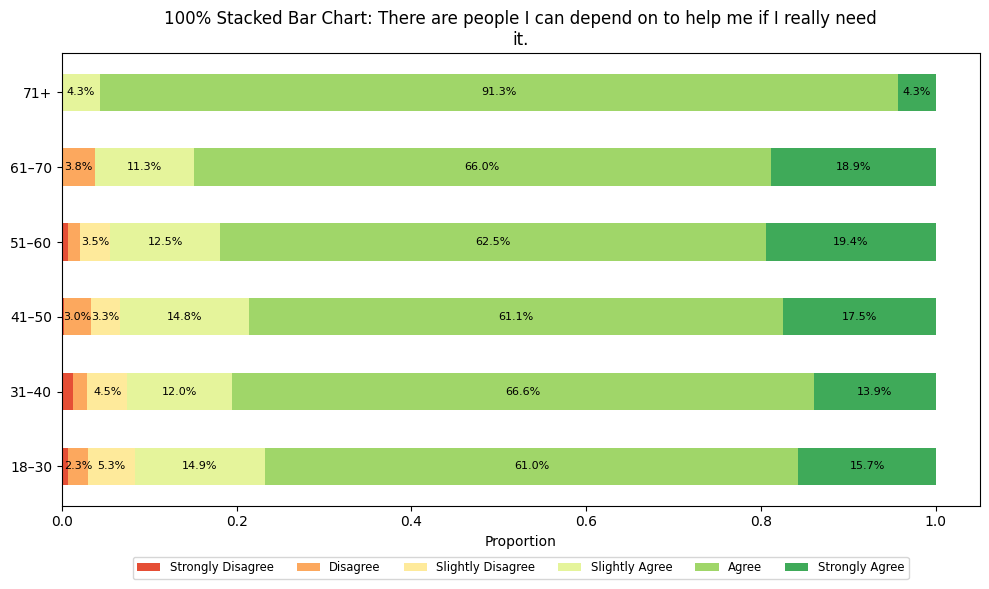

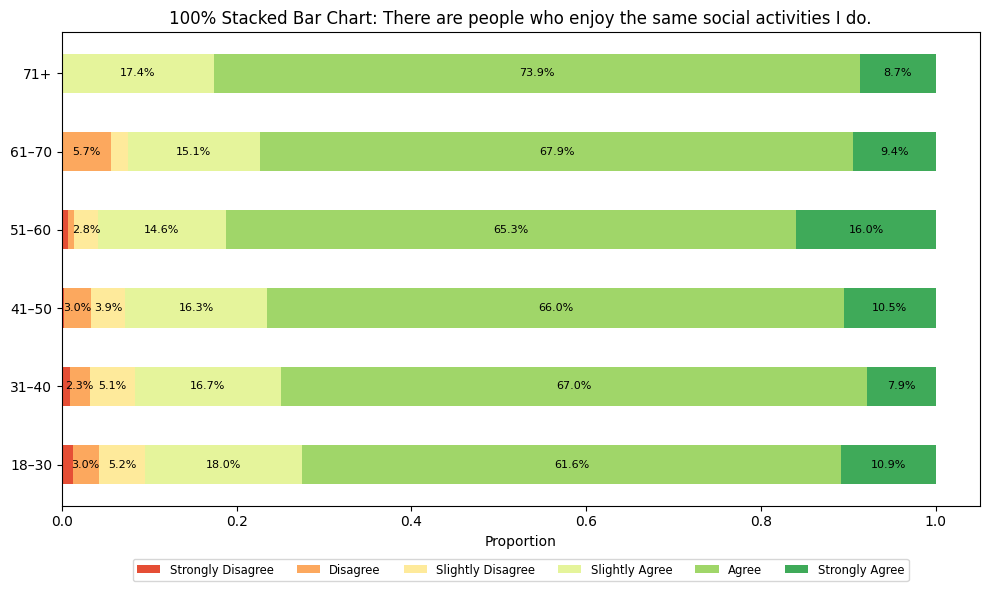

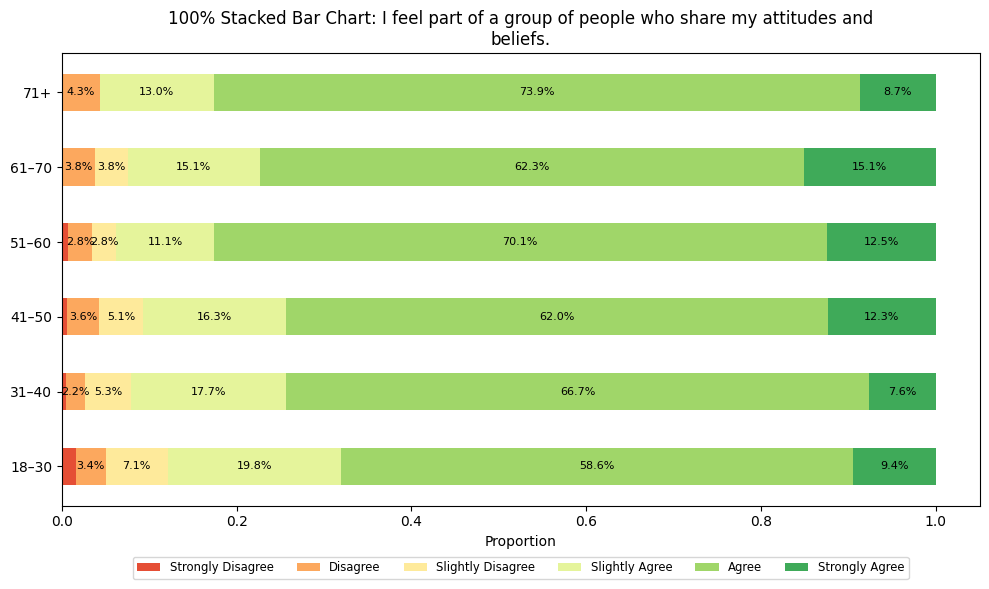

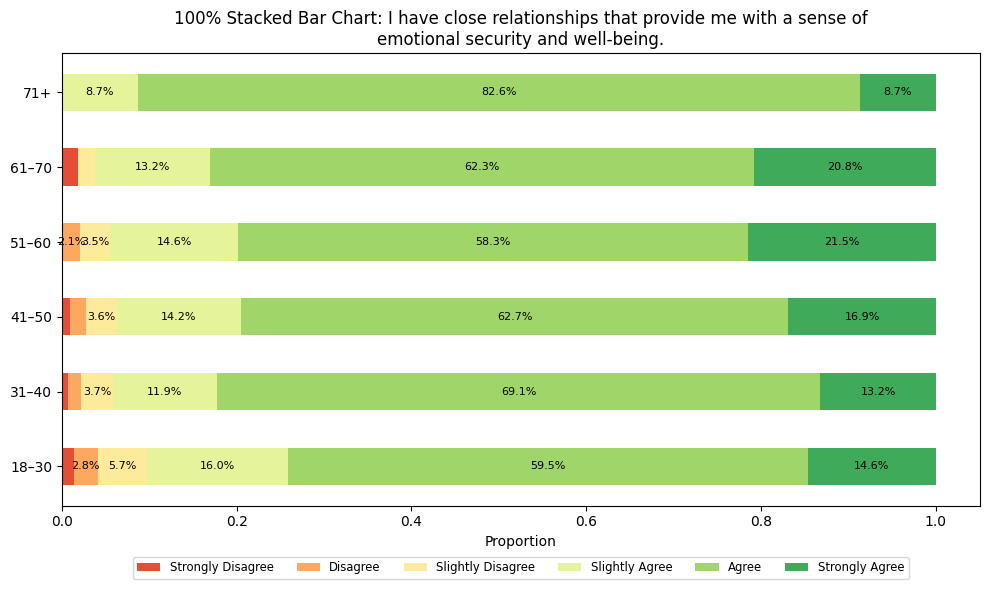

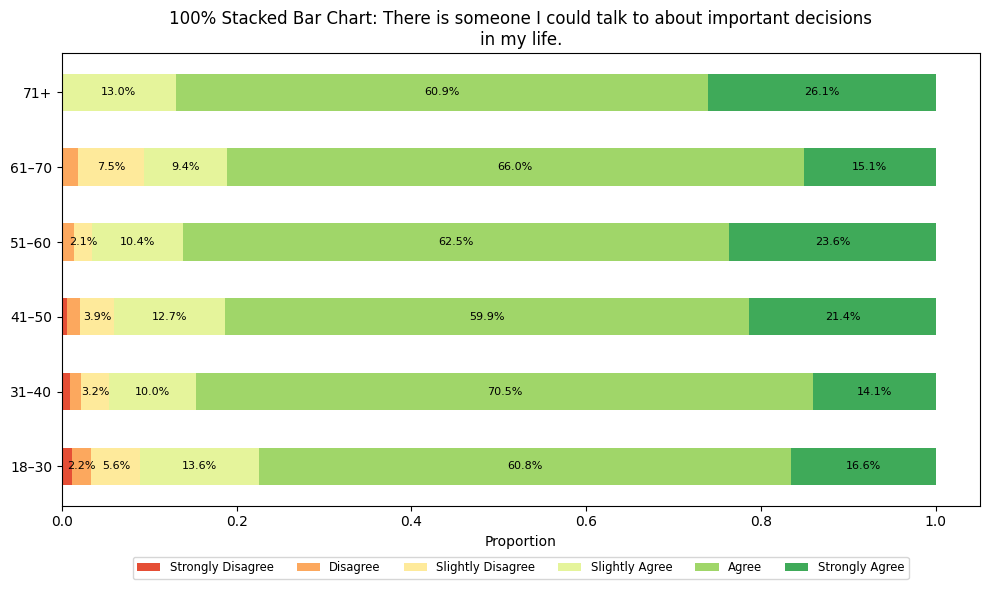

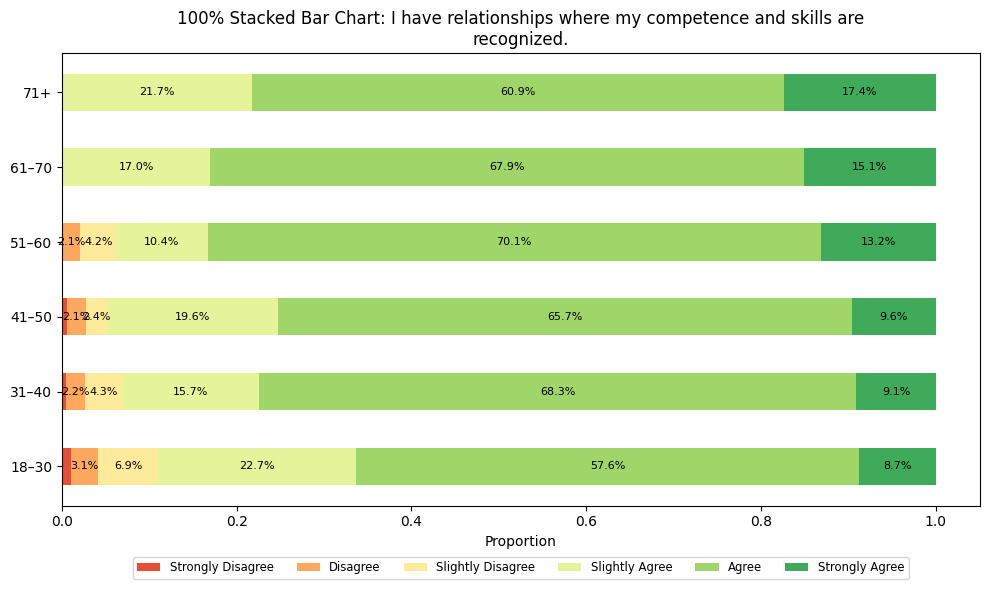

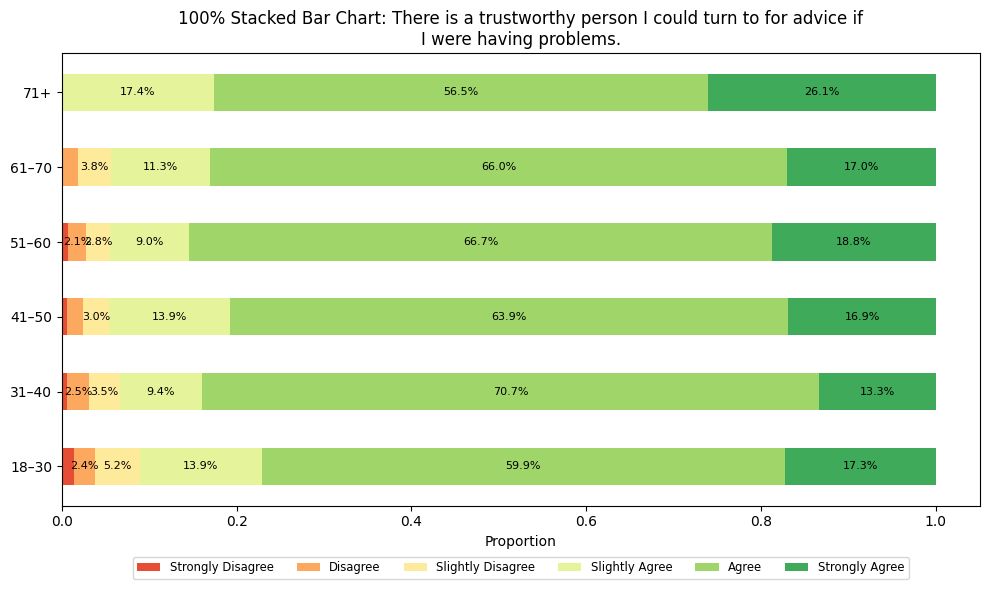

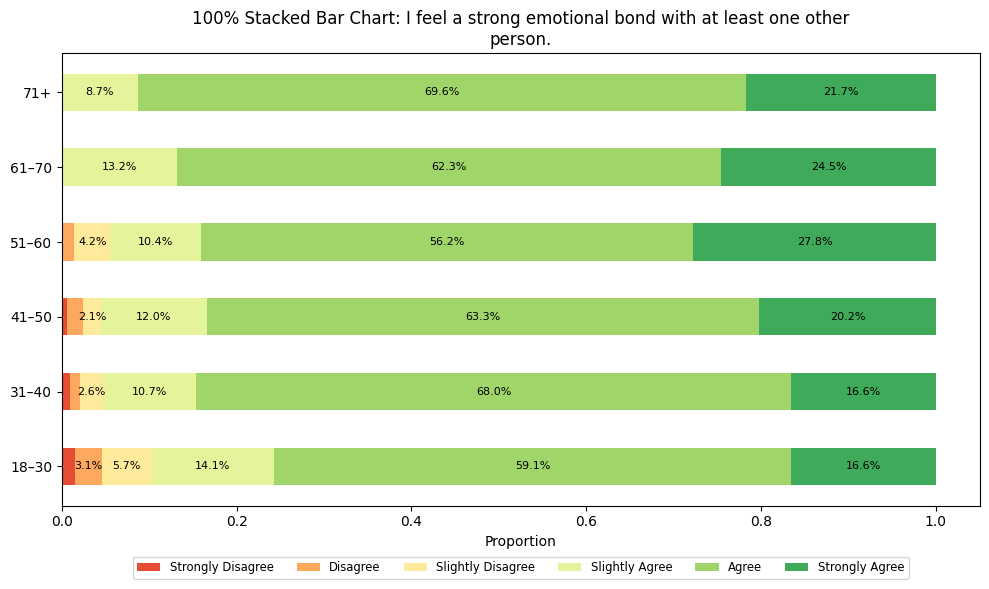

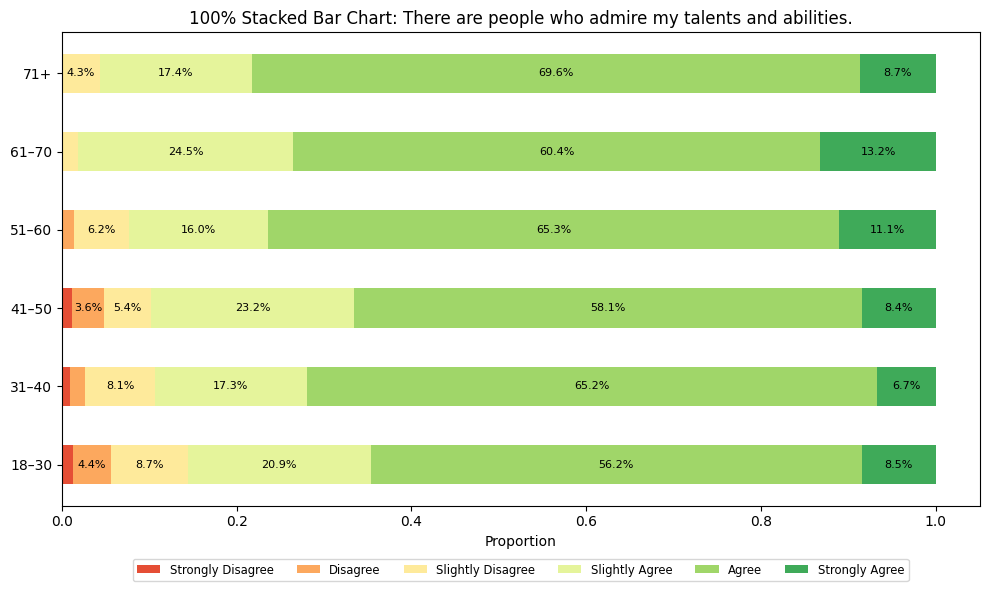

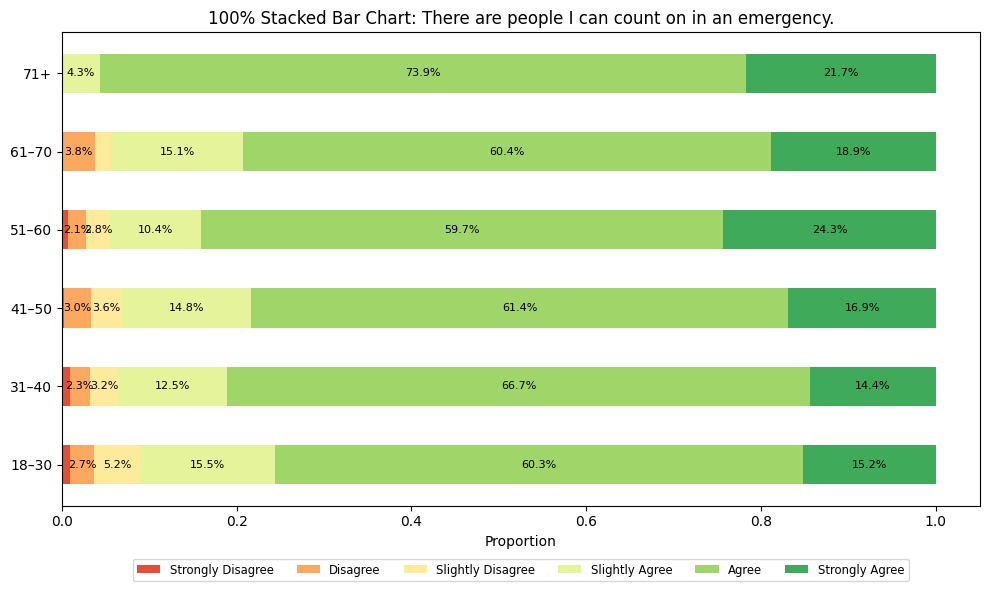

In [109]:
# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "There are people I can depend on to help me if I really need it.",
    "There are people who enjoy the same social activities I do.",
    "I feel part of a group of people who share my attitudes and beliefs.",
    "I have close relationships that provide me with a sense of emotional security and well-being.",
    "There is someone I could talk to about important decisions in my life.",
    "I have relationships where my competence and skills are recognized.",
    "There is a trustworthy person I could turn to for advice if I were having problems.",
    "I feel a strong emotional bond with at least one other person.",
    "There are people who admire my talents and abilities.",
    "There are people I can count on in an emergency."
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 1%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(SPS.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = SPS.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

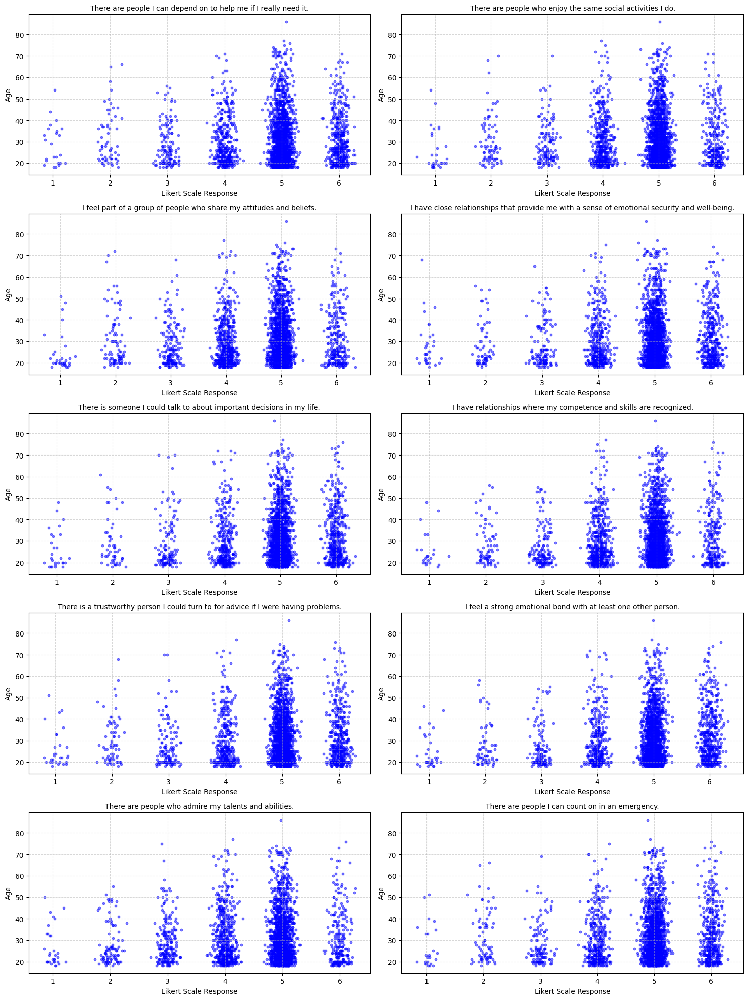

In [110]:
# Membuat Scatter plots with jittering
plt.figure(figsize=(15, 20))

for i, column in enumerate(SPS.columns):
    plt.subplot(5, 2, i + 1)

    x = SPS[column] + np.random.normal(0, 0.1, size=SPS.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(labels[i], fontsize=10)
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 7))  # Likert scale ranges from 1 to 6
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## Coping

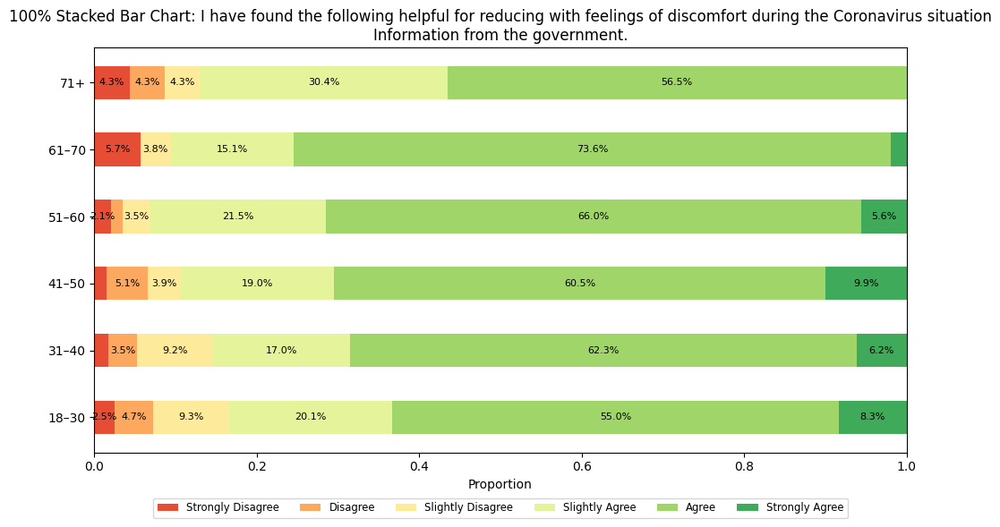

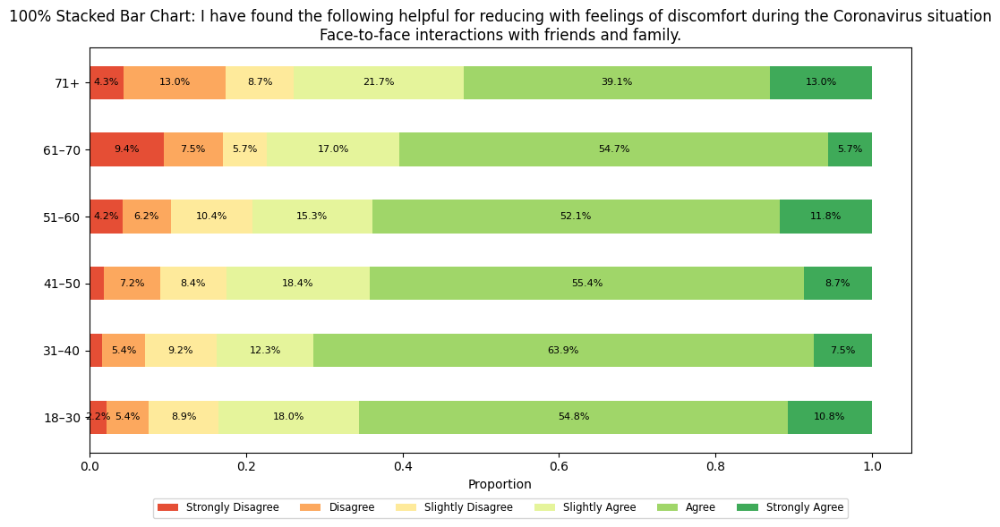

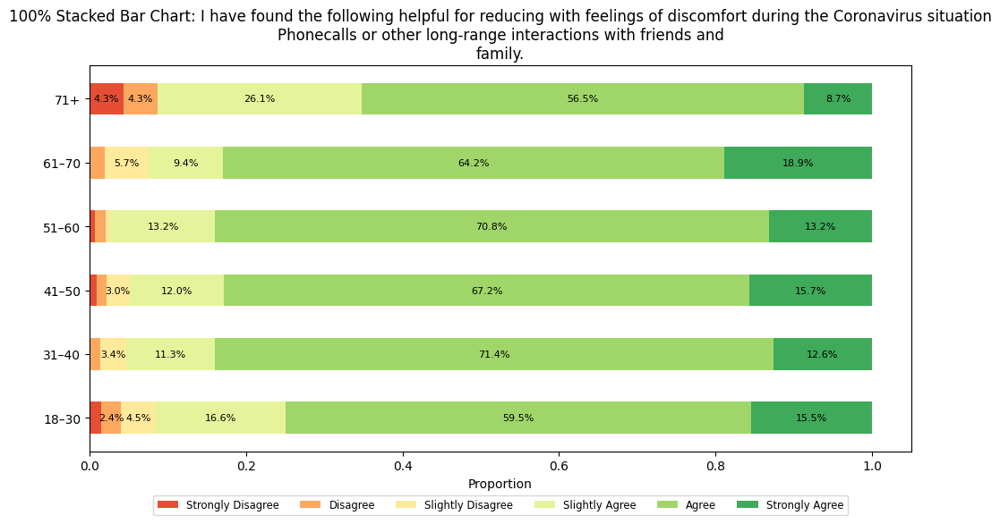

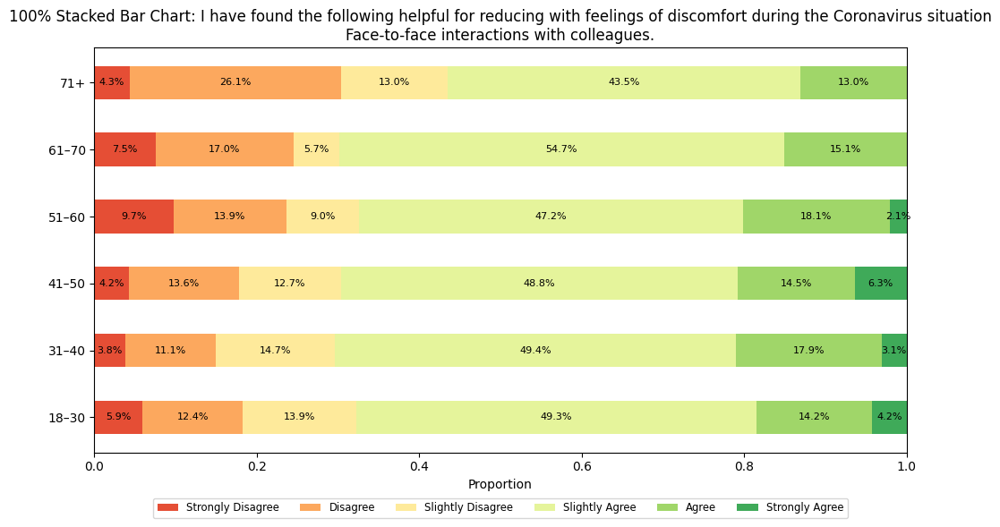

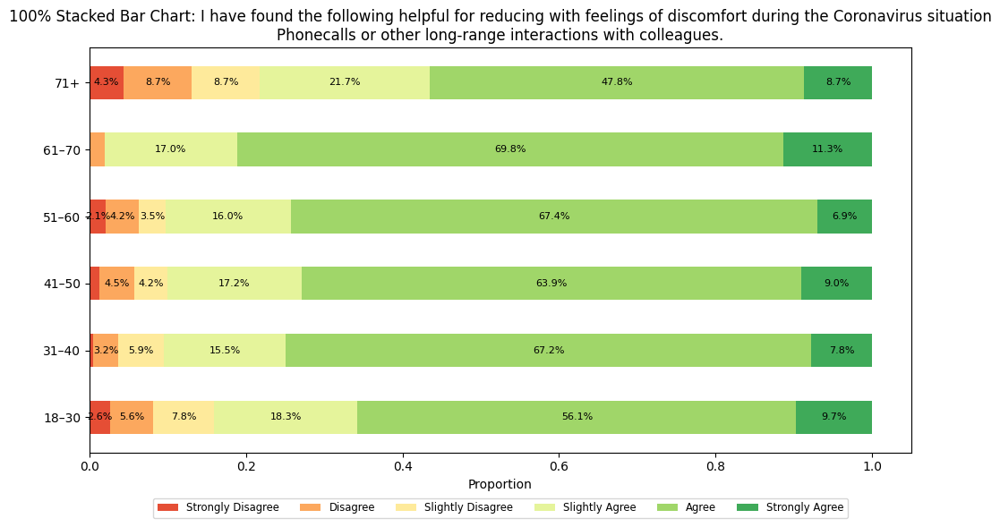

...

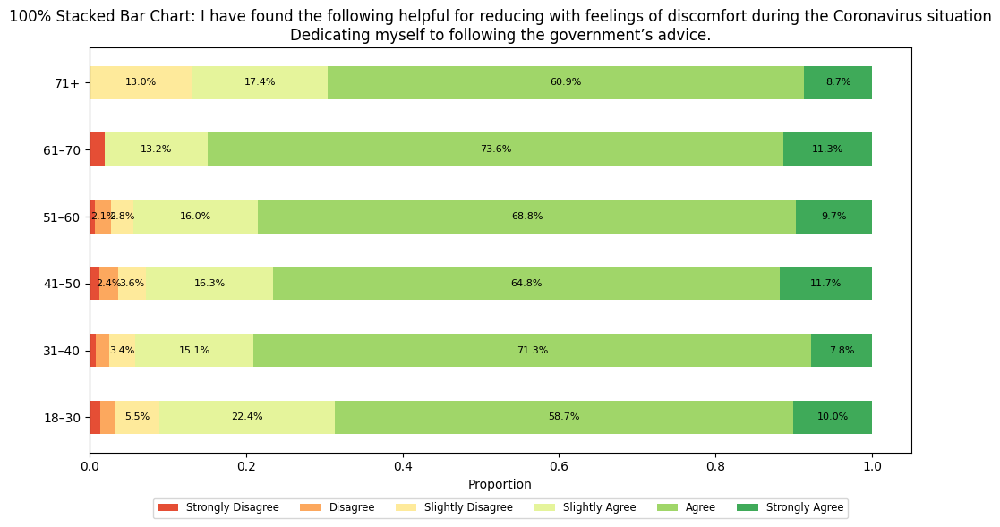

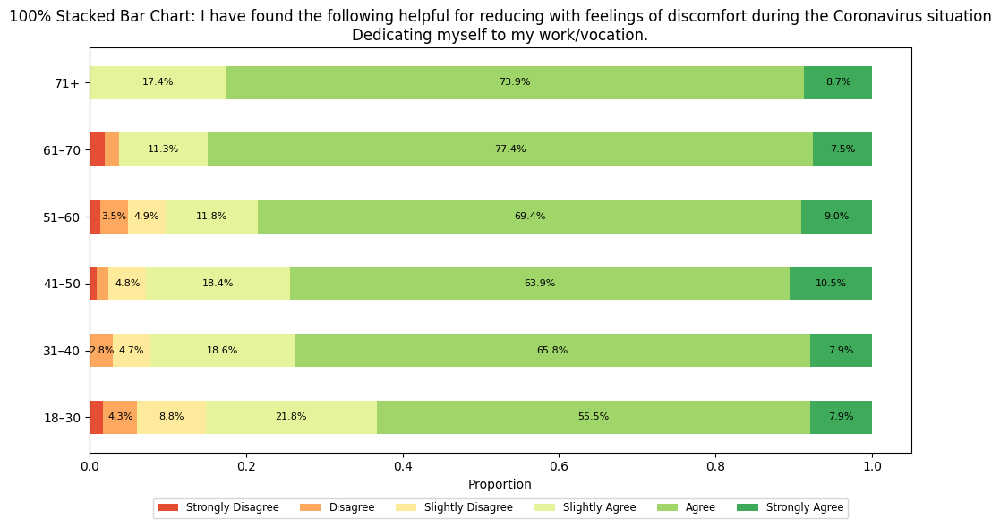

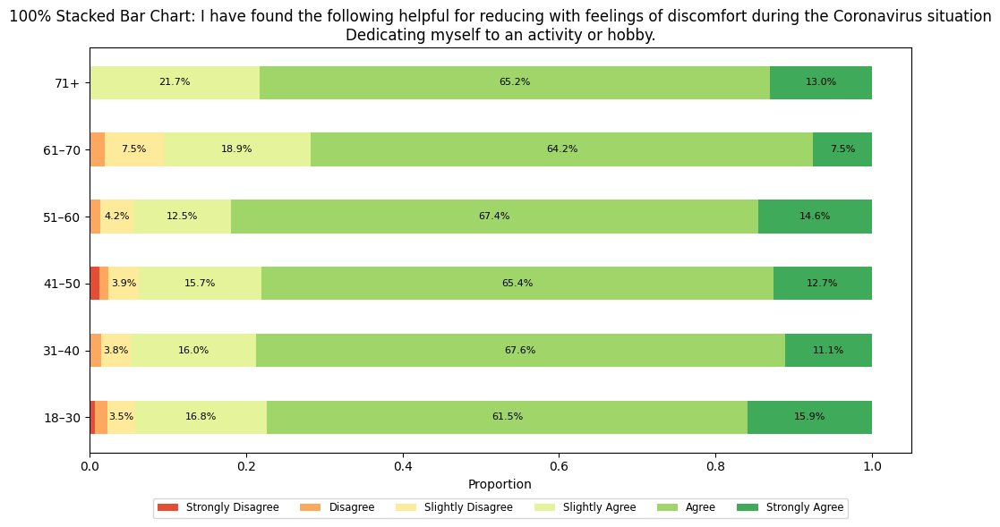

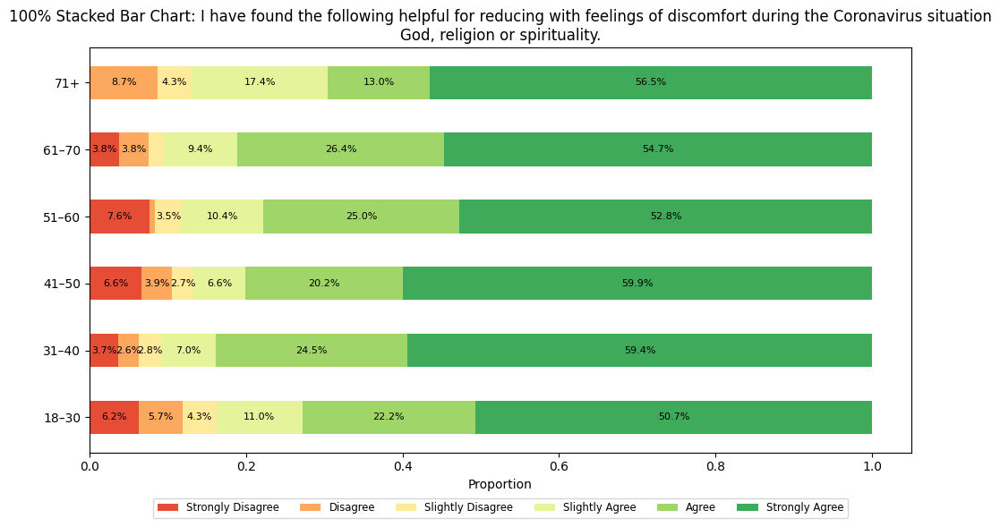

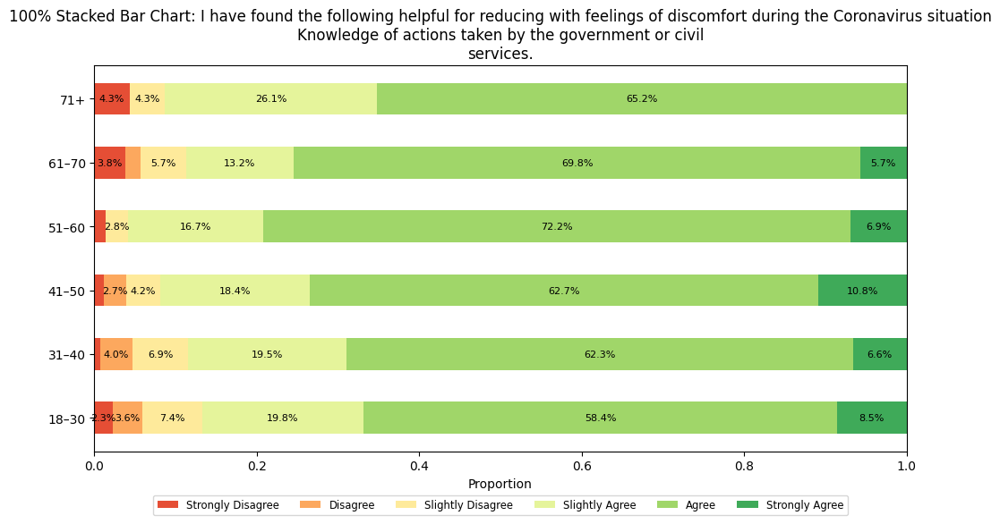

In [111]:
# Nama kategori (skala Likert)
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "Information from the government.",
    "Face-to-face interactions with friends and family.",
    "Phonecalls or other long-range interactions with friends and family.",
    "Face-to-face interactions with colleagues.",
    "Phonecalls or other long-range interactions with colleagues.",
    "Social media.",
    "Video games (alone).",
    "Video games (online).",
    "Watching tv-shows or movies.",
    "Dedicating myself to helping others.",
    "Dedicating myself to preparing for the crisis.",
    "Dedicating myself to following the government’s advice.",
    "Dedicating myself to my work/vocation.",
    "Dedicating myself to an activity or hobby.",
    "God, religion or spirituality.",
    "Knowledge of actions taken by the government or civil services."
]

# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 1%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: I have found the following helpful for reducing with feelings of discomfort during the Coronavirus situation\n{question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(coping.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = coping.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

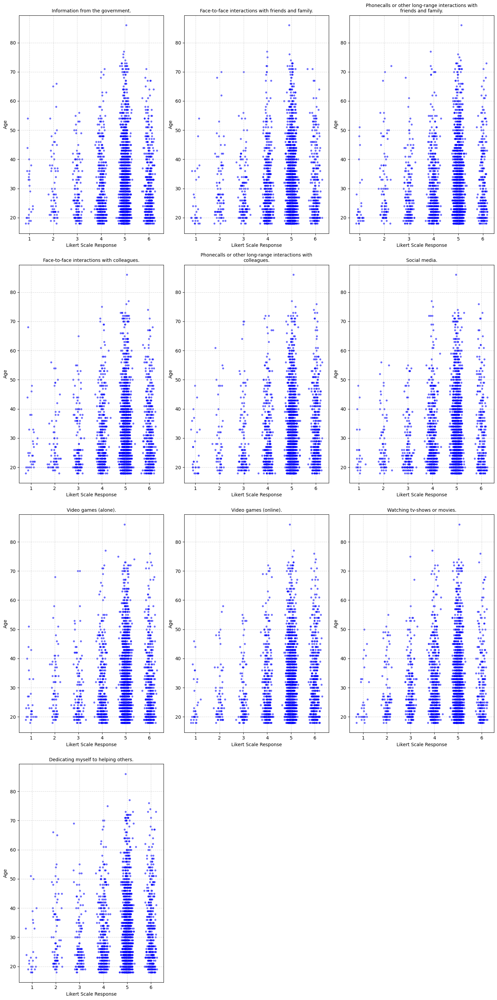

In [112]:
# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Membuat Scatter plots with jittering
plt.figure(figsize=(15, 30))

# Membungkus label pertanyaan agar tidak terlalu panjang
wrapped_labels = wrap_labels(labels, width=50)

# Menghitung jumlah kolom dan baris secara dinamis
num_columns = 3
num_rows = math.ceil(len(SPS.columns) / num_columns)

for i, column in enumerate(SPS.columns):
    plt.subplot(num_rows, num_columns, i + 1)

    x = SPS[column] + np.random.normal(0, 0.1, size=SPS.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(wrapped_labels[i], fontsize=10)  # Menggunakan wrapped label
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 7))  # Likert scale ranges from 1 to 6
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

## Media

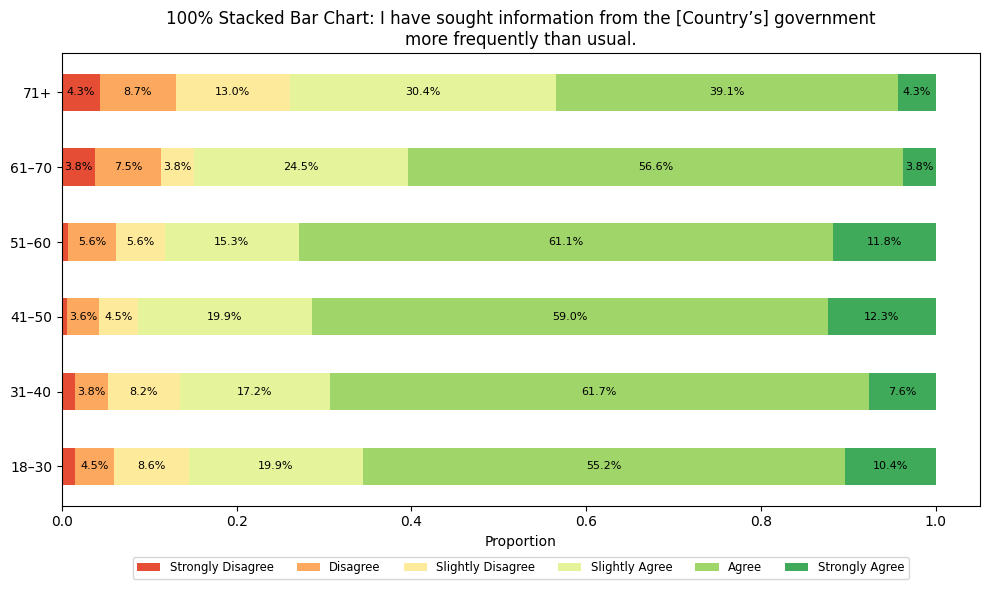

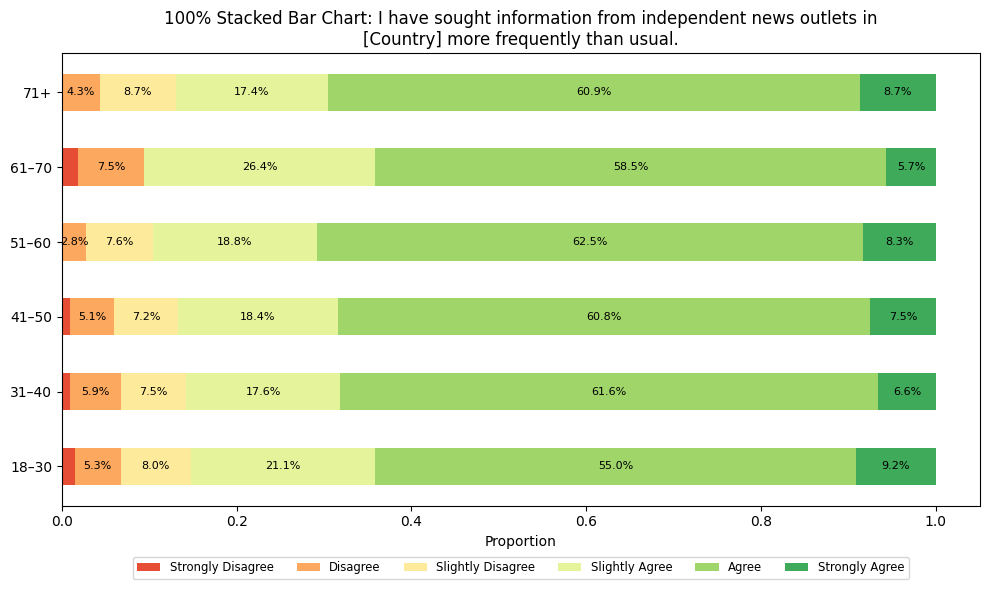

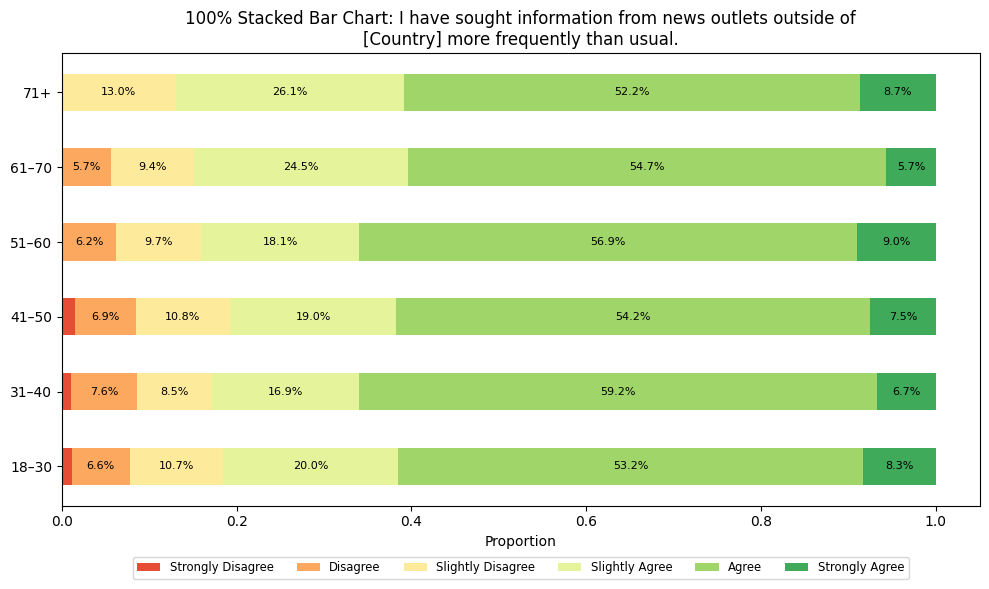

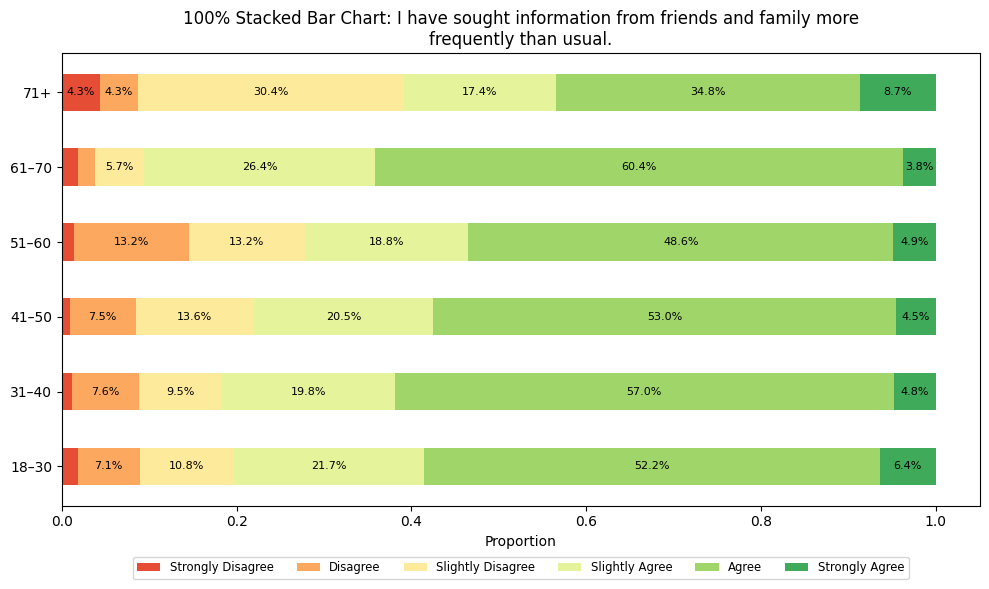

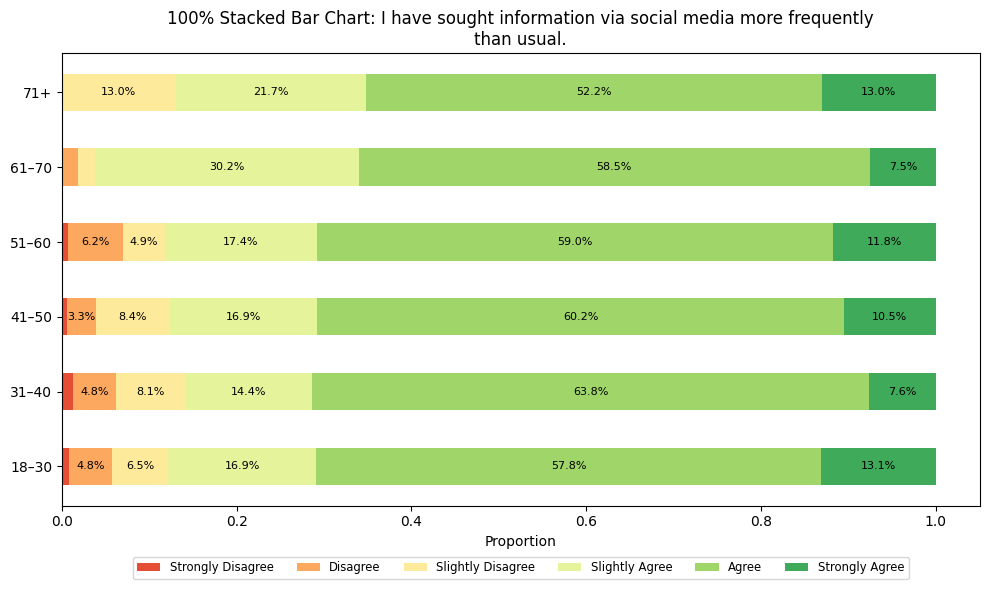

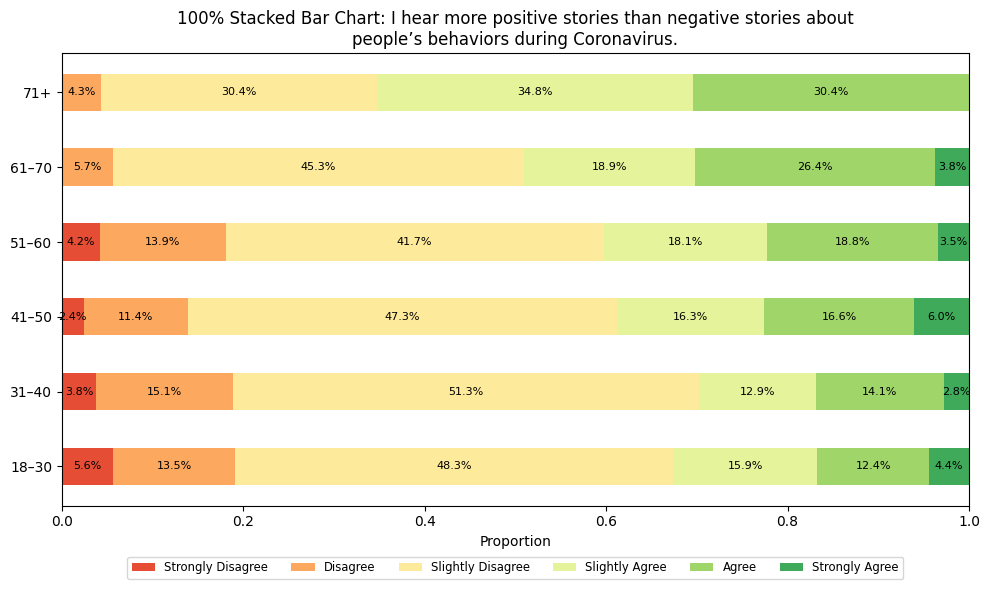

In [113]:
# Keterangan Likert
category_names = [ "Strongly Disagree", "Disagree", "Slightly Disagree", "Slightly Agree", "Agree", "Strongly Agree" ]

# Label pertanyaan
labels = [
    "I have sought information from the [Country’s] government more frequently than usual.",
    "I have sought information from independent news outlets in [Country] more frequently than usual.",
    "I have sought information from news outlets outside of [Country] more frequently than usual.",
    "I have sought information from friends and family more frequently than usual.",
    "I have sought information via social media more frequently than usual.",
    "I hear more positive stories than negative stories about people’s behaviors during Coronavirus."
]


# Urutan kategori umur yang diinginkan
age_order = ['18–30', '31–40', '41–50', '51–60', '61–70', '71+']

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, age_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(age_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 1%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
age_groups = pd.Categorical(Dem_df['Age_Group'], categories=age_order, ordered=True)  # Urutkan kategori umur sesuai dengan age_order

for i, question in enumerate(media.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok umur
    likert_counts_per_age = media.groupby(age_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_age, category_names, age_order, wrapped_label)

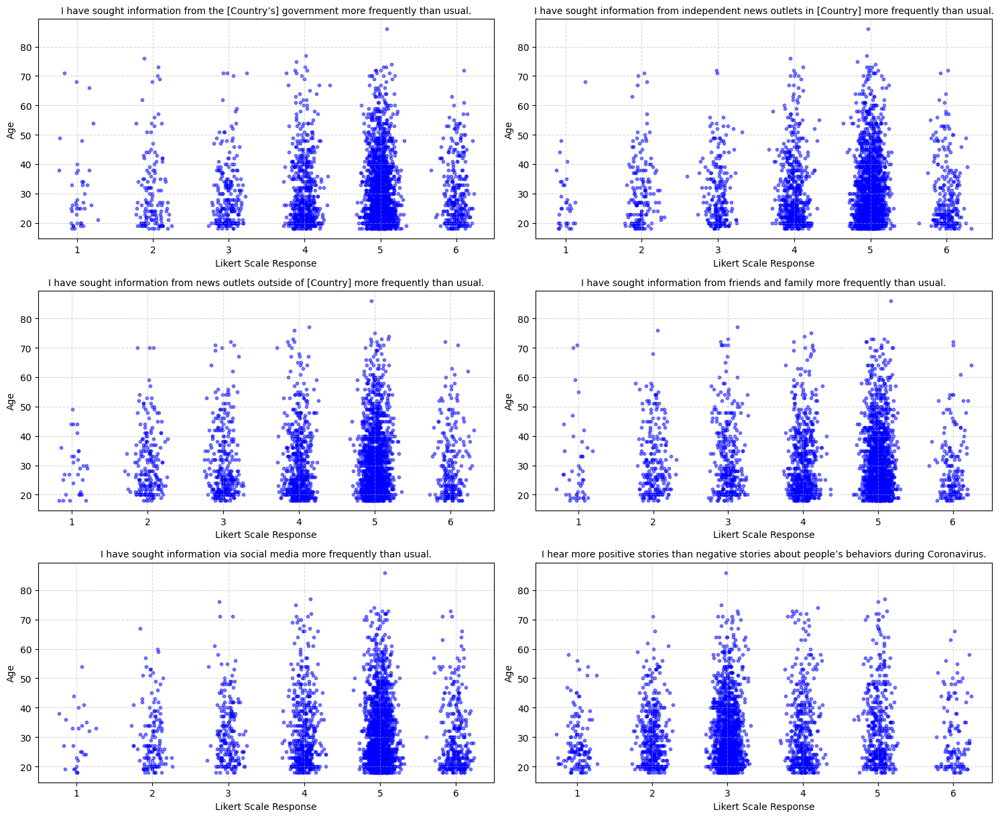

In [114]:
# Membuat Scatter plots with jittering
plt.figure(figsize=(15, 20))

for i, column in enumerate(media.columns):
    plt.subplot(5, 2, i + 1)

    x = media[column] + np.random.normal(0, 0.1, size=media.shape[0])
    y = Dem_df['Dem_age']

    plt.scatter(x, y, alpha=0.5, color='blue', s=10)
    plt.title(labels[i], fontsize=10)
    plt.xlabel('Likert Scale Response')
    plt.ylabel('Age')
    plt.xticks(range(1, 7))  # Likert scale ranges from 1 to 6
    plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

# Marital Status: Visualisasi Stres (PSS10) dan Penyebab Stres (Distress) untuk Setiap Kategori dari Marital Status

## Informasi Marital Status

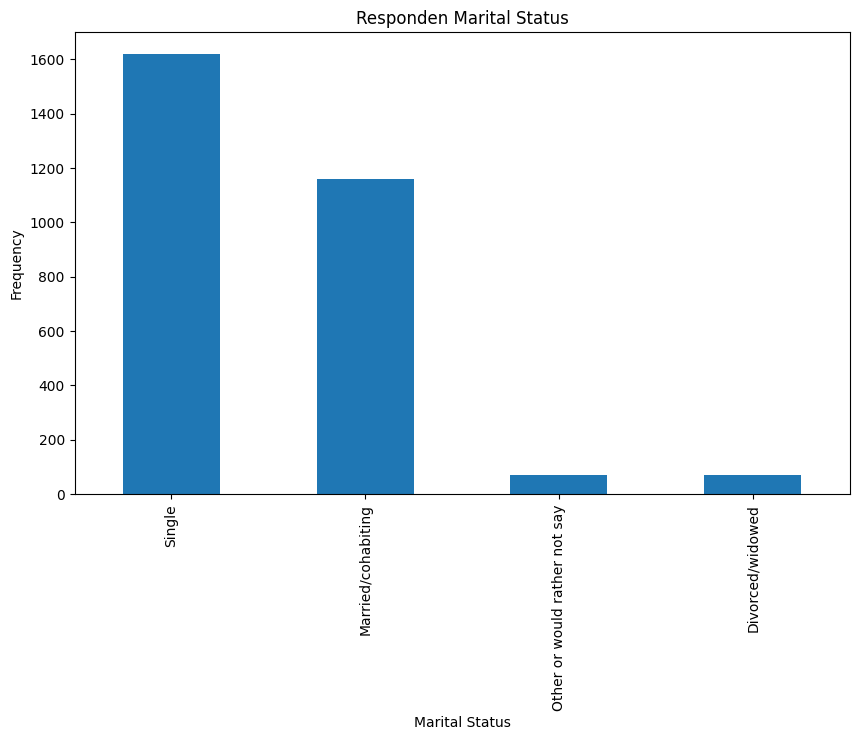

In [115]:
marital = Dem_df['Dem_maritalstatus'].value_counts()

plt.figure(figsize=(10, 6))
marital.plot(kind = 'bar')

plt.xlabel('Marital Status')
plt.ylabel('Frequency')
plt.title('Responden Marital Status')
plt.show()

In [116]:
marital

,count
Dem_maritalstatus,
Single,1618
Married/cohabiting,1160
Other or would rather not say,72
Divorced/widowed,71


## Visualisasi Marital Status dan PSS10

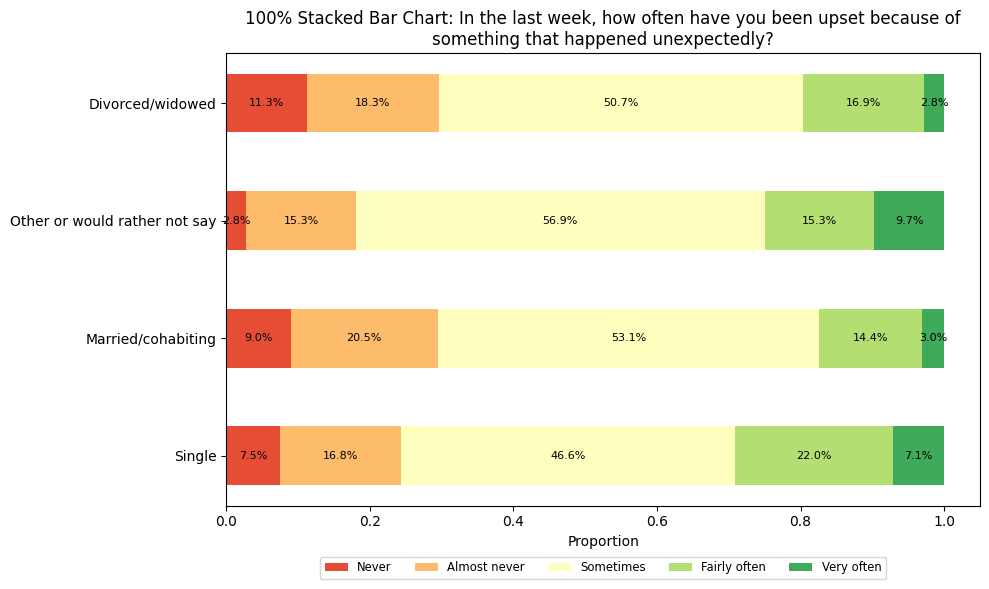

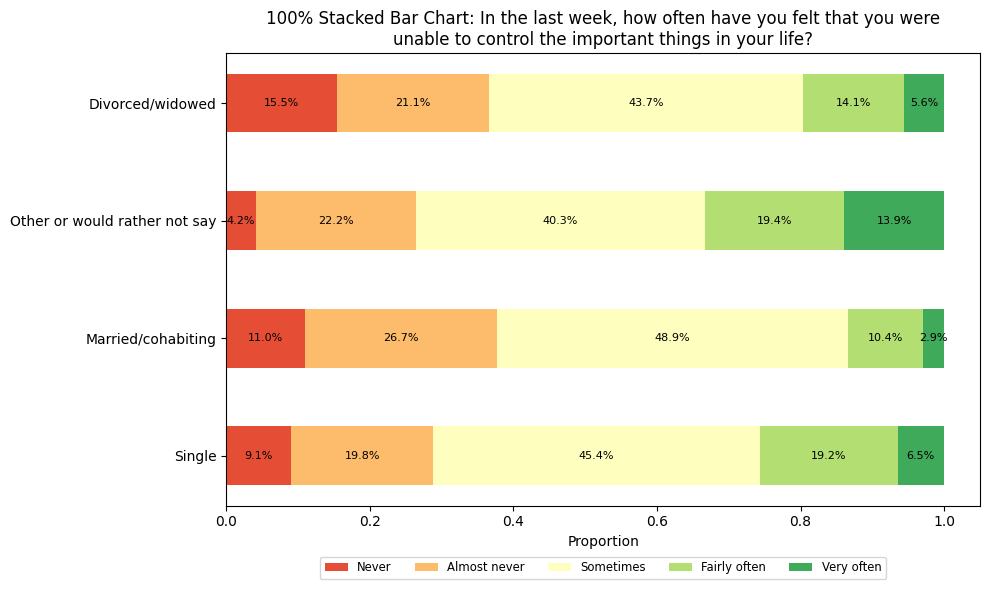

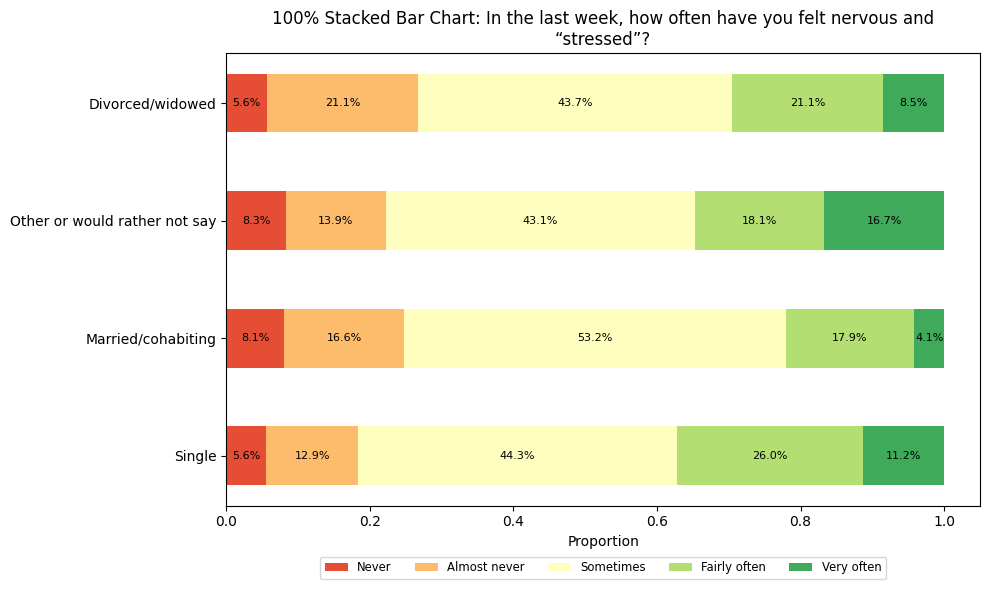

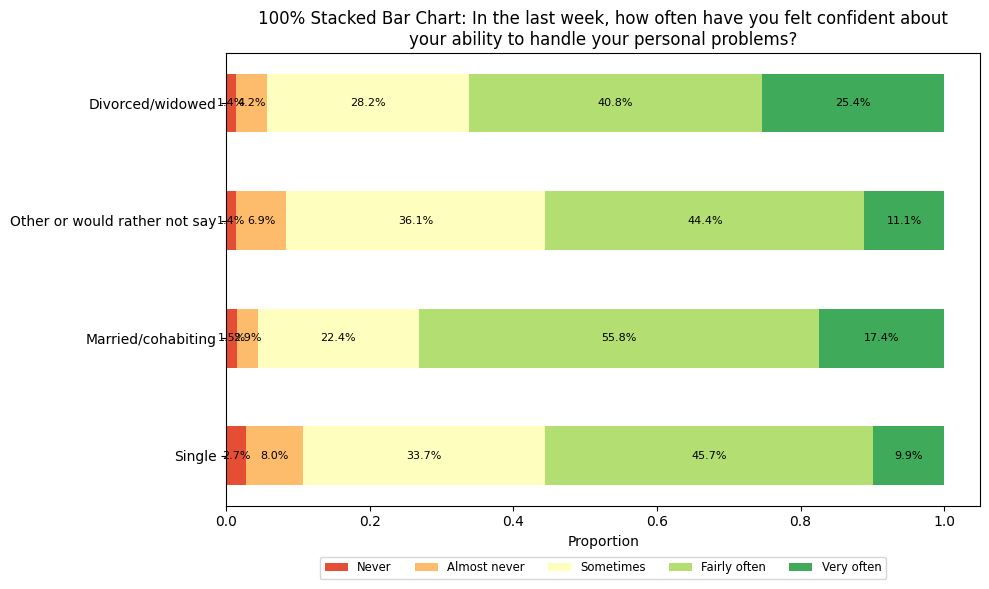

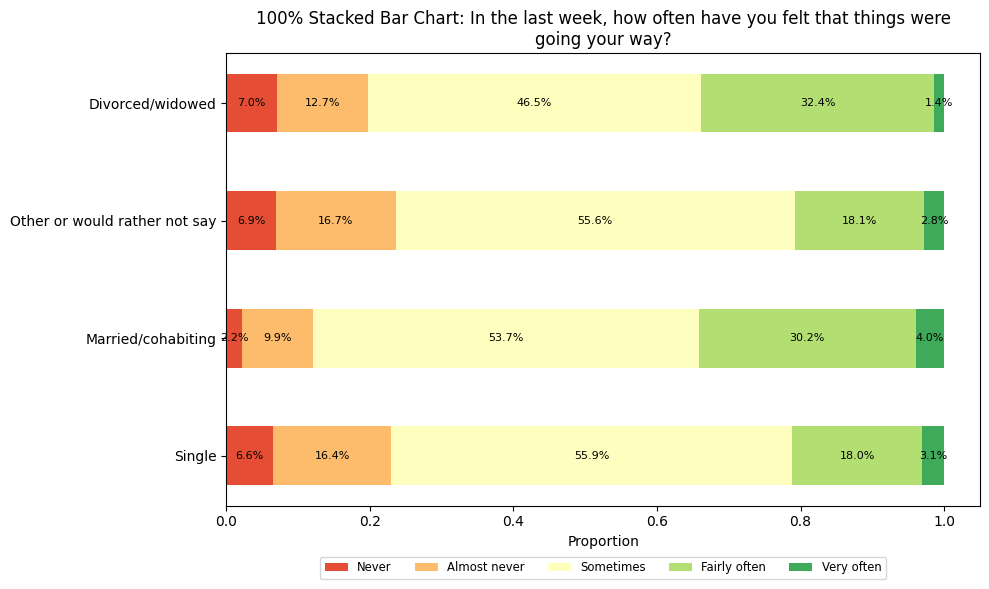

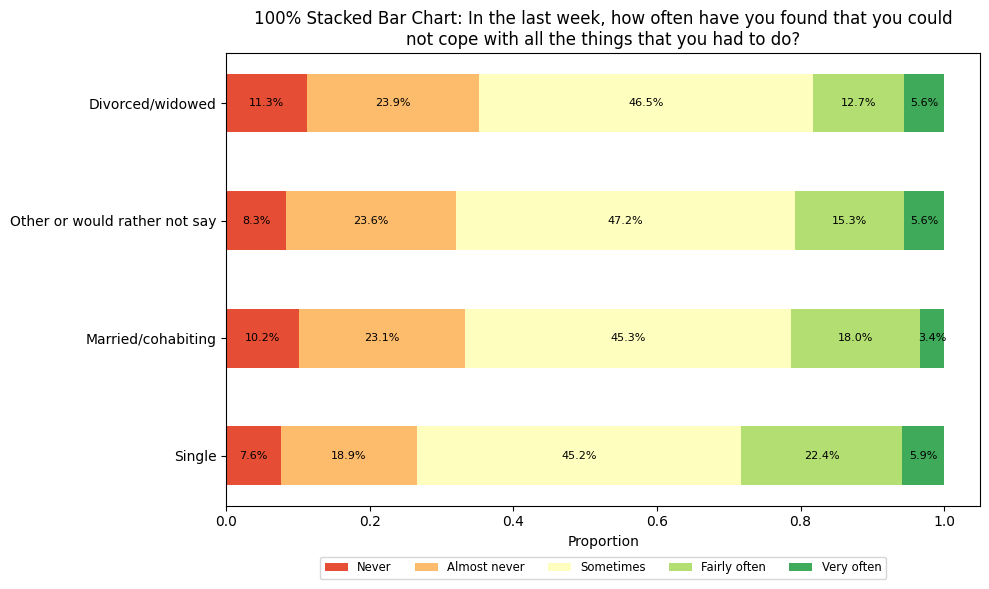

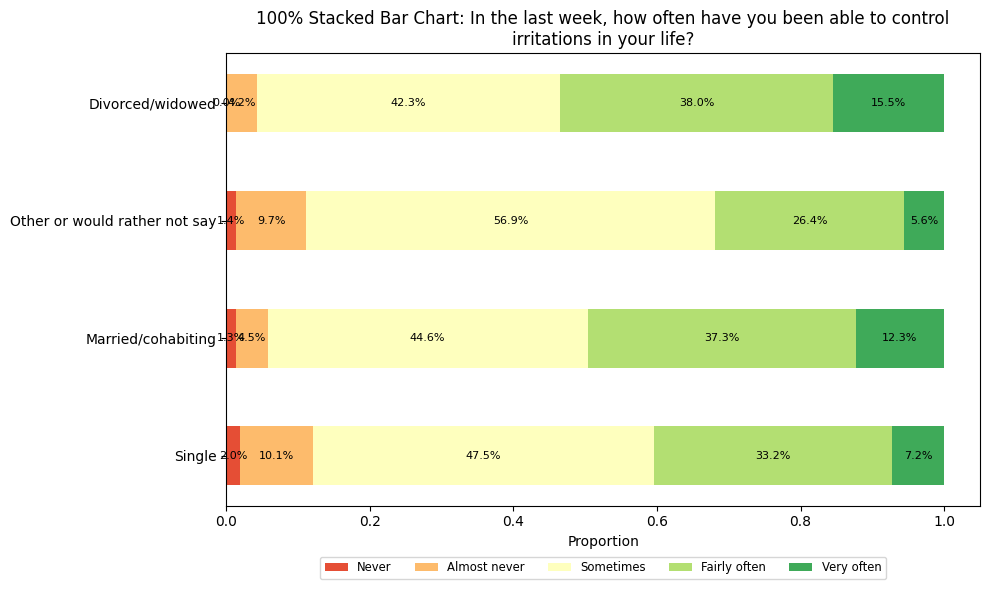

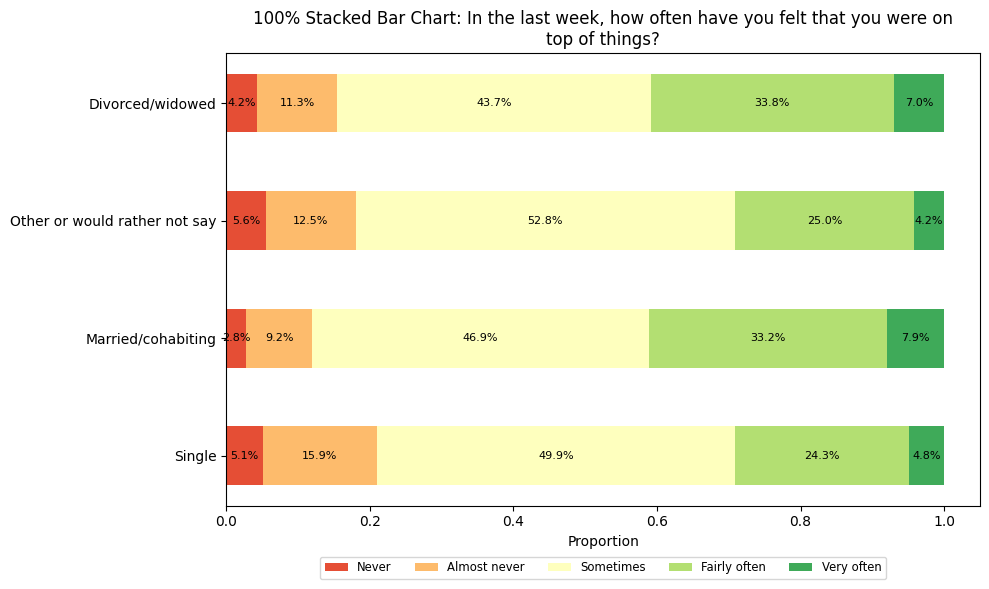

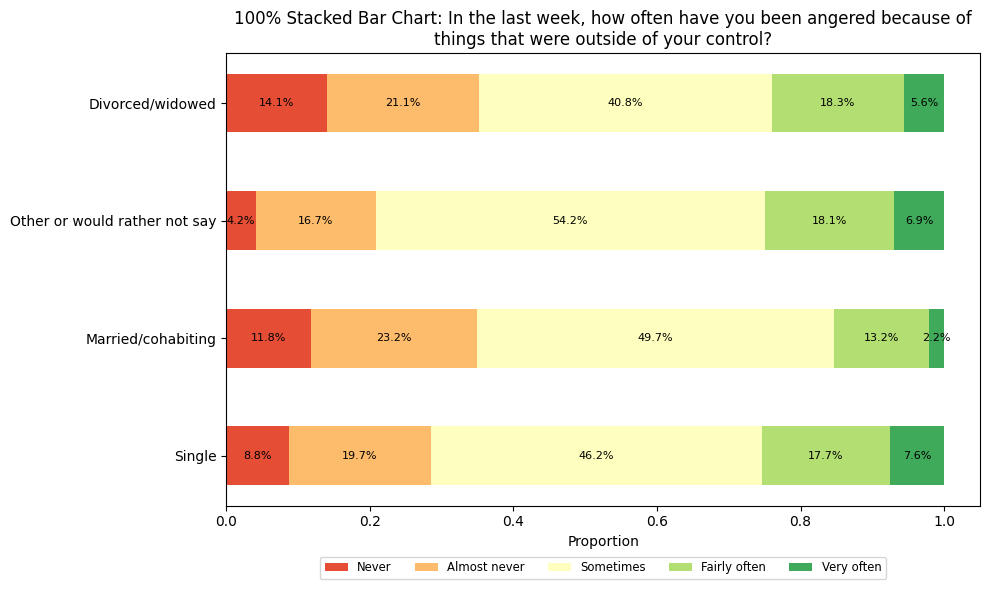

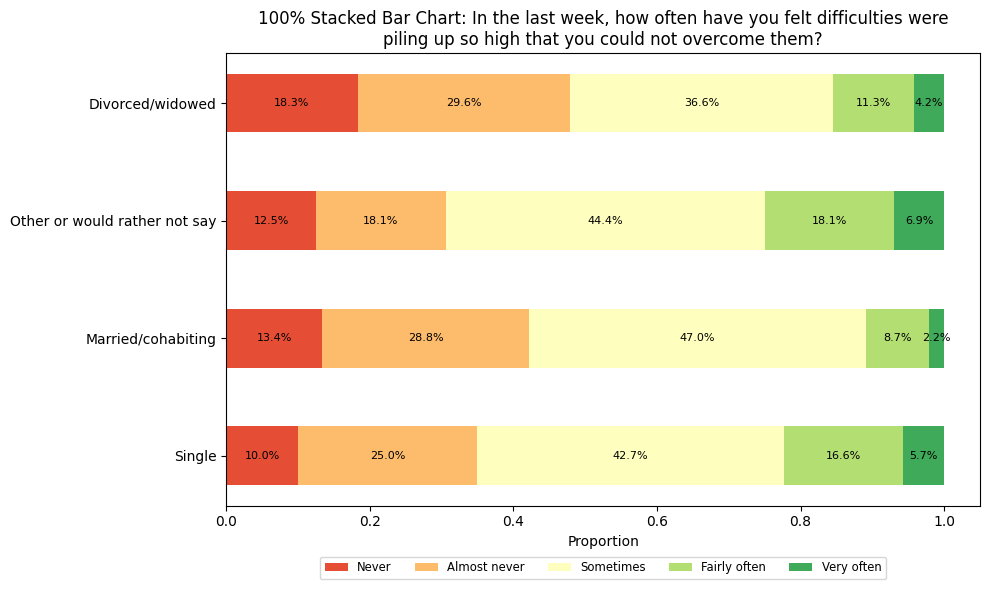

In [117]:
# Keterangan marital status
marital_status_names = ['Single', 'Married/cohabiting', 'Other or would rather not say', 'Divorced/widowed']

# Keterangan Likert
category_names = ['Never', 'Almost never', 'Sometimes', 'Fairly often', 'Very often']

# Pertanyaan survey
labels = [
    "In the last week, how often have you been upset because of something that happened unexpectedly?",
    "In the last week, how often have you felt that you were unable to control the important things in your life?",
    "In the last week, how often have you felt nervous and “stressed”?",
    "In the last week, how often have you felt confident about your ability to handle your personal problems?",
    "In the last week, how often have you felt that things were going your way?",
    "In the last week, how often have you found that you could not cope with all the things that you had to do?",
    "In the last week, how often have you been able to control irritations in your life?",
    "In the last week, how often have you felt that you were on top of things?",
    "In the last week, how often have you been angered because of things that were outside of your control?",
    "In the last week, how often have you felt difficulties were piling up so high that you could not overcome them?"
]

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, marital_status_names, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(marital_status_names, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar
        for y, (start, width) in enumerate(zip(starts, widths)):
            ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                    va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: {question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
marital_status_order = pd.Categorical(Dem_df['Dem_maritalstatus'], categories=marital_status_names, ordered=True)  # Urutkan kategori marital status sesuai dengan marital_status_names

for i, question in enumerate(PSS10.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok marital status
    likert_counts_per_marital_status = PSS10.groupby(marital_status_order, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_marital_status, category_names, marital_status_names, wrapped_label)

## Visualisasi Marital Status dan Distress

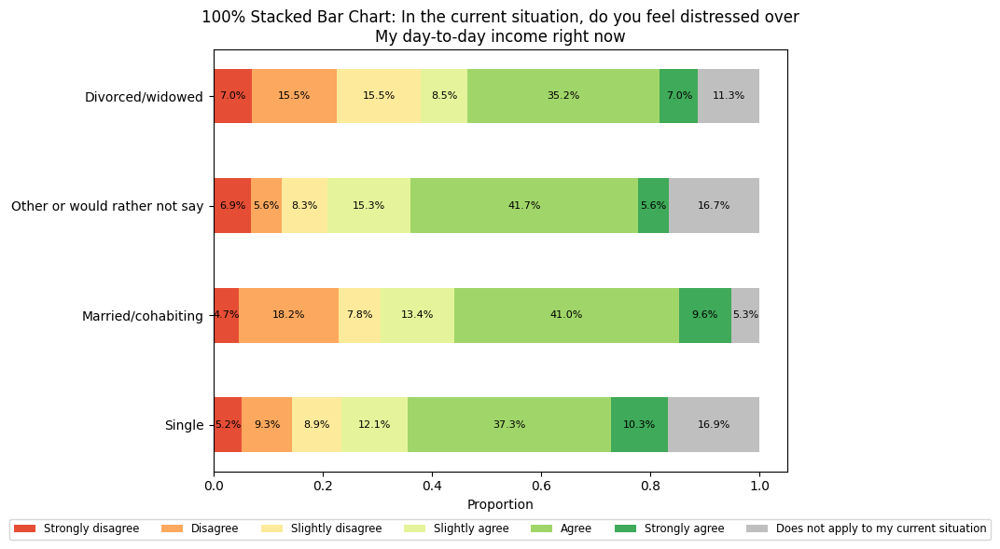

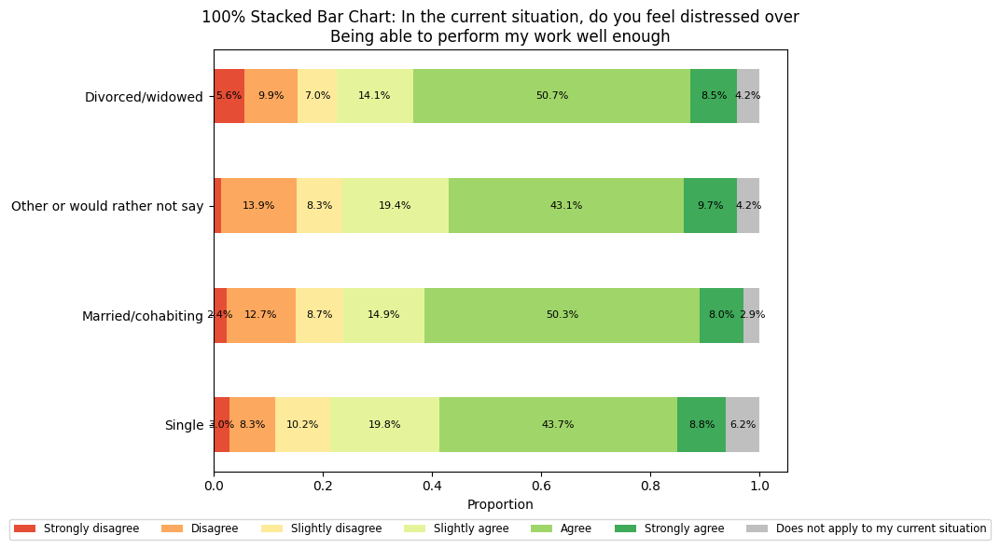

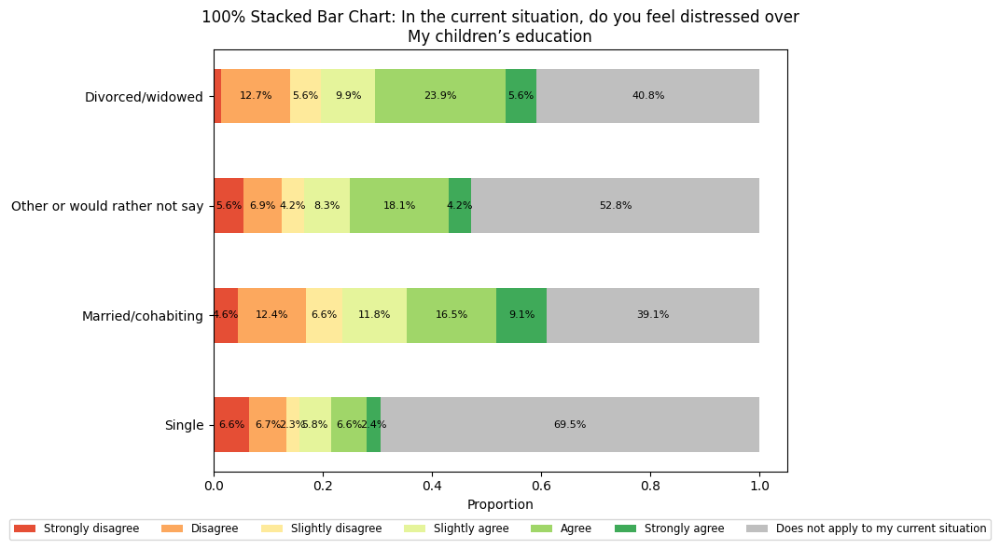

In [ ]:
# Keterangan marital status
marital_status_names = ['Single', 'Married/cohabiting', 'Other or would rather not say', 'Divorced/widowed']

# Keterangan Likert
category_names = ["Strongly disagree",
    "Disagree",
    "Slightly disagree",
    "Slightly agree",
    "Agree",
    "Strongly agree",
    "Does not apply to my current situation"]

# Pertanyaan survey
labels = [
    "My day-to-day income right now",
    "Being able to perform my work well enough",
    "My children’s education",
    "Future job prospects",
    "Access to everyday necessities like food and other grocery items",
    "Not being able to take part in social activities and occasions",
    "Not being able to take part in religious activities",
    "Coping with the behavior of adults who I am in isolation with",
    "Coping with the behavior of children under 12 who I am in isolation with",
    "The national economy",
    "Civil services like police, sanitation, etc.",
    "The risk of myself or others I know catching Coronavirus",
    "The risk of myself or others I know getting hospitalized or dying from Coronavirus",
    "Worry over friends or relatives, who live far away",
    "Having to adapt my work to digital platforms",
    "Having to adapt my social life to digital platforms",
    "Feeling ashamed acting differently towards other people (e.g. at work, if out shopping)",
    "Loneliness",
    "How much time I spend inside",
    "How much time I spend in close proximity with others",
    "Not knowing about developments related to Coronavirus",
    "Not knowing what I should do to limit the spread of Coronavirus",
    "Not knowing about how long measures like social distancing or closed shops/schools/restaurants will be in effect",
    "Not being able to travel outside [Country]"
]

# Fungsi agar teks tidak terlalu panjang
def wrap_labels(labels, width=50):
    return [textwrap.fill(label, width) for label in labels]

# Fungsi untuk membuat stacked bar chart untuk setiap pertanyaan
def plot_stacked_bar(data, category_names, marital_status_groups, question_label):
    data = np.array(data)
    data_cum = data.cumsum(axis=1)

    # Buat warna untuk kategori lainnya dengan skema warna RdYlGn
    category_colors = plt.get_cmap('RdYlGn')(np.linspace(0.15, 0.85, len(category_names) - 1))

    # Tambahkan warna netral (abu-abu) untuk kategori "Does not apply to my current situation"
    neutral_color = np.array([[0.75, 0.75, 0.75, 1.0]])  # Warna abu-abu (R, G, B, Alpha)
    category_colors = np.vstack([category_colors, neutral_color])

    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot setiap kategori Likert sebagai bar tersusun
    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        ax.barh(marital_status_groups, widths, left=starts, height=0.5, label=colname, color=color)

        # Tambahkan persentase pada setiap bar jika >= 2%
        for y, (start, width) in enumerate(zip(starts, widths)):
            if width * 100 >= 2:  # Hanya tampilkan jika >= 2%
                ax.text(start + width / 2, y, f'{width * 100:.1f}%',
                        va='center', ha='center', color='black', fontsize=8)

    # Label dan setelan
    ax.set_xlabel('Proportion')
    ax.set_title(f'100% Stacked Bar Chart: In the current situation, do you feel distressed over\n{question_label}')
    ax.legend(ncol=len(category_names), bbox_to_anchor=(0.5, -0.1), loc='upper center', fontsize='small')

    plt.tight_layout()
    plt.show()

# Plot untuk setiap pertanyaan
marital_status_groups = pd.Categorical(Dem_df['Dem_maritalstatus'], categories=marital_status_names, ordered=True)

for i, question in enumerate(distress.columns):
    # Hitung proporsi untuk setiap jawaban Likert dalam pertanyaan ini per kelompok marital status
    likert_counts_per_marital_status = distress.groupby(marital_status_groups, observed=False)[question].value_counts(normalize=True).unstack().reindex(columns=[1, 2, 3, 4, 5, 6, 7]).fillna(0)

    # Wrapped pertanyaan survey
    wrapped_label = wrap_labels([labels[i]], width=60)[0]

    # Panggil fungsi untuk membuat plot untuk pertanyaan ini
    plot_stacked_bar(likert_counts_per_marital_status, category_names, marital_status_names, wrapped_label)